# **GNN_Energy.ipynb: Energy prediction for EIC Det2 KLM**
This notebook walks through the steps of loading data, training and testing a GNN for energy prediction tasks

In [1]:
# import matplotlib.pyplot as plot
import pandas as pd
import os
os.environ["DGLBACKEND"] = "pytorch"
import dgl
import torch
from dgl.data import DGLDataset
import matplotlib.pyplot as plot
import numpy as np
import torch.nn as nn
import torch
import itertools
import dgl.data
import torch.nn.functional as F
from dgl.dataloading import GraphDataLoader
from tqdm import tqdm
import matplotlib.pyplot as plot
from datetime import datetime as datetime
current_date = datetime.now().strftime("%B_%d")
from torch.utils.data.sampler import SubsetRandomSampler
from GNN_util import process_df_vectorized,create_directory,HitDataset,create_fast_edge_lists,visualize_detector_graph,GIN,train_GNN,test_GNN,calculate_bin_rmse

/hpc/group/vossenlab/rck32/ML_venv/lib64/python3.9/site-packages/networkx/utils/backends.py:135: RuntimeWarning: networkx backend defined more than once: nx-loopback
  backends.update(_get_backends("networkx.backends"))


## **Load in Data**
The data is stored as pandas dataframes where each row is a hit in the detector

In [2]:
num_dfs = 1700
dfs = []
for i in range(num_dfs):
    try:
#         new_df = pd.read_csv(f"/hpc/group/vossenlab/rck32/eic/work_eic/macros/Timing_estimation/data/df/Feb_5_50events_run_4_{i}.csv")
        new_df = pd.read_csv(f"/hpc/group/vossenlab/rck32/eic/work_eic/macros/Timing_estimation/data/df/jan_18_50events_{i}.csv")
    except FileNotFoundError as e:
        # Skip files that failed for some reason...
        # I think these files fail due to DCC issues?
        print(f"skipping file #{i}...")
        continue
    new_df["file_idx"] = i
    dfs.append(new_df)
data = pd.concat(dfs)

skipping file #110...
skipping file #128...
skipping file #238...
skipping file #403...
skipping file #469...
skipping file #505...
skipping file #535...
skipping file #561...
skipping file #590...
skipping file #601...
skipping file #648...
skipping file #684...
skipping file #685...
skipping file #748...
skipping file #760...
skipping file #774...
skipping file #776...
skipping file #786...
skipping file #840...
skipping file #872...
skipping file #894...
skipping file #928...
skipping file #929...
skipping file #963...
skipping file #989...
skipping file #1046...
skipping file #1057...
skipping file #1097...
skipping file #1112...
skipping file #1165...
skipping file #1182...
skipping file #1259...
skipping file #1273...
skipping file #1287...
skipping file #1339...
skipping file #1352...
skipping file #1353...
skipping file #1397...
skipping file #1470...
skipping file #1508...
skipping file #1541...
skipping file #1553...
skipping file #1565...
skipping file #1568...
skipping file

## **Isolate hits in one section of detector**

Because we sometimes get backscattering and other weird detector effects, we want to train the GNN on a cluster of events that are all together, and treat hits that are far away as noise. This implementation allows the user to set how far away the hits can be and still be clustered together

In [3]:
# Plot the data
modified_df = process_df_vectorized(data, cone_angle_deg = 40)

## **Define the dataset class for easy management**

The HitDataset class inherits from the DGLDataset. The required member functions are the init method, process, getitem, and len.

In [15]:
import pandas as pd
import numpy as np
from scipy.spatial import ConvexHull

def engineer_features(df):
    """
    Engineer features from particle detector data for momentum prediction
    
    Parameters:
    df: pandas DataFrame containing the raw detector data
    
    Returns:
    DataFrame with engineered features
    """
    features = []
    
    # Group by event_idx to process each particle event
    for event_id, event_df in df.groupby('event_idx'):
        # Sort hits by time
        event_df = event_df.sort_values('Time')
        
        # Basic features
        total_charge = event_df['Charge'].sum()
        max_charge = event_df['Charge'].max()
        n_hits = len(event_df)
        
        # Timing features
        time_spread = event_df['Time'].max() - event_df['Time'].min()
        mean_time = event_df['Time'].mean()
        
        # Spatial features
        hit_coords = event_df[['hit_x', 'hit_y', 'hit_z']].values
        
        # Center of gravity
        cog_x = np.average(hit_coords[:, 0], weights=event_df['Charge'])
        cog_y = np.average(hit_coords[:, 1], weights=event_df['Charge'])
        cog_z = np.average(hit_coords[:, 2], weights=event_df['Charge'])
        
        # Shower shape features
        if len(hit_coords) >= 4:  # Need at least 4 points for 3D convex hull
            try:
                hull = ConvexHull(hit_coords)
                shower_volume = hull.volume
                shower_area = hull.area
            except:
                shower_volume = 0
                shower_area = 0
        else:
            shower_volume = 0
            shower_area = 0
        
        # Longitudinal profile
        z_sorted = event_df.sort_values('hit_z')
        charge_profile = z_sorted['Charge'].values
        charge_cumsum = np.cumsum(charge_profile)
        shower_depth = np.interp(0.95 * total_charge, charge_cumsum, z_sorted['hit_z'])
        
        # Layer-wise features
        layer_charges = event_df.groupby('layer_idx')['Charge'].sum().values
        if len(layer_charges) > 0:
            max_layer_charge = np.max(layer_charges)
            charge_assymetry = np.std(layer_charges) / np.mean(layer_charges) if np.mean(layer_charges) > 0 else 0
        else:
            max_layer_charge = 0
            charge_assymetry = 0
            
        # Radius of gyration
        r_gyr = np.sqrt(np.average(np.sum((hit_coords - np.array([cog_x, cog_y, cog_z]))**2, axis=1),
                                 weights=event_df['Charge']))
        
        # Feature vector for this event
        event_features = {
            'event_idx': event_id,
            'total_charge': total_charge,
            'max_charge': max_charge,
            'n_hits': n_hits,
            'time_spread': time_spread,
            'mean_time': mean_time,
            'cog_x': cog_x,
            'cog_y': cog_y,
            'cog_z': cog_z,
            'shower_volume': shower_volume,
            'shower_area': shower_area,
            'shower_depth': shower_depth,
            'max_layer_charge': max_layer_charge,
            'charge_assymetry': charge_assymetry,
            'radius_gyration': r_gyr,
            'momentum' : event_df['P'].iloc[0]
        }
        
        features.append(event_features)
    
    return pd.DataFrame(features)

In [16]:
new_feats = engineer_features(modified_df)

In [17]:
new_feats.to_csv("test.csv")

In [19]:
new_feats

,event_idx,total_charge,max_charge,n_hits,time_spread,mean_time,cog_x,cog_y,cog_z,shower_volume,shower_area,shower_depth,max_layer_charge,charge_assymetry,radius_gyration,momentum
0,0,2.701915e+06,5432.223029,202545,18.669438,2.668080,-85.818731,9.555956,105.095289,3.941131e+10,7.800475e+07,746.291315,385187.491401,0.689834,2220.553041,2.664673
1,1,2.671628e+06,6074.198728,199309,18.681424,2.675076,70.223080,64.650898,94.159086,3.943453e+10,7.819140e+07,744.372426,411680.014010,0.731440,2214.534426,1.038929
2,2,2.637020e+06,6938.746977,200164,18.693874,2.633978,-56.835544,-81.178776,106.254333,3.933598e+10,7.766128e+07,739.874436,424338.051742,0.758652,2204.907479,2.828088
3,3,2.610044e+06,8333.045331,203377,18.701130,2.667700,72.408955,-52.369645,84.350997,3.929064e+10,7.772754e+07,744.265771,398105.329893,0.718648,2212.464773,1.713935
4,4,2.663773e+06,8819.555028,205283,18.698596,2.675438,2.655738,45.621120,59.251139,3.943326e+10,7.811959e+07,735.671616,426210.674181,0.747564,2207.385872,1.035911
5,5,2.706393e+06,7140.657628,205400,18.700126,2.694992,37.836439,-59.565165,97.770743,3.938937e+10,7.824292e+07,742.604213,422817.969549,0.716325,2216.503845,1.766992
6,6,2.704714e+06,8449.734919,203866,18.674277,2.673329,-70.809657,-1.577707,100.756419,3.946775e+10,7.829859e+07,747.044085,405536.411221,0.700961,2223.828617,2.892448
7,7,2.633027e+06,5900.829831,204272,18.715299,2.698905,-72.711751,46.057644,40.614284,3.946864e+10,7.838429e+07,731.287254,420706.731970,0.720358,2217.033036,1.600720
8,8,2.623503e+06,4680.385349,201699,18.678207,2.675161,50.426743,-23.748185,67.997626,3.948342e+10,7.831844e+07,736.081831,415562.971848,0.722345,2217.127840,1.358968
9,9,2.620221e+06,6609.550627,204382,18.698402,2.675437,-72.657065,-7.175196,105.660421,3.951454e+10,7.838261e+07,742.384568,400826.521996,0.716716,2210.582281,2.868505


Epoch 0: Train Loss = 5.7347, Val Loss = 5.7068


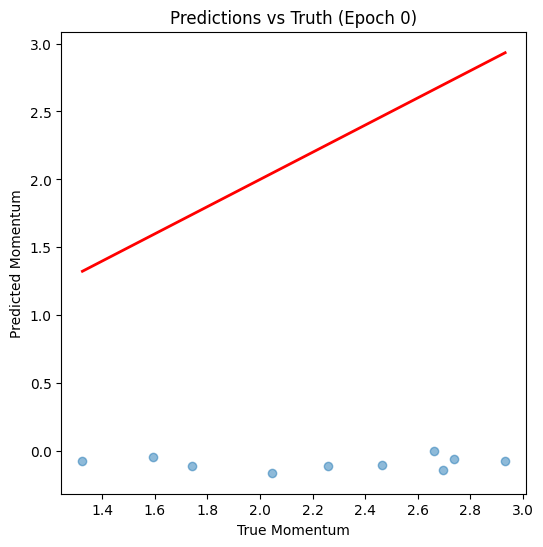

Epoch 10: Train Loss = 4.6711, Val Loss = 4.7140


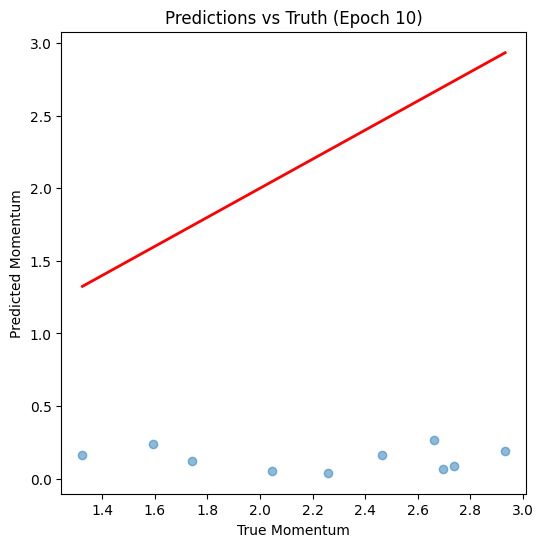

Epoch 20: Train Loss = 3.4975, Val Loss = 3.6789


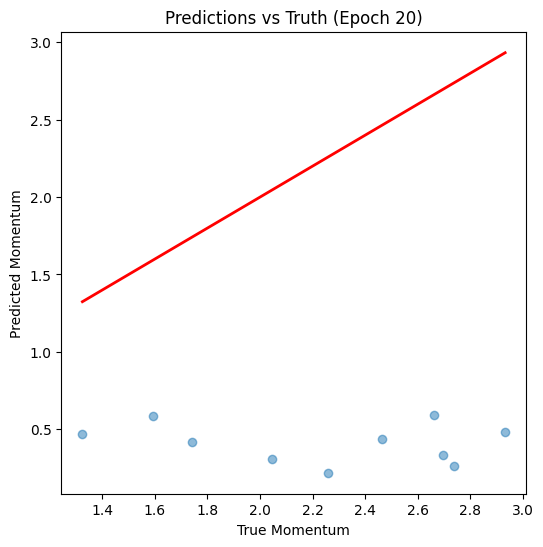

Epoch 30: Train Loss = 2.1656, Val Loss = 2.5284


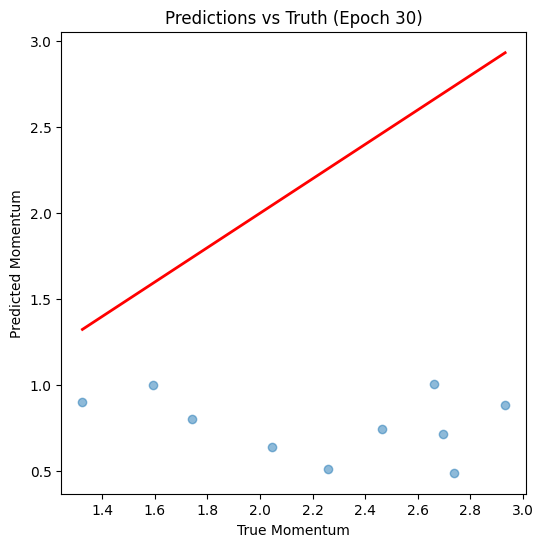

Epoch 40: Train Loss = 0.9586, Val Loss = 1.4463


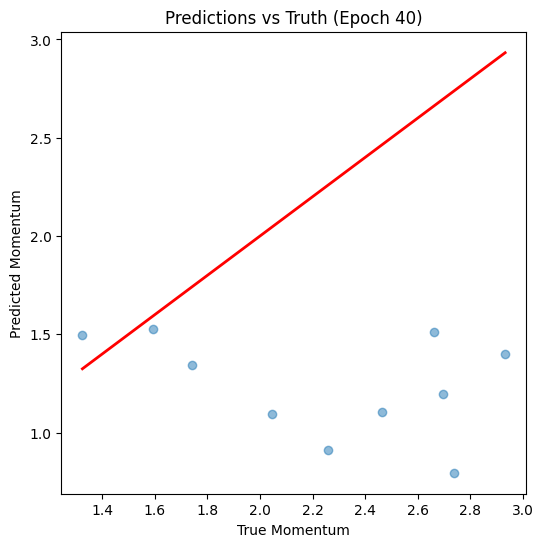

Epoch 50: Train Loss = 0.3696, Val Loss = 0.8398


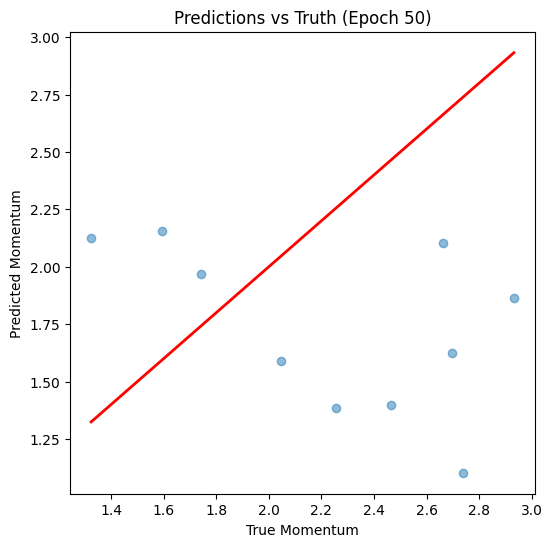

Epoch 60: Train Loss = 0.2940, Val Loss = 0.8267


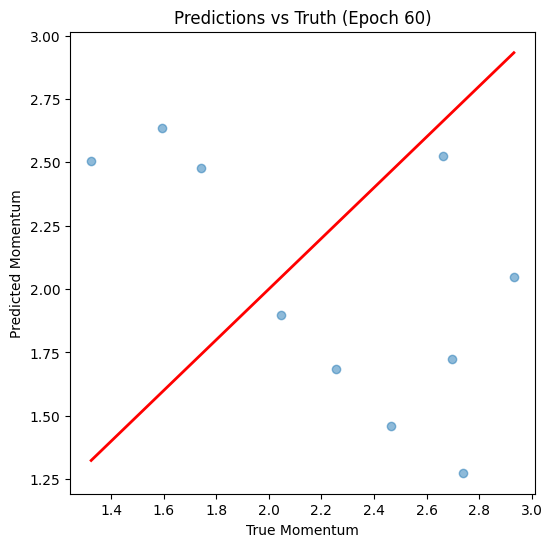

Epoch 70: Train Loss = 0.2068, Val Loss = 1.0002


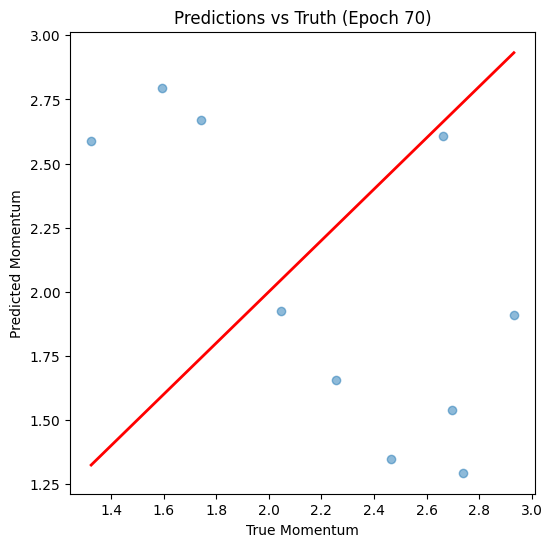

Epoch 80: Train Loss = 0.1529, Val Loss = 1.1528


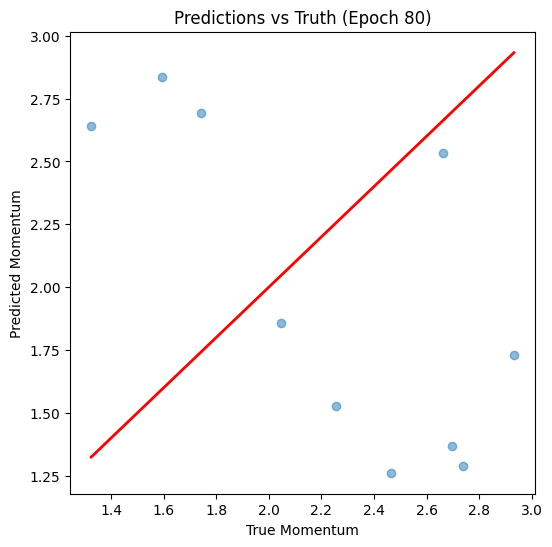

Epoch 90: Train Loss = 0.1274, Val Loss = 1.2562


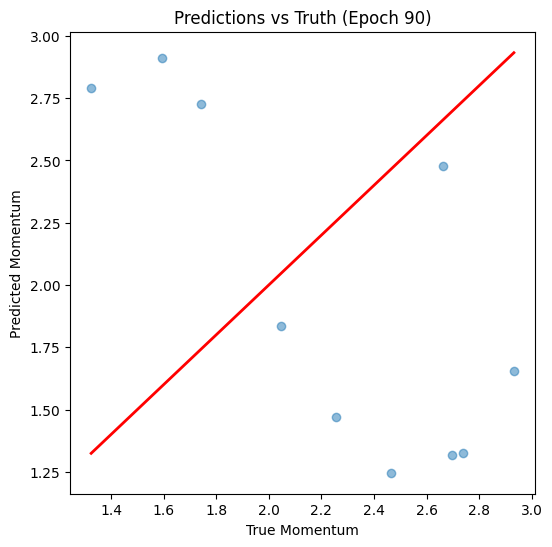

Epoch 0: Train Loss = 0.1068, Val Loss = 1.3257


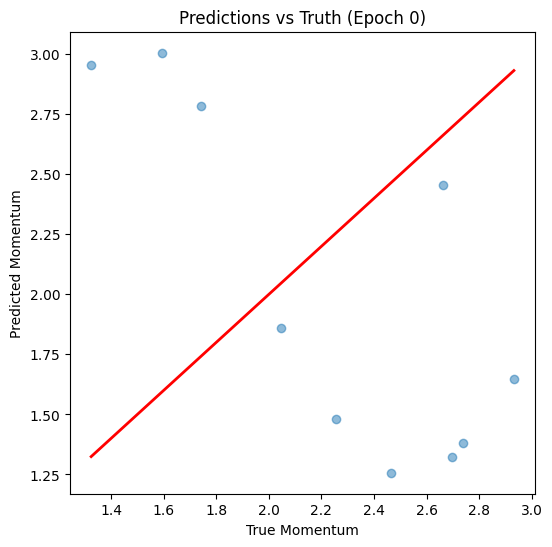

Epoch 10: Train Loss = 0.0931, Val Loss = 1.3737


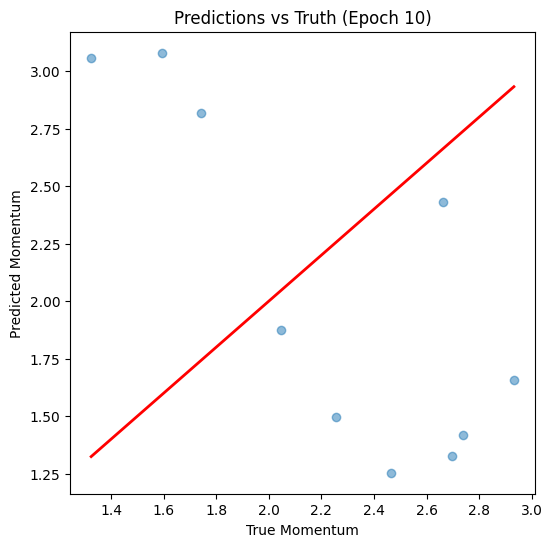

Epoch 20: Train Loss = 0.0821, Val Loss = 1.4073


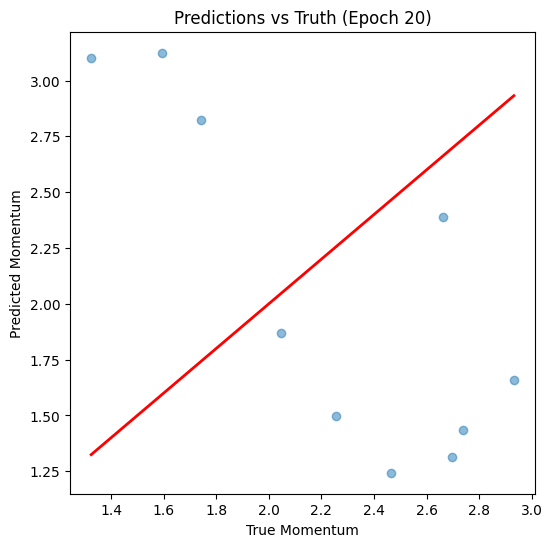

Epoch 30: Train Loss = 0.0731, Val Loss = 1.4359


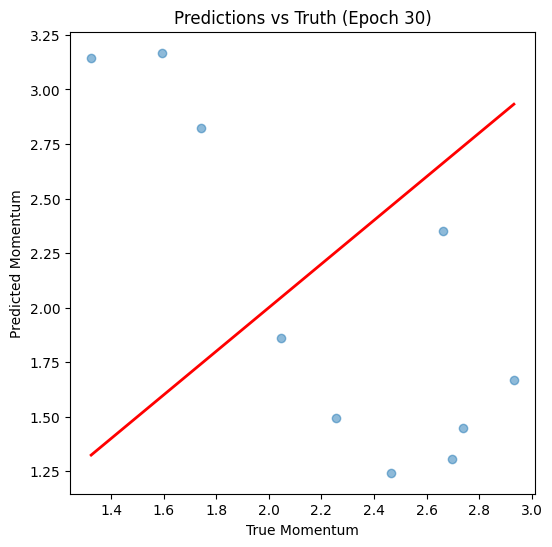

Epoch 40: Train Loss = 0.0654, Val Loss = 1.4650


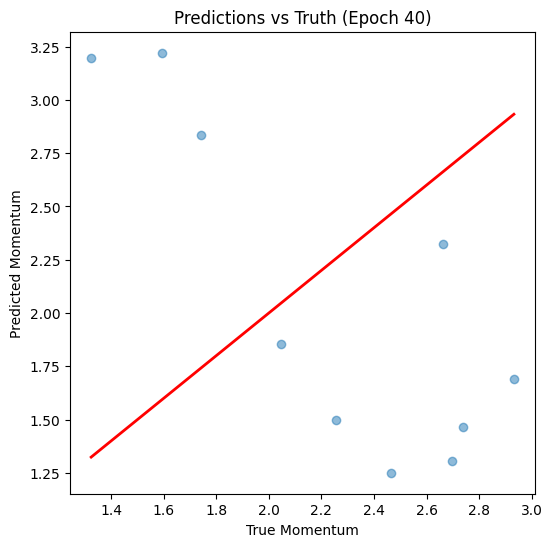

Epoch 50: Train Loss = 0.0587, Val Loss = 1.4896


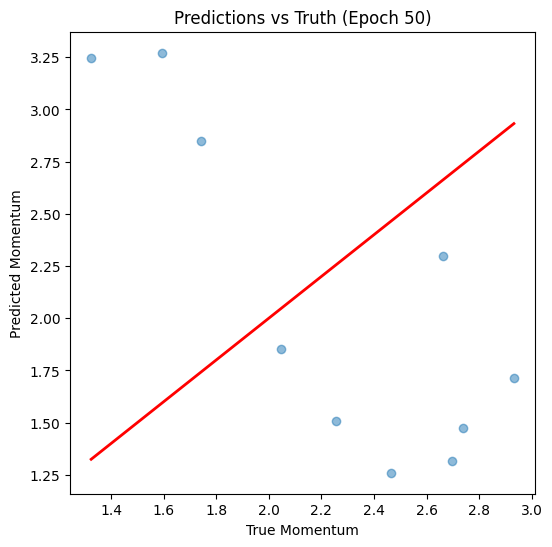

Epoch 60: Train Loss = 0.0529, Val Loss = 1.5120


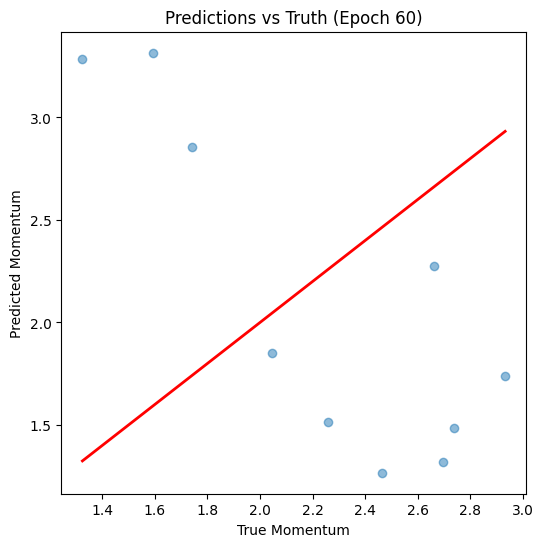

Epoch 70: Train Loss = 0.0478, Val Loss = 1.5346


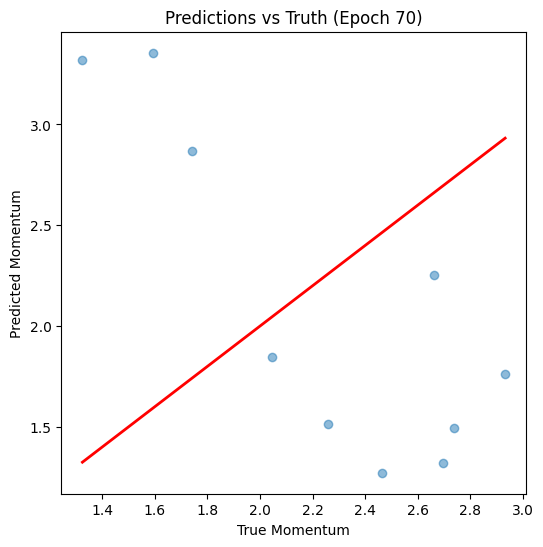

Epoch 80: Train Loss = 0.0431, Val Loss = 1.5595


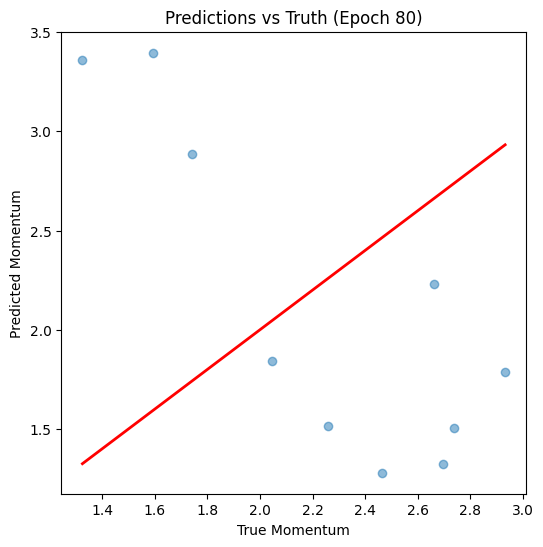

Epoch 90: Train Loss = 0.0390, Val Loss = 1.5868


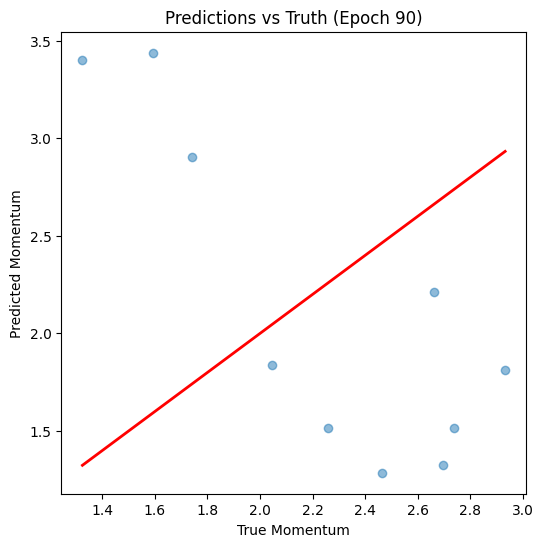

In [22]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Load the dataset
# file_path = "/mnt/data/test(6).csv"
# df = pd.read_csv(file_path)
df = new_feats
# Drop non-feature columns
features = df.drop(columns=[ "event_idx", "momentum"])
target = df["momentum"]

# Normalize features
scaler = StandardScaler()
features = scaler.fit_transform(features)

# Convert to PyTorch tensors
X = torch.tensor(features, dtype=torch.float32)
y = torch.tensor(target.values, dtype=torch.float32).view(-1, 1)

# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the neural network
class MomentumPredictor(nn.Module):
    def __init__(self, input_dim):
        super(MomentumPredictor, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 1)
        )
    
    def forward(self, x):
        return self.model(x)

# Initialize model, loss function, and optimizer
model = MomentumPredictor(X_train.shape[1])
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
def train_model(model, X_train, y_train, X_test, y_test, epochs=100):
    for epoch in range(epochs):
        model.train()
        optimizer.zero_grad()
        y_pred = model(X_train)
        loss = criterion(y_pred, y_train)
        loss.backward()
        optimizer.step()
        
        if epoch % 10 == 0:
            model.eval()
            with torch.no_grad():
                val_pred = model(X_test)
                val_loss = criterion(val_pred, y_test)
            print(f"Epoch {epoch}: Train Loss = {loss.item():.4f}, Val Loss = {val_loss.item():.4f}")
            visualize_predictions(y_test, val_pred, epoch)

# Function to visualize predictions vs truth
def visualize_predictions(y_test, y_pred, epoch):
    plt.figure(figsize=(6, 6))
    plt.scatter(y_test.numpy(), y_pred.numpy(), alpha=0.5)
    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r', lw=2)
    plt.xlabel("True Momentum")
    plt.ylabel("Predicted Momentum")
    plt.title(f"Predictions vs Truth (Epoch {epoch})")
    plt.show()

# Train the model
train_model(model, X_train, y_train, X_test, y_test)
# Train the model
train_model(model, X_train, y_train, X_test, y_test)


In [5]:
class HitDataset(DGLDataset):
    def __init__(self, data, filter_events,max_distance = 200):
        self.data = data
        self.filter_events = filter_events
        self.max_distance = max_distance
        super().__init__(name = "KLM_reco")
    def process(self):
        events_group = self.data.groupby(["event_idx","file_idx"])
        self.labels = []
        self.graphs = []
        it_idx = 0
        for event_idx in events_group.groups:
            curr_event = events_group.get_group(event_idx)
            nhits = len(curr_event)
            '''FIRST FILTER FOR EVENTS'''
            if(self.filter_events):
                ModifiedTrueID_unique = np.array(curr_event['ModifiedTrueID'].unique())
                valid_ModifiedTrueID_unique = ModifiedTrueID_unique[ModifiedTrueID_unique != -1]
                #skip events with multiple valid trueIDs
                if(len(valid_ModifiedTrueID_unique) > 1):
                    continue
            
                #skip events with no valid ModififiedTrueIDs
                if(len(valid_ModifiedTrueID_unique) == 0):
                    continue
            # Skip graphs with only 1 hit (or 0)
            if(nhits <2):
                continue;
            else:
                x = curr_event['strip_x'].values
                y = curr_event['strip_y'].values

                # Create coordinate matrices
                x_diff = x[:, np.newaxis] - x[np.newaxis, :]  # Creates a matrix of all x differences
                y_diff = y[:, np.newaxis] - y[np.newaxis, :]  # Creates a matrix of all y differences

                # Compute distances in one go
                distances = np.sqrt(x_diff**2 + y_diff**2)

                # Create mask for valid edges (upper triangle only to avoid duplicates)
                upper_mask = (distances < self.max_distance) & (np.triu(np.ones_like(distances), k=1) > 0)

                # Get edge indices for upper triangle
                src_upper, dst_upper = np.where(upper_mask)

                # Create the bidirectional edges
                sources = np.concatenate([src_upper, dst_upper])
                destinations = np.concatenate([dst_upper, src_upper])
            g = dgl.graph((sources, destinations), num_nodes=nhits)
            #Want to predict momentum/energy
            label = torch.tensor(curr_event["P"].to_numpy()[0])
            self.labels.append(label)
            '''VERSION WITH LABEL AS FEATURE'''
            #THIS VERSION KEEPS FEATURES IN ONE DIMENSION
            feats = np.stack((
                curr_event["strip_x"].to_numpy() / 300,curr_event["strip_y"].to_numpy() / 300,
                curr_event["Time"].to_numpy() / 5,
                curr_event["Charge"].to_numpy(),
                curr_event["stave_idx"].to_numpy(),
                curr_event["layer_idx"].to_numpy(),
                curr_event["segment_idx"].to_numpy(),
                curr_event["SiPM_idx"].to_numpy()
                #,label * np.ones(len(curr_event["strip_x"].to_numpy()))
            ),axis = -1)
#             feats = curr_event["Charge"].to_numpy()
            g.ndata["feat"] = torch.tensor(feats)#.unsqueeze(-1)
    

            #add graph to dataset
            self.graphs.append(g)
            it_idx += 1
        self.dim_nfeats = self.graphs[0].ndata["feat"].shape[1]
        self.labels = torch.tensor(self.labels, dtype = torch.float32)

    def __getitem__(self, i):
        return self.graphs[i], self.labels[i]

    def __len__(self):
        return len(self.graphs)

In [6]:
dataset = HitDataset(modified_df,True,max_distance = 0.05)
print("done")

done


## **Optionally, we can visualize any of the input graphs below**

In [7]:
def visualize_detector_graph(curr_event, sources, destinations, max_edges=1000, figsize=(6, 6),max_angle = 22):
    """
    Visualizes the detector hits and their connections.
    
    Parameters:
    curr_event (pd.DataFrame): DataFrame containing 'strip_x' and 'strip_y' columns
    sources (np.array): Array of source node indices
    destinations (np.array): Array of destination node indices
    max_edges (int): Maximum number of edges to plot to avoid overcrowding
    figsize (tuple): Figure size in inches
    """
    colors = curr_event['ModifiedTrueID'].apply(lambda x: 'red' if x == -1 else 'blue')
    sizes = curr_event['Charge'].apply(lambda x: x)
    # Create figure
    plot.figure(figsize=figsize)
    
    # Plot nodes (hits)
    plot.scatter(curr_event['strip_x'], curr_event['strip_y'], 
               c=colors, s=sizes * 1, alpha=0.4, label='Detector hits')
    
    # If there are too many edges, randomly sample them
    n_edges = len(sources)
    if n_edges > max_edges:
        idx = np.random.choice(n_edges, max_edges, replace=False)
        sources = sources[idx]
        destinations = destinations[idx]
    
    # Plot edges
    for src, dst in zip(sources, destinations):
        x1, y1 = curr_event.iloc[src][['strip_x', 'strip_y']]
        x2, y2 = curr_event.iloc[dst][['strip_x', 'strip_y']]
        plot.plot([x1, x2], [y1, y2], 'gray', alpha=0.1, linewidth=0.5)
    # Add reference angle and highlight region
    reference_angle = curr_event['reference_angle'].iloc[0]  # Assuming one reference angle per event
    radius = 250  # Radius of the detector
    
    # Calculate the coordinates for the line
    x_ref = radius * np.cos(np.radians(reference_angle))
    y_ref = radius * np.sin(np.radians(reference_angle))
#     plot.plot([0, x_ref], [0, y_ref], color='black', linewidth=3, label='Reference angle')
    
    # Highlight the 11-degree region
    theta_min = reference_angle - max_angle
    theta_max = reference_angle + max_angle
    
    # Calculate the coordinates for the line
    x_min = radius * np.cos(np.radians(theta_min))
    y_min = radius * np.sin(np.radians(theta_min))
    plot.plot([0, x_min], [0, y_min], color='orange', linewidth=1.5, label='Lower bound')
    
    # Calculate the coordinates for the line
    x_max = radius * np.cos(np.radians(theta_max))
    y_max = radius * np.sin(np.radians(theta_max))
    plot.plot([0, x_max], [0, y_max], color='orange', linewidth=1.5, label='Upper bound')
    
    # Add labels and title
    plot.xlabel('X Position')
    plot.ylabel('Y Position')
    plot.title(f'Detector Graph Visualization\n{len(curr_event)} nodes, {n_edges//2} edges')
    
    # Add text with statistics
    stats_text = f'Total nodes: {len(curr_event)}\n'
    stats_text += f'Total edges: {n_edges//2}\n'  # Divide by 2 because edges are bidirectional
    stats_text += f'Average degree: {n_edges/len(curr_event):.1f}'
#     plot.text(0.02, 0.98, stats_text,
#              transform=plot.gca().transAxes,
#              verticalalignment='top',
#              bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
    
    plot.grid(True, alpha=0.3)
    plot.axis('equal')
    plot.tight_layout()
#     plot.xlim(120,250)
#     plot.ylim(25,130)
    plot.xlim(-250,250)
    plot.ylim(-250,250)
    plot.savefig("plots/GNN/graph_only.pdf")

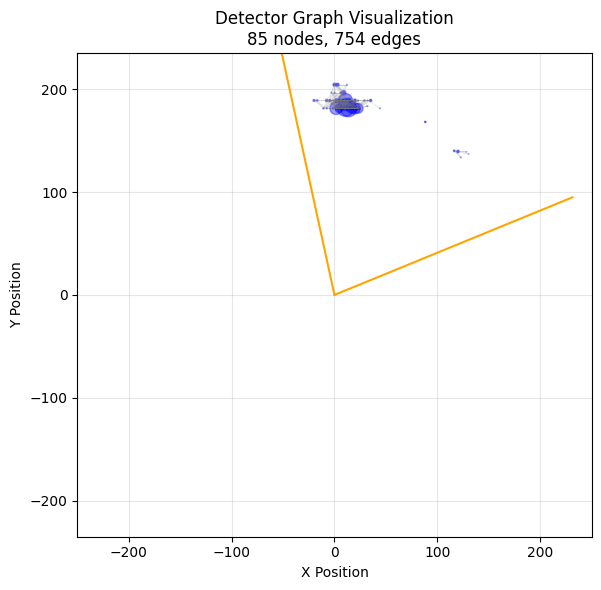

In [8]:
event_groups = modified_df.groupby(["event_idx","file_idx"])
event_1 = event_groups.get_group((1,0))
max_distances = 0.05
srcs, dests = create_fast_edge_lists(event_1,max_distances * 300)
visualize_detector_graph(event_1,srcs,dests,max_angle = 40)

## **Define dataloader**

We use a dataloader to make batching easier, and to randomly split test and train

In [9]:
train_frac = 0.7
val_frac = 0.15
num_train = int(np.floor(len(dataset) * train_frac))
# num_train = 5
num_val = int(np.floor(len(dataset) * val_frac))
num_examples = len(dataset)

train_sampler = SubsetRandomSampler(torch.arange(num_train))
val_sampler = SubsetRandomSampler(torch.arange(num_train, num_val + num_train))
test_sampler = SubsetRandomSampler(torch.arange(num_val + num_train, num_examples))

train_dataloader = GraphDataLoader(
    dataset, sampler=train_sampler, batch_size=20, drop_last=False
)

val_dataloader = GraphDataLoader(
    dataset, sampler=val_sampler, batch_size=20, drop_last=False
)

test_dataloader = GraphDataLoader(
    dataset, sampler=test_sampler, batch_size=20, drop_last=False
)

## **Initialize the model and define the optimizer/criterion**

In [10]:
run_num = 1
geometry_type = 2

In [11]:

from dgl.nn import GraphConv,SumPooling,GINConv,AvgPooling

In [12]:
# class GIN(nn.Module):
#     def __init__(self, in_feats, h_feats,linear_h_feats,num_GCN_layers,num_linear_layers, num_classes=1):
#         super(GIN, self).__init__()
        
#         self.num_GCN_layers = num_GCN_layers
#         self.num_linear_layers = num_linear_layers
        
#         self.GCNs = nn.ModuleList()
#         # Define the MLP for the GINConv layers
#         for i in range(num_GCN_layers):
#             if(i == 0):
#                 self.GCNs.append( 
#                     GINConv(nn.Sequential(
#                         nn.Linear(in_feats, h_feats),
#                         nn.ReLU(),
#                         nn.Linear(h_feats, h_feats)
#                         )
#                    )
#                 )
#             else:
#                 self.GCNs.append( 
#                     GINConv(nn.Sequential(
#                         nn.Linear(h_feats, h_feats),
#                         nn.ReLU(),
#                         nn.Linear(h_feats, h_feats)
#                         )
#                    )
#                 )
#         self.linears = nn.ModuleList()
#         if(num_linear_layers > 1):
#             for i in range(num_linear_layers - 1):
#                 if(i == 0):
#                     self.linears.append(nn.Linear(h_feats,linear_h_feats))
#                 else:
#                     self.linears.append(nn.Linear(linear_h_feats // pow(2,(i - 1)), linear_h_feats // pow(2,i)))
#         self.linears.append(nn.Linear(linear_h_feats // pow(2,num_linear_layers - 2),1))
        
#         # Graph pooling layer
#         self.pool = AvgPooling()
# #         self.pool = SumPooling()

#     def forward(self, g, in_feat):
#         # Apply the first GINConv layer
#         h = in_feat
#         for i in range(self.num_GCN_layers):
#             h = self.GCNs[i](g,h)
#             h = F.relu(h)
#         h = self.pool(g,h)
#         h = self.linears[0](h)
#         h = F.relu(h)
#         if(self.num_linear_layers > 1):
#             for i in range(1,self.num_linear_layers):
#                 h = self.linears[i](h)
#                 if(i != self.num_linear_layers - 1):
#                     h = F.relu(h)
        
#         return h

In [13]:
# # CLAUDE VERSION
# import torch.nn.init as init
# class GIN(nn.Module):
#     def __init__(self, in_feats, h_feats, linear_h_feats, num_GCN_layers, num_linear_layers, num_classes=1):
#         super(GIN, self).__init__()
        
#         self.num_GCN_layers = num_GCN_layers
#         self.num_linear_layers = num_linear_layers
        
#         # GIN layers
#         self.GCNs = nn.ModuleList()
#         for i in range(num_GCN_layers):
#             mlp = nn.Sequential(
#                 nn.Linear(in_feats if i == 0 else h_feats, h_feats),
#                 nn.ReLU(),
#                 nn.Linear(h_feats, h_feats),
#             )
#             self.GCNs.append(GINConv(mlp, learn_eps=True))  # Enable learnable epsilon
            
#         # Linear layers
#         self.linears = nn.ModuleList()
#         current_dim = h_feats
        
#         for i in range(num_linear_layers - 1):
#             next_dim = linear_h_feats // (2 ** i) if i > 0 else linear_h_feats
#             self.linears.append(nn.Linear(current_dim, next_dim))
#             current_dim = next_dim
            
#         # Final output layer
#         self.linears.append(nn.Linear(current_dim, num_classes))
        
#         # Dropout for regularization
#         self.dropout = nn.Dropout(0.2)
        
#         # Graph pooling layer
#         self.pool = AvgPooling()
#         self.apply(self._init_weights)

#     def _init_weights(self, m):
#         if isinstance(m, nn.Linear):
#             init.kaiming_normal_(m.weight, nonlinearity='relu')
#             if m.bias is not None:
#                 init.zeros_(m.bias)

#     def forward(self, g, in_feat):
#         h = in_feat
        
#         # GIN layers with residual connections
#         for i in range(self.num_GCN_layers):
#             h_prev = h
#             h = self.GCNs[i](g, h)
#             h = F.leaky_relu(h, negative_slope=0.01)

# #             h = self.dropout(h)
#             if i > 0 and h.shape == h_prev.shape:  # Add residual connection if shapes match
#                 h = h + h_prev
                
#         # Global pooling
#         h = self.pool(g, h)
        
#         # MLP layers
#         for i in range(self.num_linear_layers - 2):
#             h = self.linears[i](h)
#             h = F.leaky_relu(h, negative_slope=0.01)
#         h = self.linears[-2](h)
#         h = F.tanh(h)
        
#         # Final layer
#         h = self.linears[-1](h)
#         return h

In [14]:
class GIN(nn.Module):
    def __init__(self, in_feats, h_feats, num_classes=1):
        super(GIN, self).__init__()
        
        # Define the MLP for the GINConv layers
        self.mlp1 = nn.Sequential(
            nn.Linear(in_feats, h_feats),
            nn.ReLU(),
            nn.Linear(h_feats, h_feats)
        )
        
        self.mlp2 = nn.Sequential(
            nn.Linear(h_feats, h_feats),
            nn.ReLU(),
            nn.Linear(h_feats, h_feats)
        )
        
        # Define the GINConv layers
        self.conv1 = GINConv(self.mlp1)
        self.conv2 = GINConv(self.mlp2)
        self.linear1 = nn.Linear(h_feats, 256)
        self.linear2 = nn.Linear(256, 128)
        self.linear3 = nn.Linear(128, 128)
        self.linear4 = nn.Linear(128, 64)
        self.linear5 = nn.Linear(64, 64)
        self.linear6 = nn.Linear(64, 16)
        self.linear7 = nn.Linear(16, 1)
        
        # Graph pooling layer
        self.pool = AvgPooling()
#         self.pool = SumPooling()

    def forward(self, g, in_feat):
        # Apply the first GINConv layer
        h = self.conv1(g, in_feat)
        h = F.relu(h)
        
#         Apply the second GINConv layer
        h = self.conv2(g, h)
        h = F.relu(h)
        
        # Pool the graph-level representation
        hg = self.pool(g, h)
        hg = self.linear1(hg)
        hg = F.relu(hg)
        hg = self.linear2(hg)
        hg = F.relu(hg)
        hg = self.linear3(hg)
        hg = F.relu(hg)
        hg = self.linear4(hg)
        hg = F.relu(hg)
        hg = self.linear5(hg)
        hg = F.relu(hg)
        hg = self.linear6(hg)
        hg = F.relu(hg)
        hg = self.linear7(hg)
        
        return hg

In [28]:
hidden_dim = 32
model = GIN(dataset.dim_nfeats, hidden_dim)
optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)
# criterion = F.smooth_l1_loss
criterion = nn.MSELoss()

*Now we can actually train the model*

In [29]:
def train_GNN(model,optimizer,criterion, train_dataloader, val_dataloader, n_epochs,early_stopping_limit):
    create_directory(f"models/GNN_Energy_prediction/{current_date}/")
    val_mse = []
    val_mse_all = []
    train_losses = []
    train_losses_all = []
    early_stopping_dict = {
            "lowest_loss" : -1,
            "best_model_path" : "",
            "num_upticks" : 0
    }
    # 0: loss; 1: path; 2: # hits

    for epoch in range(n_epochs):
        model.train()
        num_train_batches = 0
        epoch_train_losses = 0.0
        train_preds = torch.tensor([])
        train_truths = torch.tensor([])
        for batched_graph, labels in train_dataloader:
            pred = model(batched_graph, batched_graph.ndata["feat"].float())
            loss = criterion(pred, labels.unsqueeze(-1))
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            epoch_train_losses+=loss.detach()
            train_losses_all.append(loss.detach())
            num_train_batches += 1
            train_preds = torch.cat([train_preds,pred.detach()])
            train_truths = torch.cat([train_truths,labels])
        # Average RMSE for the epoch
        this_epoch_loss = epoch_train_losses / num_train_batches
        train_losses.append(this_epoch_loss)
        # Testing phase
        model.eval()
        epoch_val_mse = 0.0
        num_val_batches = 0
        val_preds = torch.tensor([])
        val_truths = torch.tensor([])
        with torch.no_grad():  # Disable gradients for evaluation
            for batched_graph, labels in val_dataloader:
                pred = model(batched_graph, batched_graph.ndata["feat"].float())
                # Calculate RMSE for this batch
                batch_mse = criterion(pred, labels.unsqueeze(-1))
                epoch_val_mse += batch_mse
                num_val_batches += 1
                val_mse_all.append(batch_mse)
                val_preds = torch.cat([val_preds,pred])
                val_truths = torch.cat([val_truths,labels])

        # Average RMSE for the test set
        epoch_val_mse /= num_val_batches
        val_mse.append(epoch_val_mse)
        
        if(epoch %1 == 0):
            print(f"Epoch {epoch + 1}/{n_epochs} - Train loss:\t {this_epoch_loss:.4f}")
            print(f"Epoch {epoch + 1}/{n_epochs} - Validation MSE:\t {epoch_val_mse:.4f}\n")
            plot.plot([0,5],[0,5])
            plot.title("Test dataset results")
            plot.scatter(val_truths,val_preds,alpha = 0.05,color = "red",label = "val")
#             plot.scatter(train_truths,train_preds,alpha = 0.01,color = "blue",label = "train")
            plot.xlabel("truths")
            plot.ylabel("preds")
            plot.text(3.1,1.3, f"Epoch #{epoch + 1}\nTrain, val loss: ({this_epoch_loss:.4f},{epoch_val_mse:.4f})")
            plot.tight_layout()
            plot.legend()
            plot.savefig(f"plots/training_gif_full_dataset_w_layer_idx_bigger_model/frame{epoch}.jpeg")
            plot.show()
        
        if(epoch_val_mse.item() < early_stopping_dict["lowest_loss"] or early_stopping_dict["lowest_loss"] == -1):
            early_stopping_dict["lowest_loss"] = epoch_val_mse
            early_stopping_dict["best_model_path"] = f"models/GNN_Energy_prediction/{current_date}/run_{run_num}_events50k_lr0_001_hiddendim6_epoch{epoch}_geometry_{geometry_type}pth"
            early_stopping_dict["num_upticks"] = 0
            
            torch.save(model.state_dict(),early_stopping_dict["best_model_path"])
        elif(epoch_val_mse.item() > early_stopping_dict["lowest_loss"]):
            early_stopping_dict["num_upticks"] += 1
#             print("Test loss increased, adding uptick")
        if(early_stopping_dict["num_upticks"] >= early_stopping_limit):
            # Stop training, load best model
#             model.load_state_dict(torch.load(early_stopping_dict["best_model_path"]))
#             torch.save(model.state_dict(),f"models/GNN_Energy_prediction/{current_date}/run_{run_num}_events50k_lr0_001_hiddendim6_best_geometry_{geometry_type}.pth")
            print("Stopping early, loading current model...")
            break
    return model, train_losses, val_mse, optimizer

Epoch 1/300 - Train loss:	 0.4840
Epoch 1/300 - Validation MSE:	 0.3311



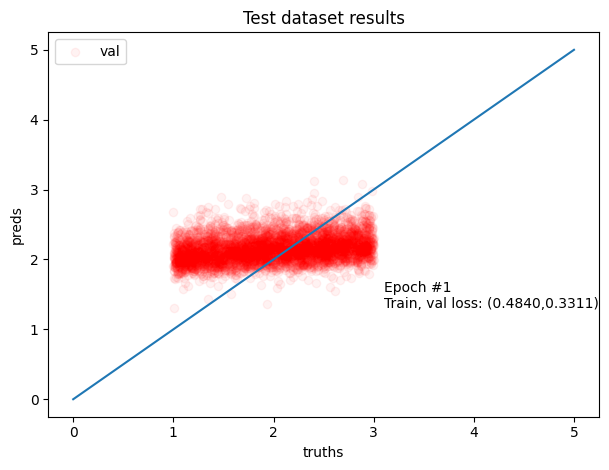

Epoch 2/300 - Train loss:	 0.3192
Epoch 2/300 - Validation MSE:	 0.3066



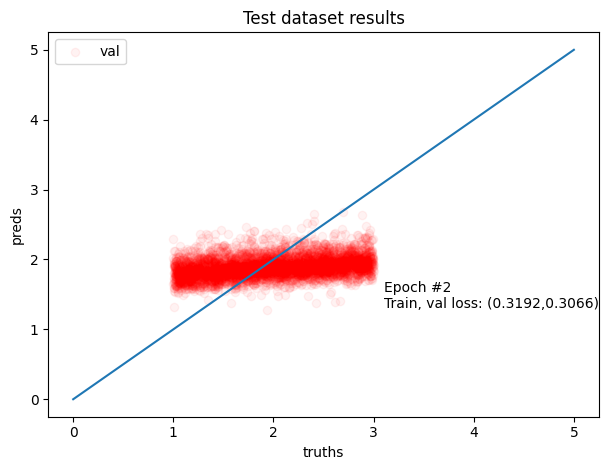

Epoch 3/300 - Train loss:	 0.3134
Epoch 3/300 - Validation MSE:	 0.2964



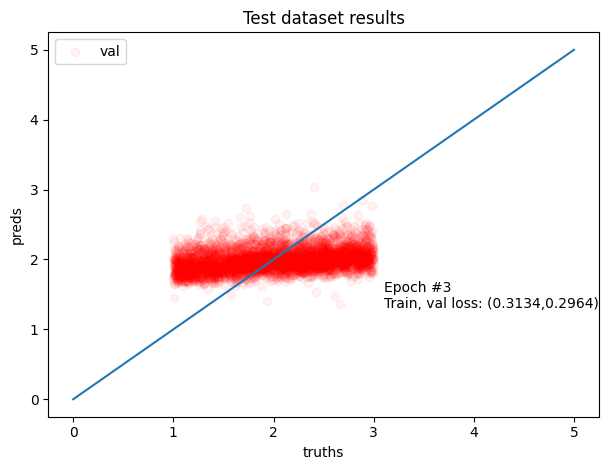

Epoch 4/300 - Train loss:	 0.3120
Epoch 4/300 - Validation MSE:	 0.2898



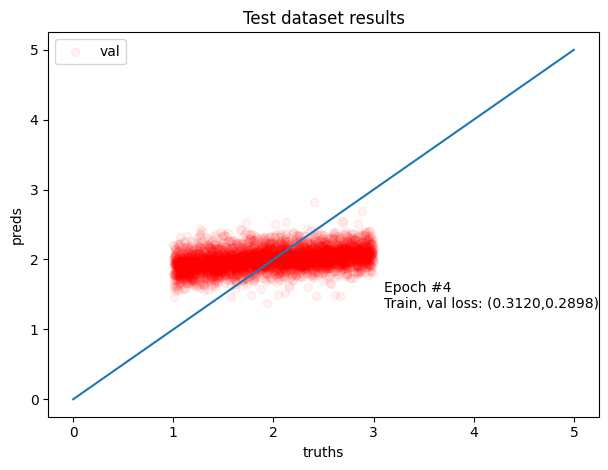

Epoch 5/300 - Train loss:	 0.3059
Epoch 5/300 - Validation MSE:	 0.2951



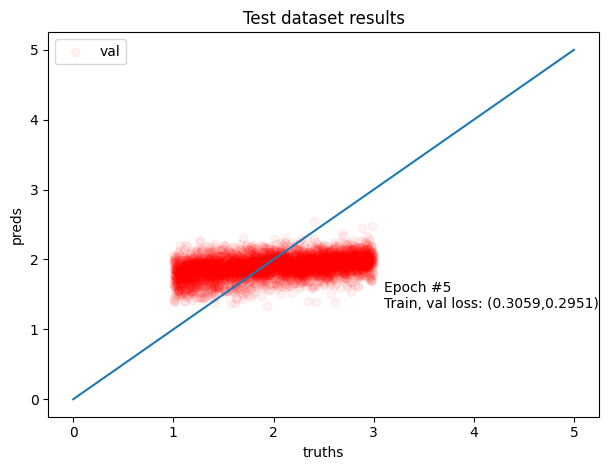

Epoch 6/300 - Train loss:	 0.2983
Epoch 6/300 - Validation MSE:	 0.2943



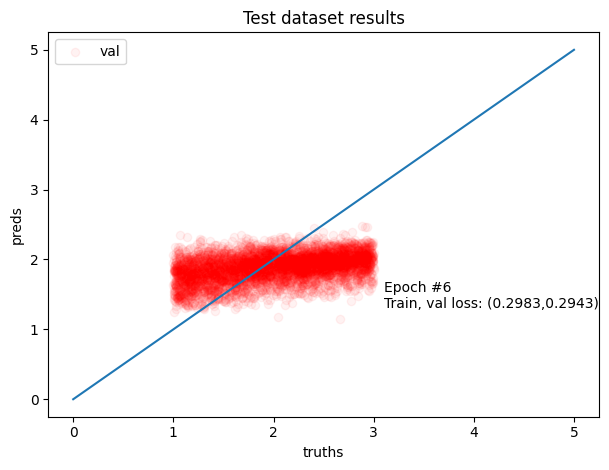

Epoch 7/300 - Train loss:	 0.2945
Epoch 7/300 - Validation MSE:	 0.2734



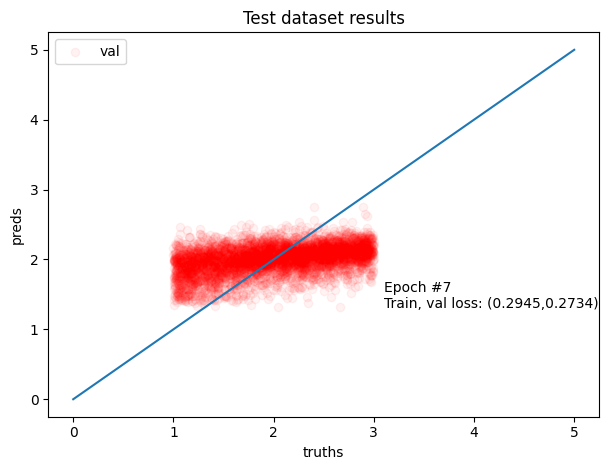

Epoch 8/300 - Train loss:	 0.2904
Epoch 8/300 - Validation MSE:	 0.2969



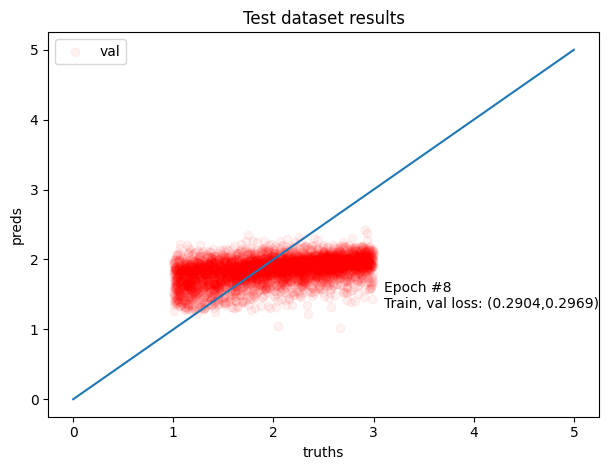

Epoch 9/300 - Train loss:	 0.2883
Epoch 9/300 - Validation MSE:	 0.2724



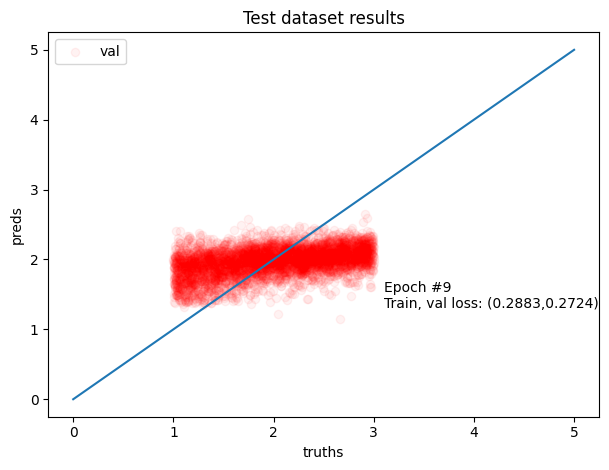

Epoch 10/300 - Train loss:	 0.2862
Epoch 10/300 - Validation MSE:	 0.2714



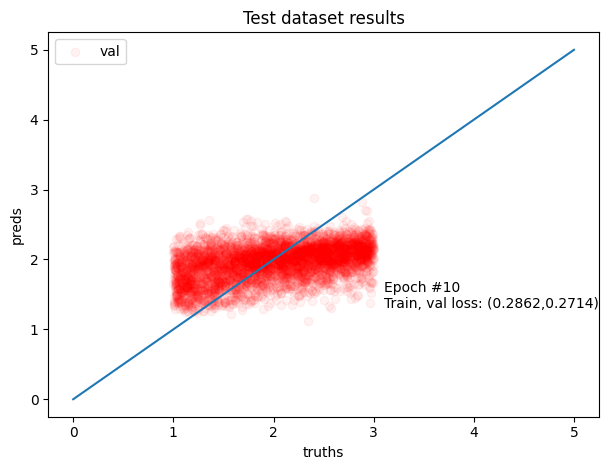

Epoch 11/300 - Train loss:	 0.2828
Epoch 11/300 - Validation MSE:	 0.2622



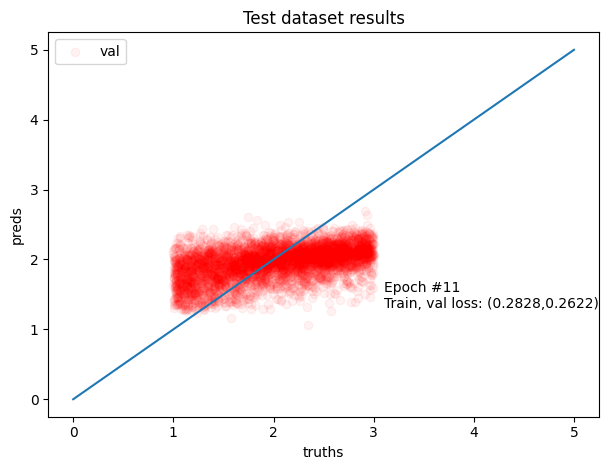

Epoch 12/300 - Train loss:	 0.2806
Epoch 12/300 - Validation MSE:	 0.2610



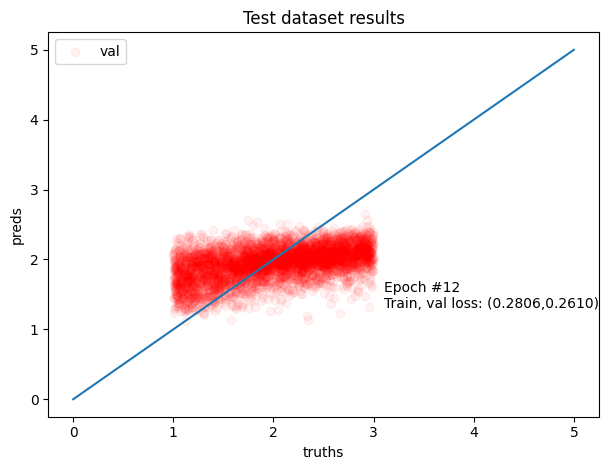

Epoch 13/300 - Train loss:	 0.2744
Epoch 13/300 - Validation MSE:	 0.2566



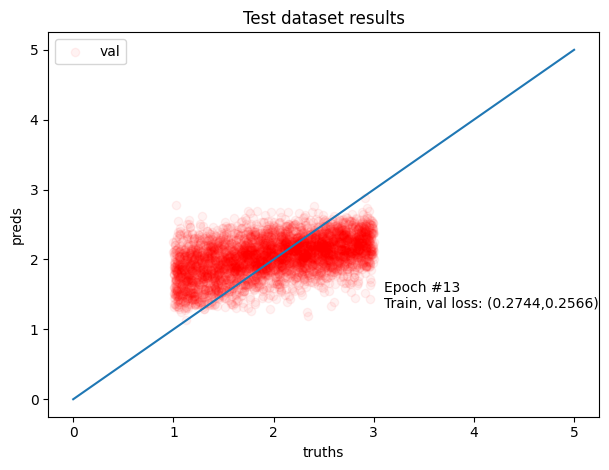

Epoch 14/300 - Train loss:	 0.2693
Epoch 14/300 - Validation MSE:	 0.2661



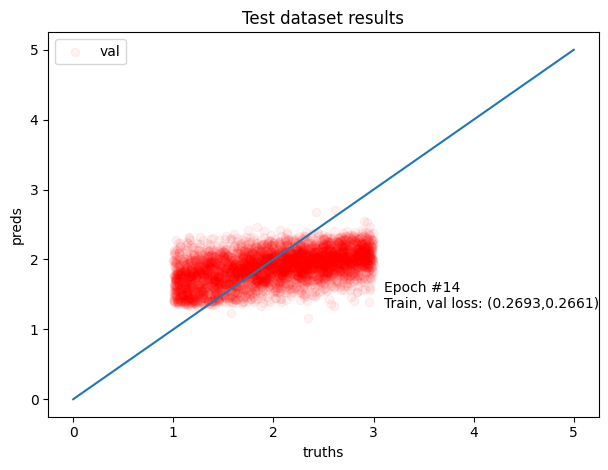

Epoch 15/300 - Train loss:	 0.2641
Epoch 15/300 - Validation MSE:	 0.2503



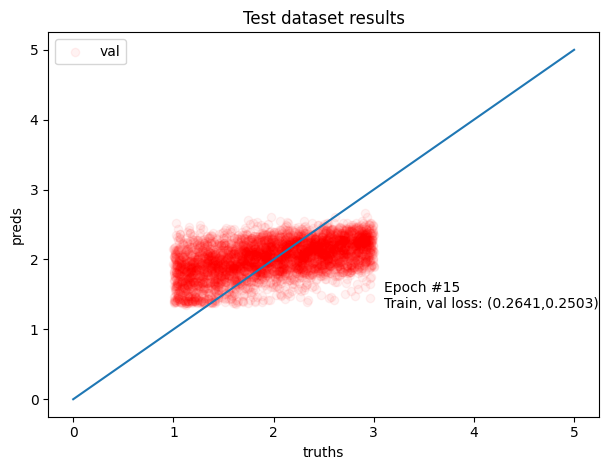

Epoch 16/300 - Train loss:	 0.2598
Epoch 16/300 - Validation MSE:	 0.2486



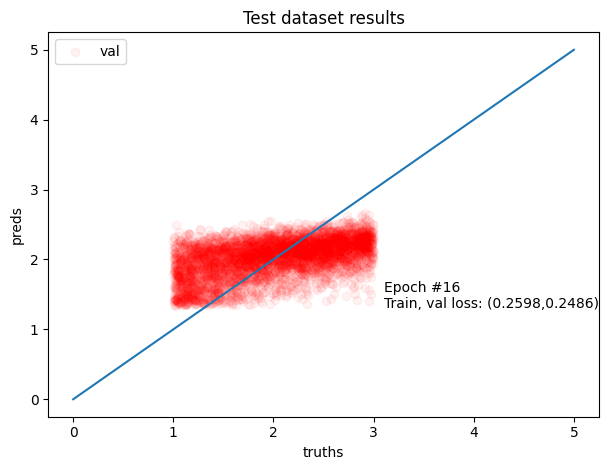

Epoch 17/300 - Train loss:	 0.2577
Epoch 17/300 - Validation MSE:	 0.2396



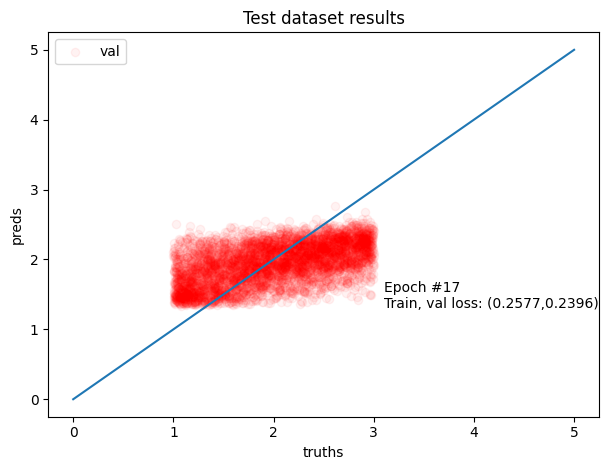

Epoch 18/300 - Train loss:	 0.2533
Epoch 18/300 - Validation MSE:	 0.2406



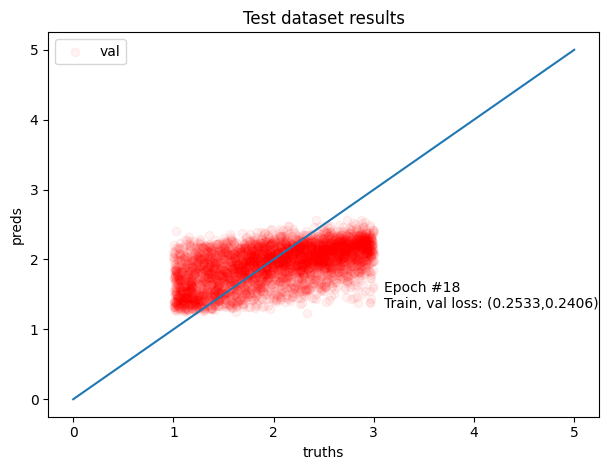

Epoch 19/300 - Train loss:	 0.2490
Epoch 19/300 - Validation MSE:	 0.2311



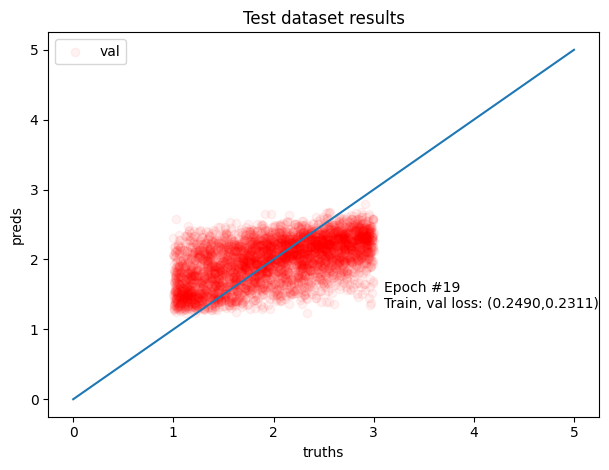

Epoch 20/300 - Train loss:	 0.2449
Epoch 20/300 - Validation MSE:	 0.2268



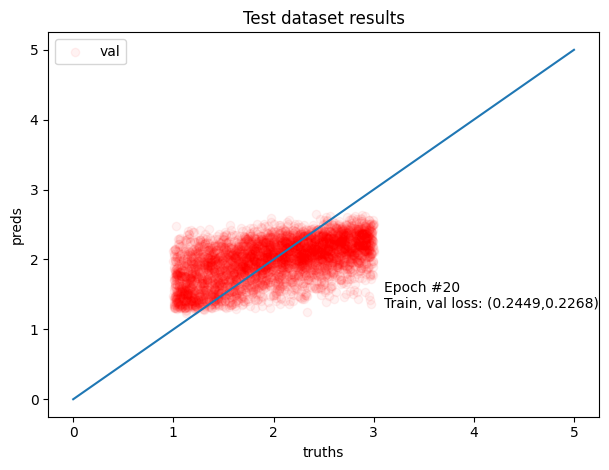

Epoch 21/300 - Train loss:	 0.2417
Epoch 21/300 - Validation MSE:	 0.2293



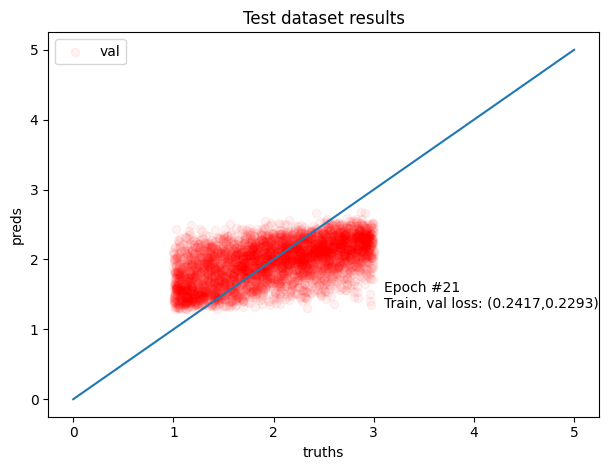

Epoch 22/300 - Train loss:	 0.2403
Epoch 22/300 - Validation MSE:	 0.2434



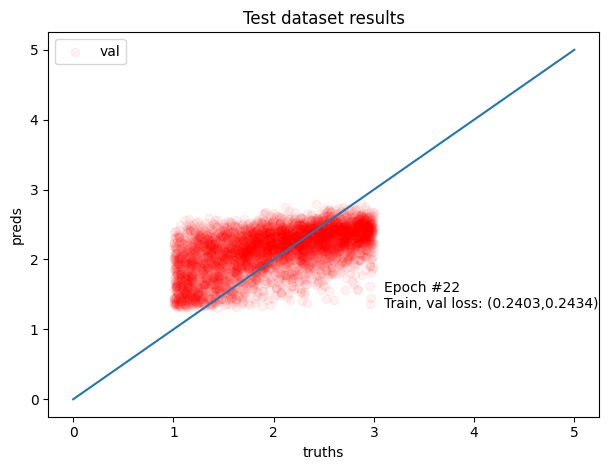

Epoch 23/300 - Train loss:	 0.2369
Epoch 23/300 - Validation MSE:	 0.2331



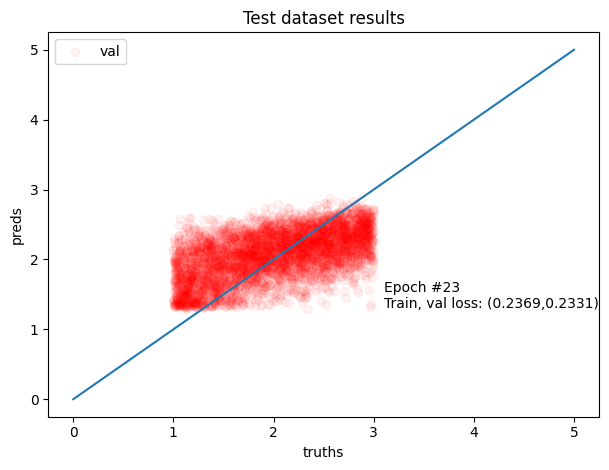

Epoch 24/300 - Train loss:	 0.2373
Epoch 24/300 - Validation MSE:	 0.2319



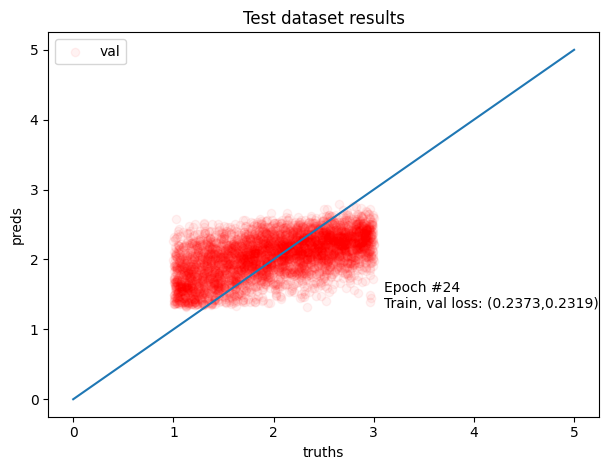

Epoch 25/300 - Train loss:	 0.2331
Epoch 25/300 - Validation MSE:	 0.2261



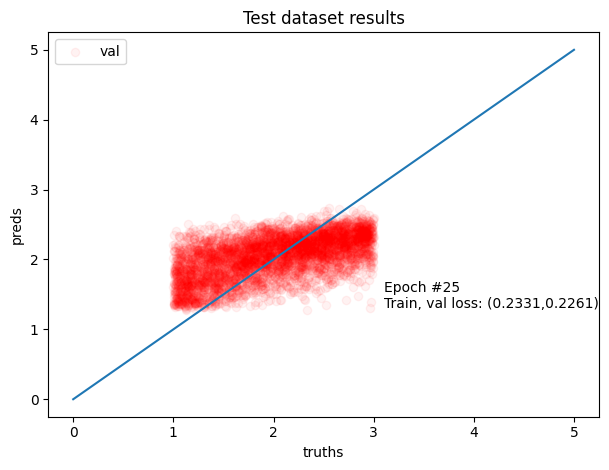

Epoch 26/300 - Train loss:	 0.2306
Epoch 26/300 - Validation MSE:	 0.2384



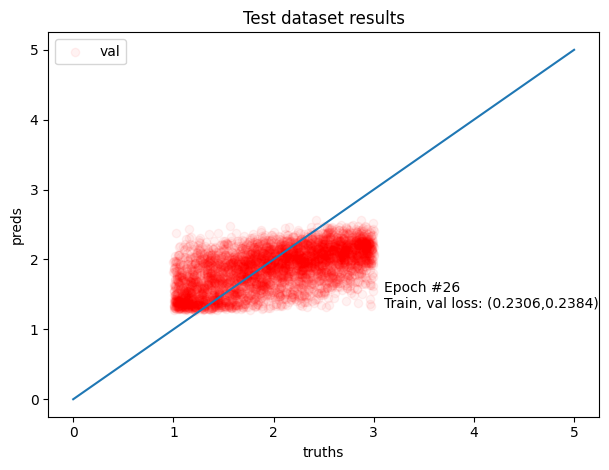

Epoch 27/300 - Train loss:	 0.2293
Epoch 27/300 - Validation MSE:	 0.2179



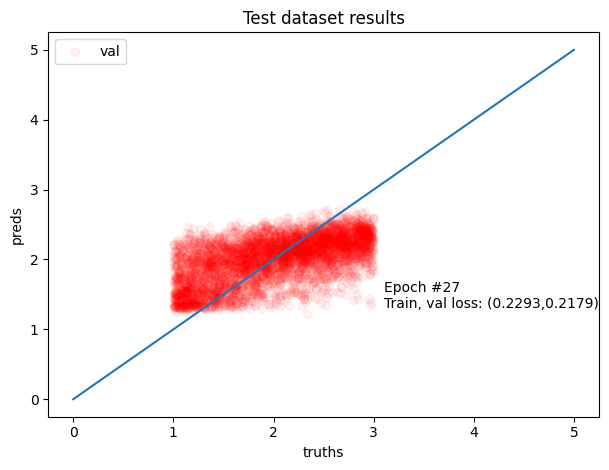

Epoch 28/300 - Train loss:	 0.2277
Epoch 28/300 - Validation MSE:	 0.2378



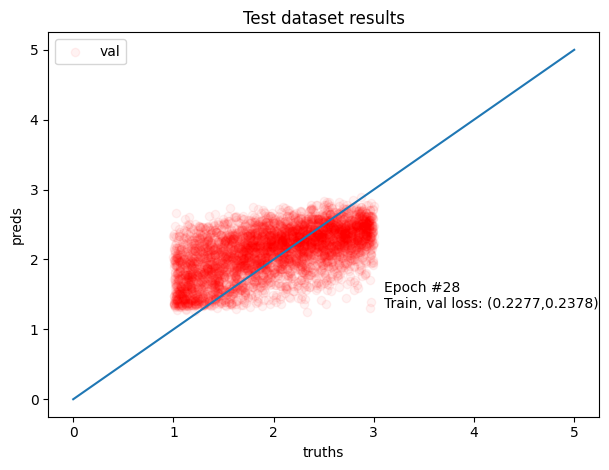

Epoch 29/300 - Train loss:	 0.2257
Epoch 29/300 - Validation MSE:	 0.2623



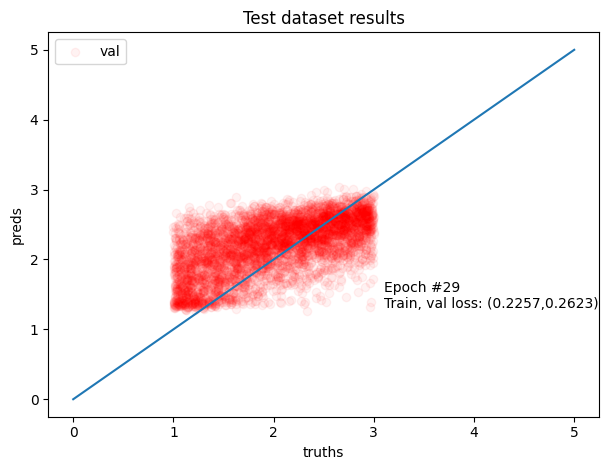

Epoch 30/300 - Train loss:	 0.2245
Epoch 30/300 - Validation MSE:	 0.2231



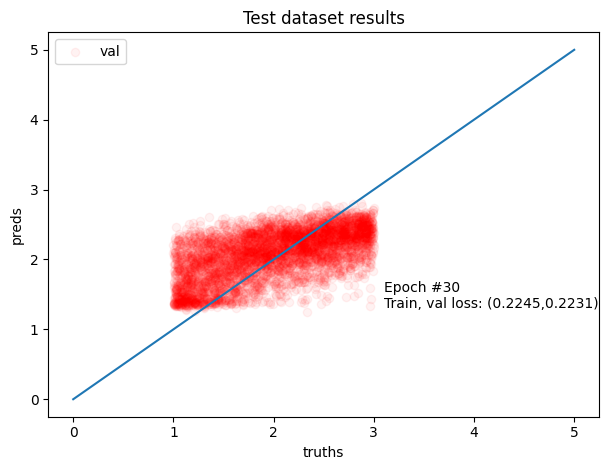

Epoch 31/300 - Train loss:	 0.2233
Epoch 31/300 - Validation MSE:	 0.2329



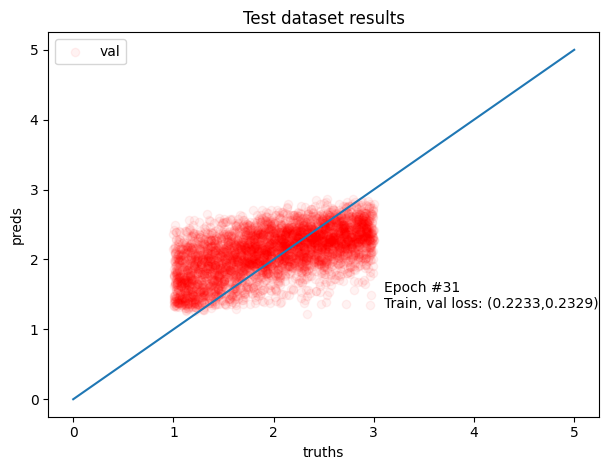

Epoch 32/300 - Train loss:	 0.2215
Epoch 32/300 - Validation MSE:	 0.2168



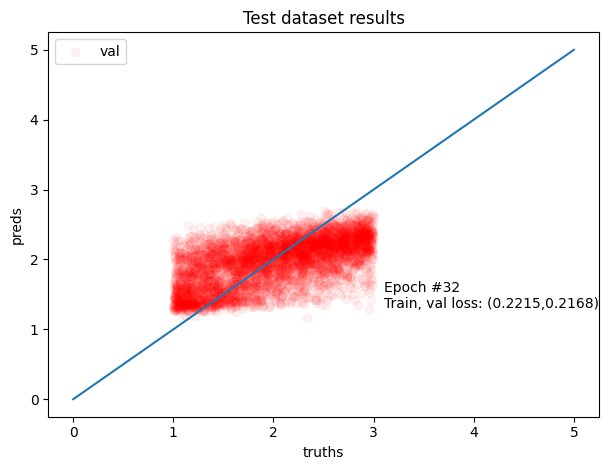

Epoch 33/300 - Train loss:	 0.2180
Epoch 33/300 - Validation MSE:	 0.2261



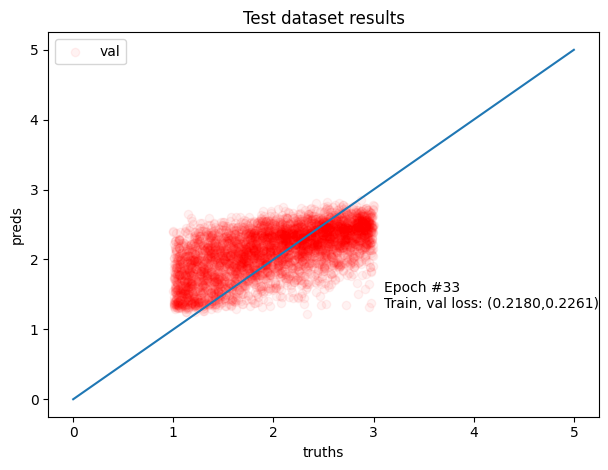

Epoch 34/300 - Train loss:	 0.2164
Epoch 34/300 - Validation MSE:	 0.2189



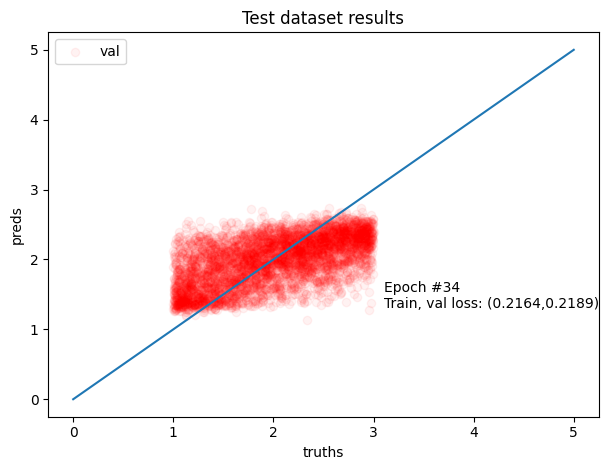

Epoch 35/300 - Train loss:	 0.2145
Epoch 35/300 - Validation MSE:	 0.2350



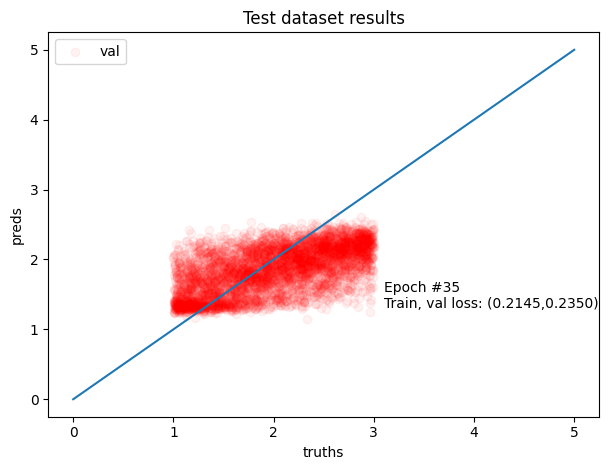

Epoch 36/300 - Train loss:	 0.2125
Epoch 36/300 - Validation MSE:	 0.2104



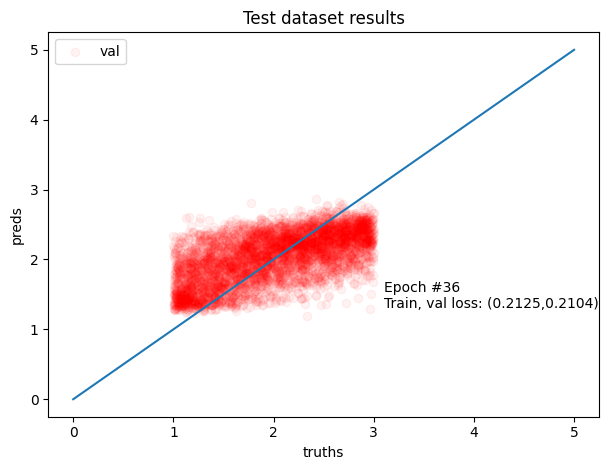

Epoch 37/300 - Train loss:	 0.2100
Epoch 37/300 - Validation MSE:	 0.2115



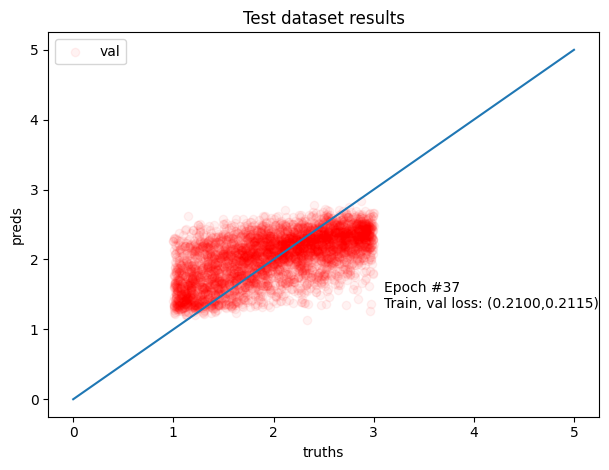

Epoch 38/300 - Train loss:	 0.2102
Epoch 38/300 - Validation MSE:	 0.2086



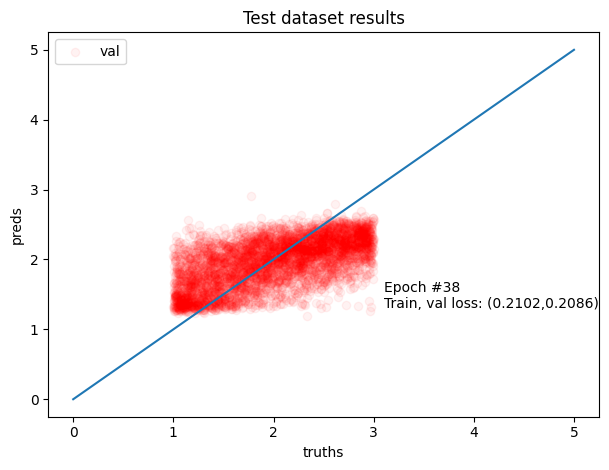

Epoch 39/300 - Train loss:	 0.2075
Epoch 39/300 - Validation MSE:	 0.2044



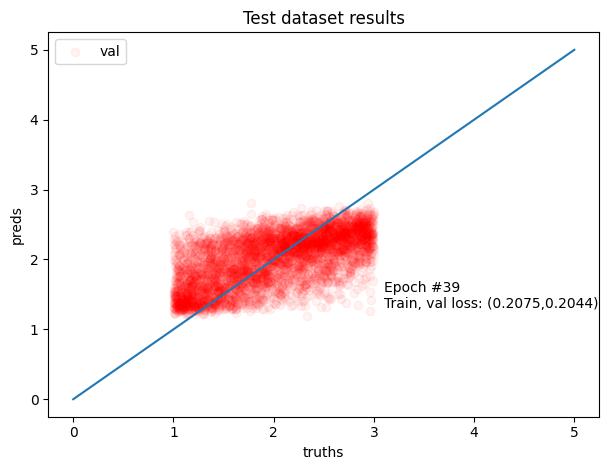

Epoch 40/300 - Train loss:	 0.2073
Epoch 40/300 - Validation MSE:	 0.2147



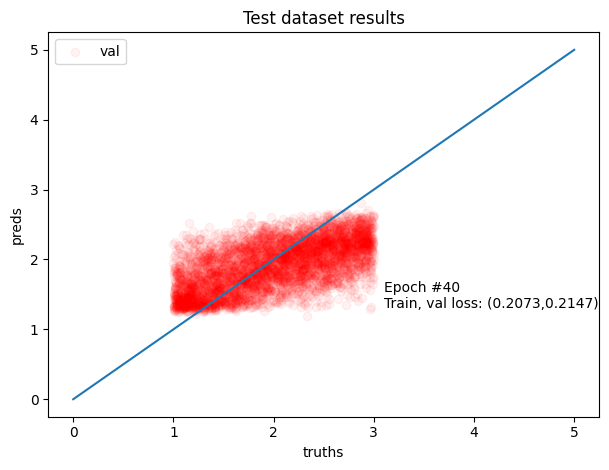

Epoch 41/300 - Train loss:	 0.2073
Epoch 41/300 - Validation MSE:	 0.2098



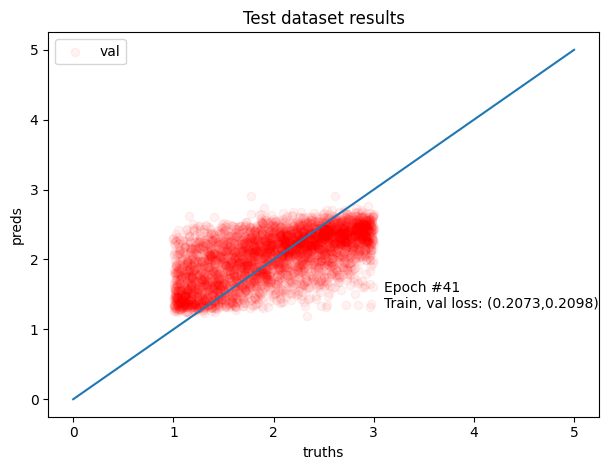

Epoch 42/300 - Train loss:	 0.2032
Epoch 42/300 - Validation MSE:	 0.2107



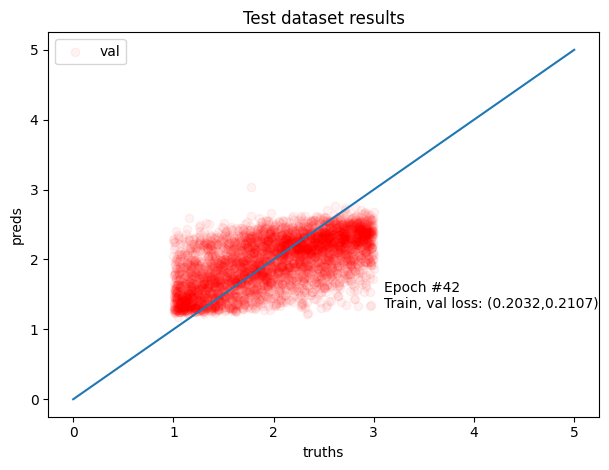

Epoch 43/300 - Train loss:	 0.2032
Epoch 43/300 - Validation MSE:	 0.2244



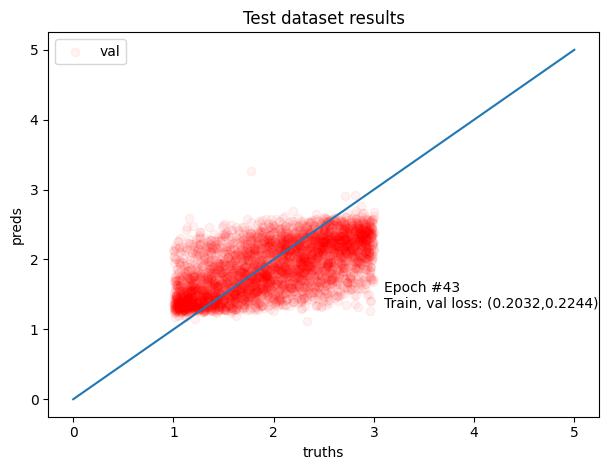

Epoch 44/300 - Train loss:	 0.2020
Epoch 44/300 - Validation MSE:	 0.2131



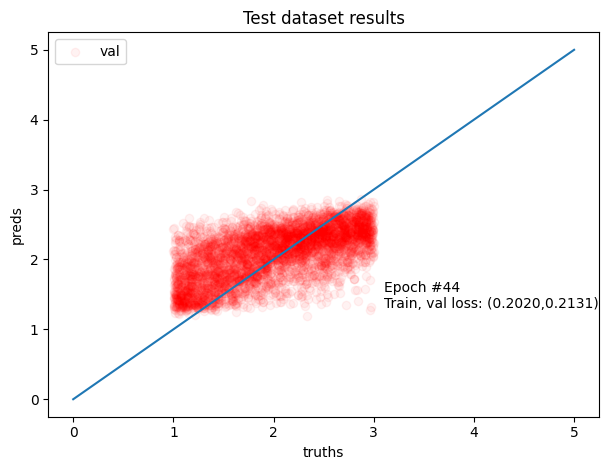

Epoch 45/300 - Train loss:	 0.1998
Epoch 45/300 - Validation MSE:	 0.2099



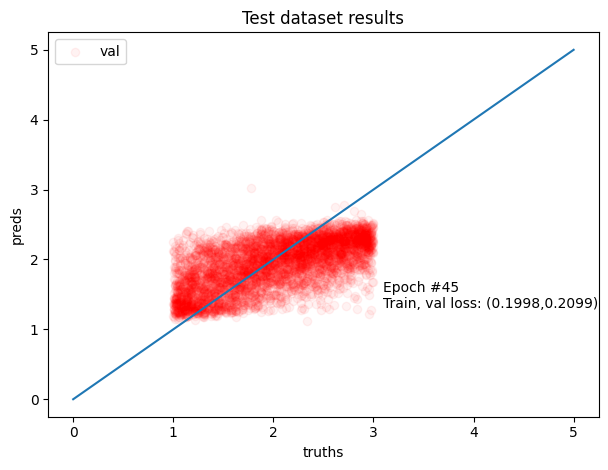

Epoch 46/300 - Train loss:	 0.1980
Epoch 46/300 - Validation MSE:	 0.2117



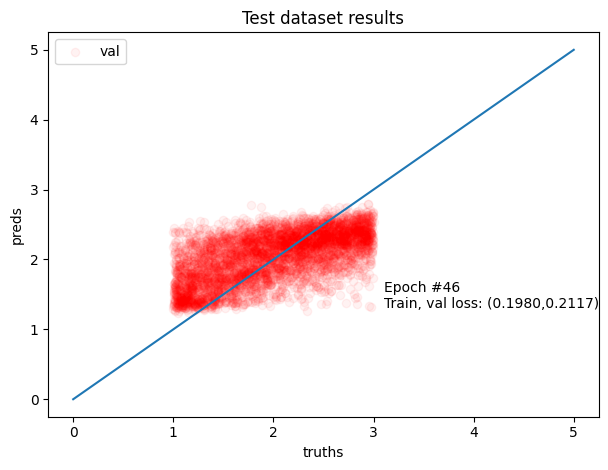

Epoch 47/300 - Train loss:	 0.1967
Epoch 47/300 - Validation MSE:	 0.2048



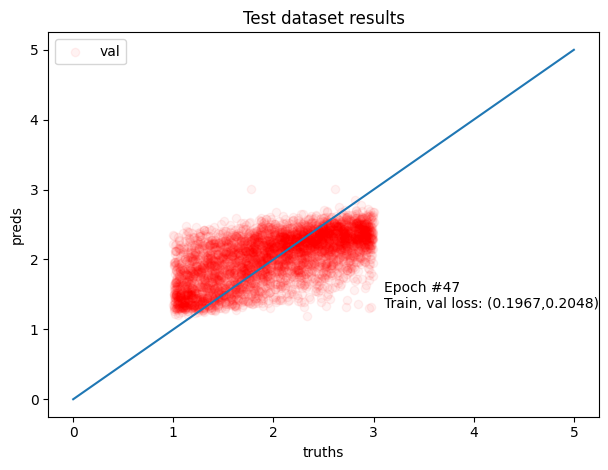

Epoch 48/300 - Train loss:	 0.1961
Epoch 48/300 - Validation MSE:	 0.2090



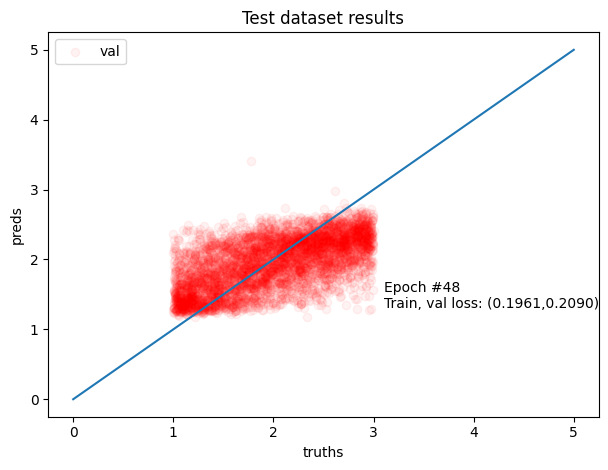

Epoch 49/300 - Train loss:	 0.1953
Epoch 49/300 - Validation MSE:	 0.1995



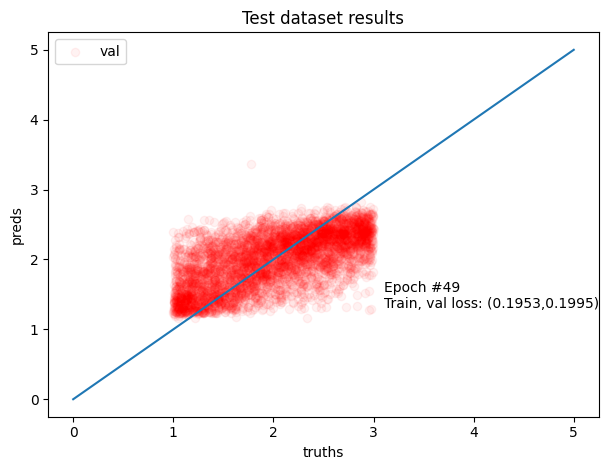

Epoch 50/300 - Train loss:	 0.1936
Epoch 50/300 - Validation MSE:	 0.2370



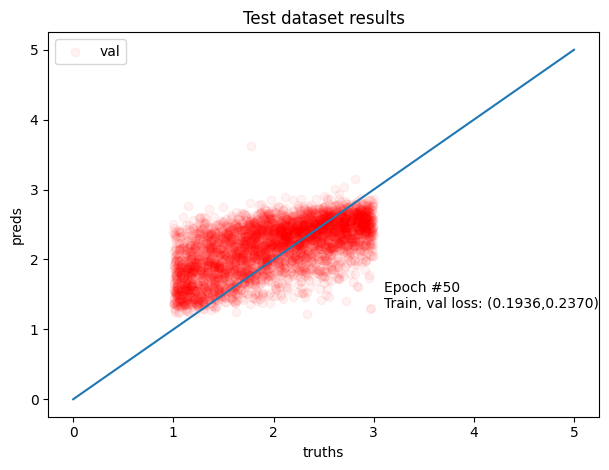

Epoch 51/300 - Train loss:	 0.1922
Epoch 51/300 - Validation MSE:	 0.2063



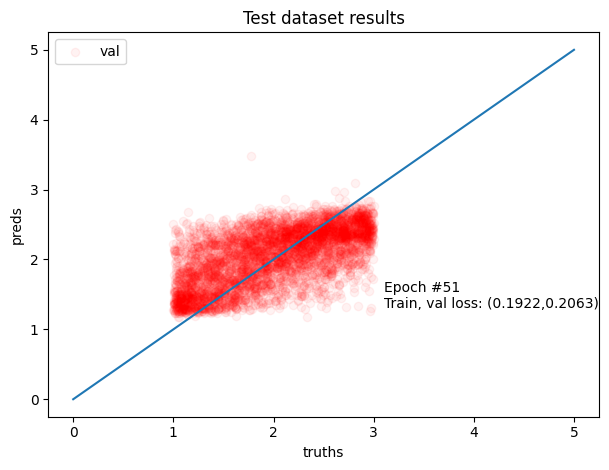

Epoch 52/300 - Train loss:	 0.1909
Epoch 52/300 - Validation MSE:	 0.2021



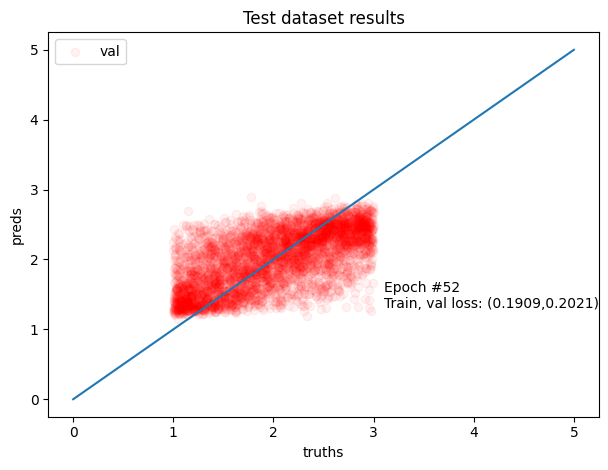

Epoch 53/300 - Train loss:	 0.1909
Epoch 53/300 - Validation MSE:	 0.2007



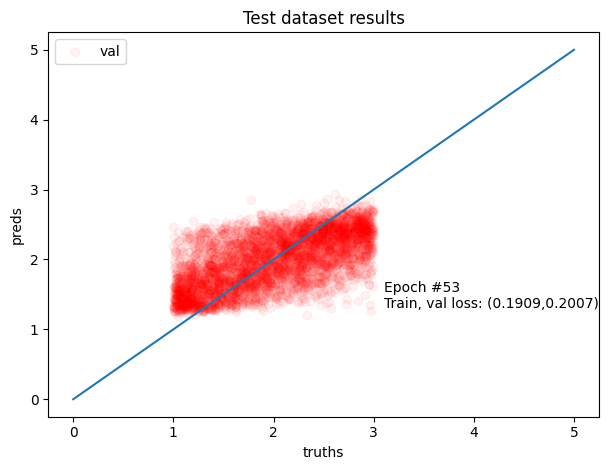

Epoch 54/300 - Train loss:	 0.1890
Epoch 54/300 - Validation MSE:	 0.2157



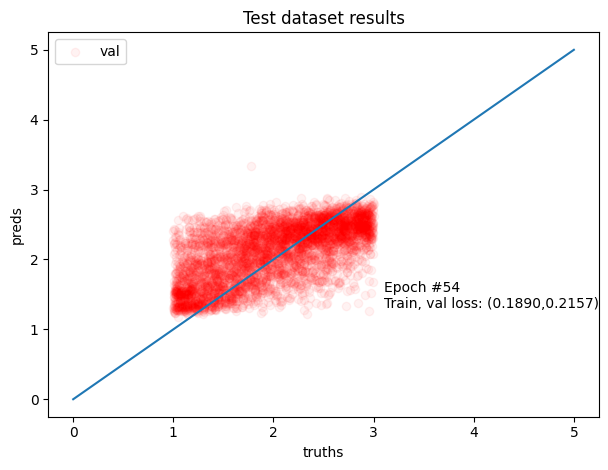

Epoch 55/300 - Train loss:	 0.1899
Epoch 55/300 - Validation MSE:	 0.1995



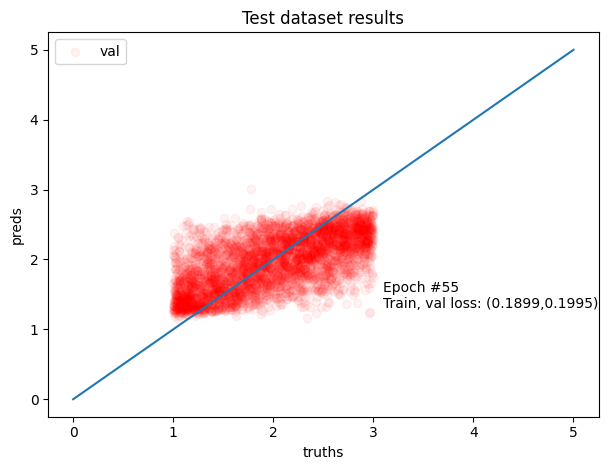

Epoch 56/300 - Train loss:	 0.1879
Epoch 56/300 - Validation MSE:	 0.2220



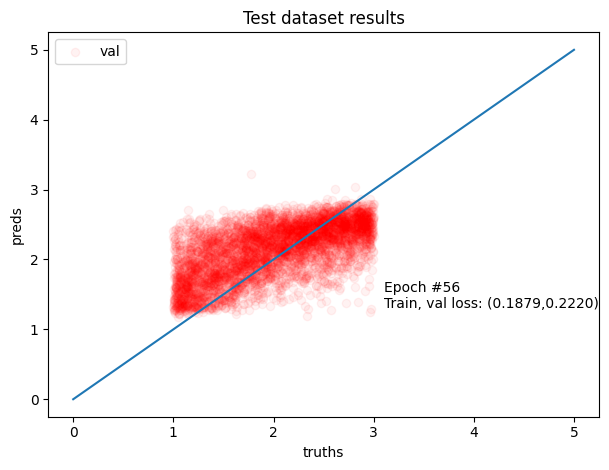

Epoch 57/300 - Train loss:	 0.1852
Epoch 57/300 - Validation MSE:	 0.1999



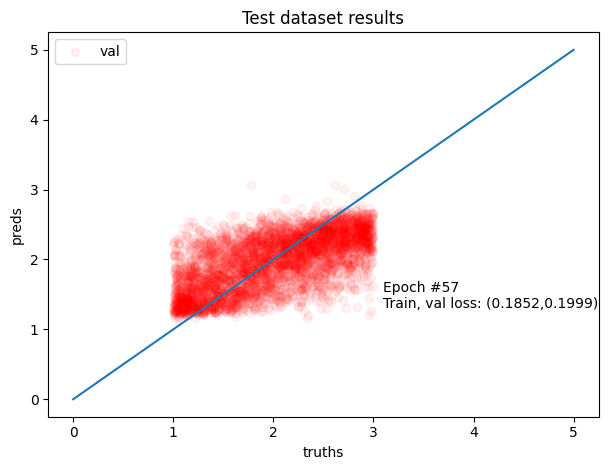

Epoch 58/300 - Train loss:	 0.1839
Epoch 58/300 - Validation MSE:	 0.2168



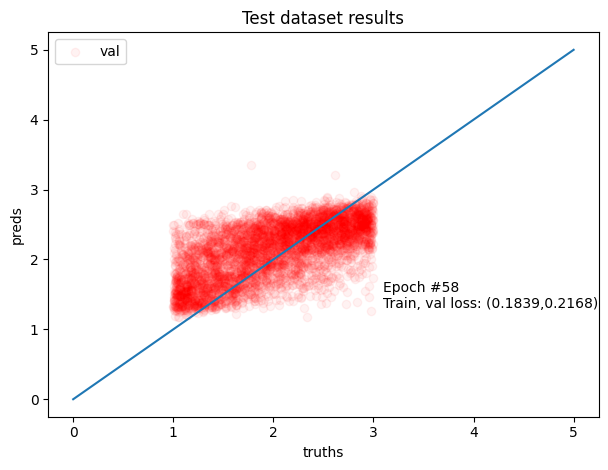

Epoch 59/300 - Train loss:	 0.1833
Epoch 59/300 - Validation MSE:	 0.2043



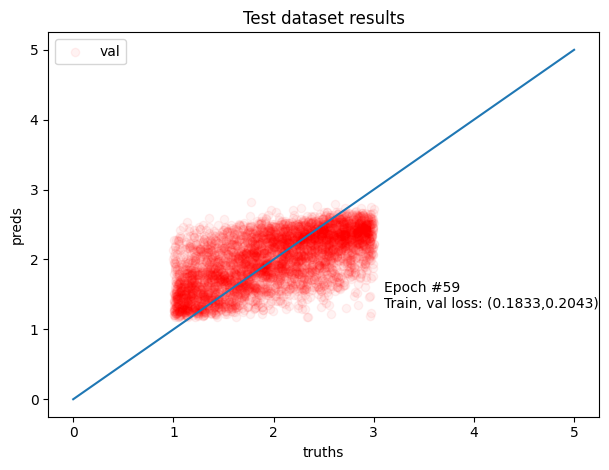

Epoch 60/300 - Train loss:	 0.1831
Epoch 60/300 - Validation MSE:	 0.2048



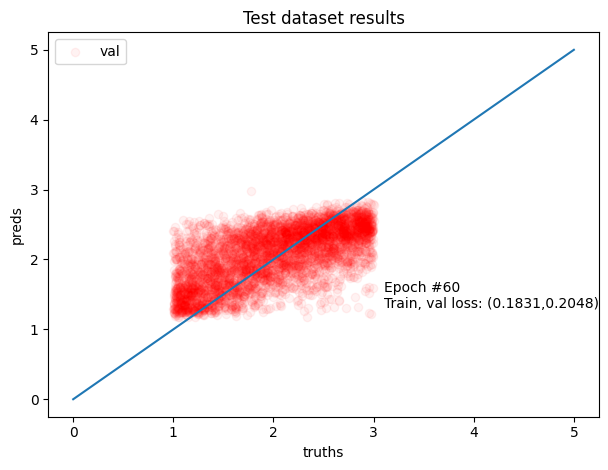

Epoch 61/300 - Train loss:	 0.1802
Epoch 61/300 - Validation MSE:	 0.2228



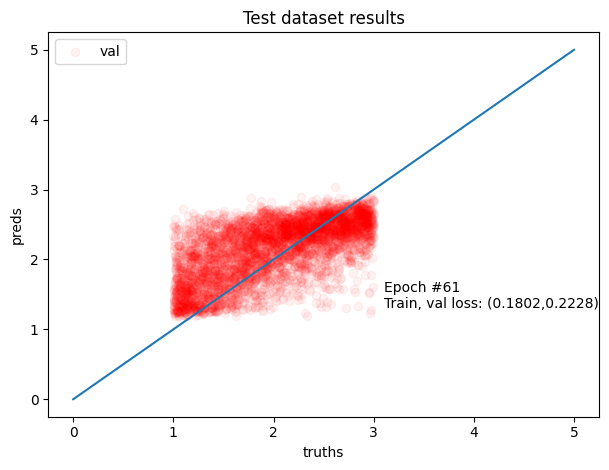

Epoch 62/300 - Train loss:	 0.1813
Epoch 62/300 - Validation MSE:	 0.2050



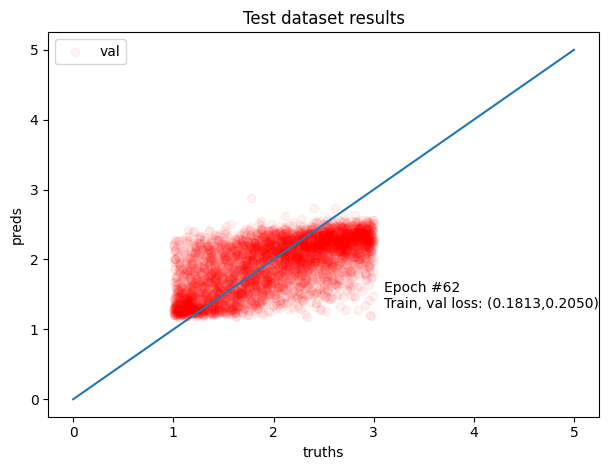

Epoch 63/300 - Train loss:	 0.1804
Epoch 63/300 - Validation MSE:	 0.2058



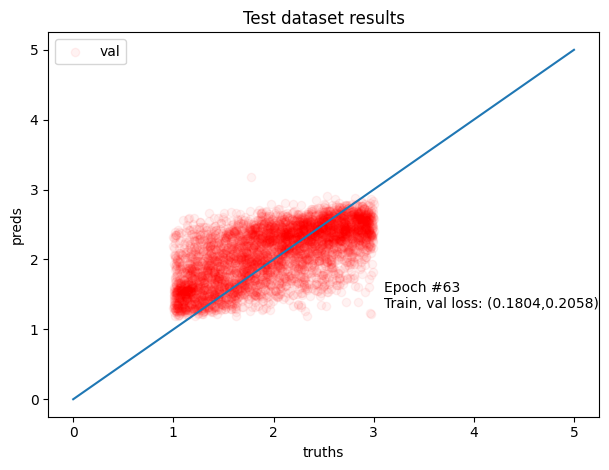

Epoch 64/300 - Train loss:	 0.1784
Epoch 64/300 - Validation MSE:	 0.2063



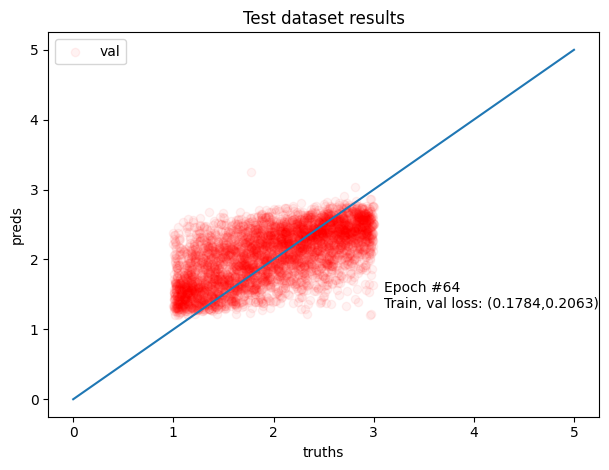

Epoch 65/300 - Train loss:	 0.1788
Epoch 65/300 - Validation MSE:	 0.2136



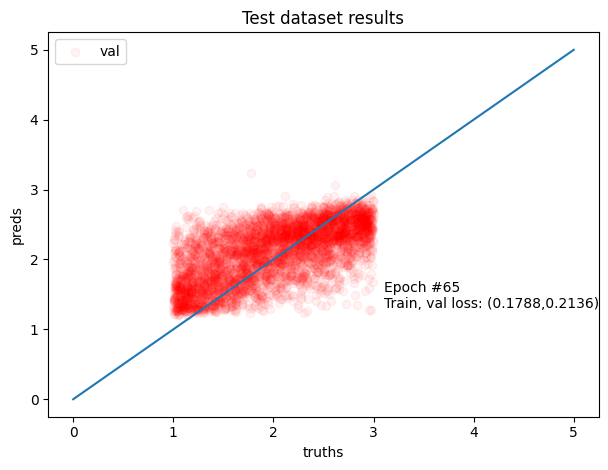

Epoch 66/300 - Train loss:	 0.1769
Epoch 66/300 - Validation MSE:	 0.1988



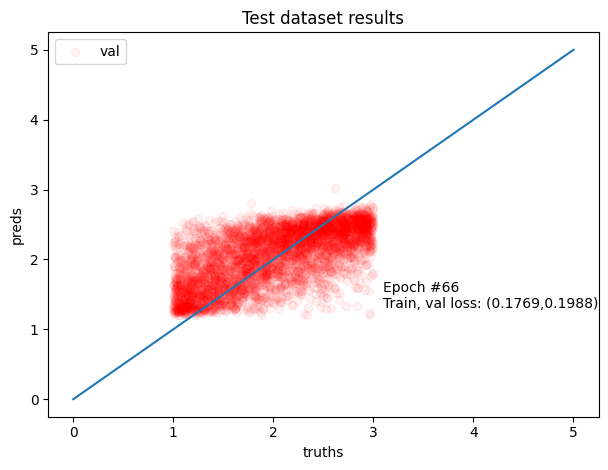

Epoch 67/300 - Train loss:	 0.1765
Epoch 67/300 - Validation MSE:	 0.2012



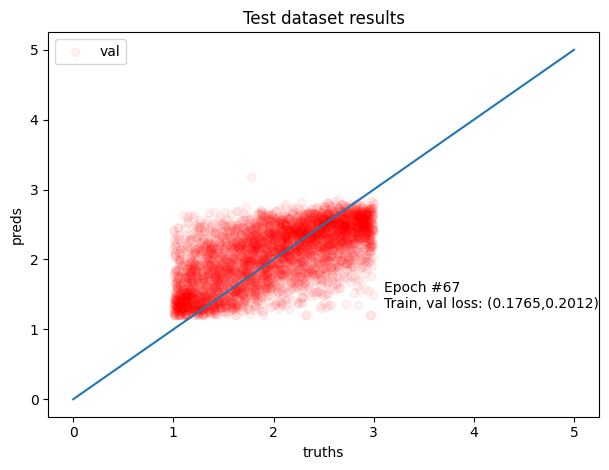

Epoch 68/300 - Train loss:	 0.1757
Epoch 68/300 - Validation MSE:	 0.1995



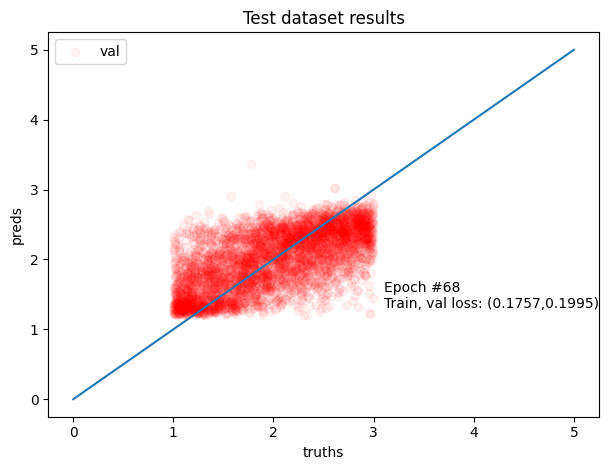

Epoch 69/300 - Train loss:	 0.1727
Epoch 69/300 - Validation MSE:	 0.1969



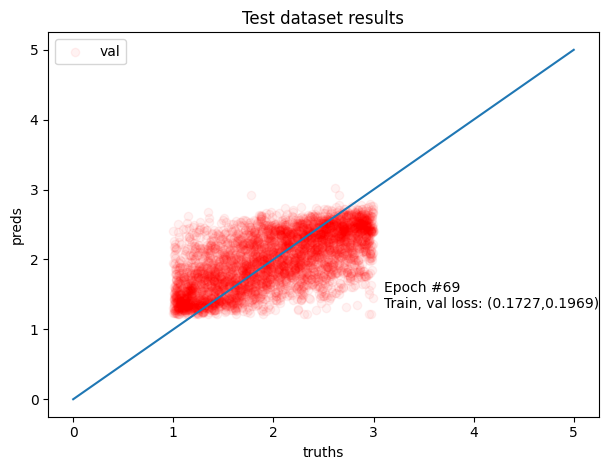

Epoch 70/300 - Train loss:	 0.1733
Epoch 70/300 - Validation MSE:	 0.2018



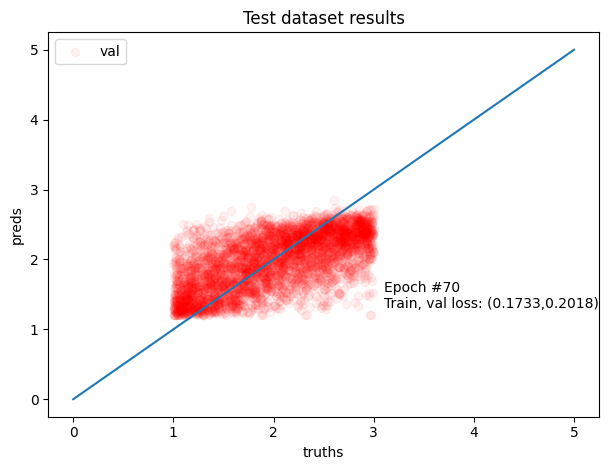

Epoch 71/300 - Train loss:	 0.1730
Epoch 71/300 - Validation MSE:	 0.1976



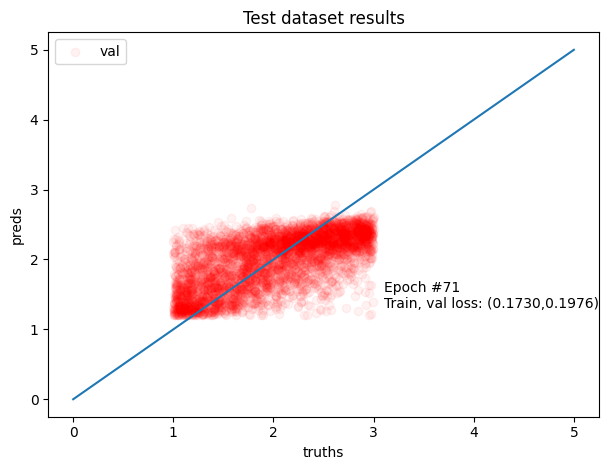

Epoch 72/300 - Train loss:	 0.1705
Epoch 72/300 - Validation MSE:	 0.2089



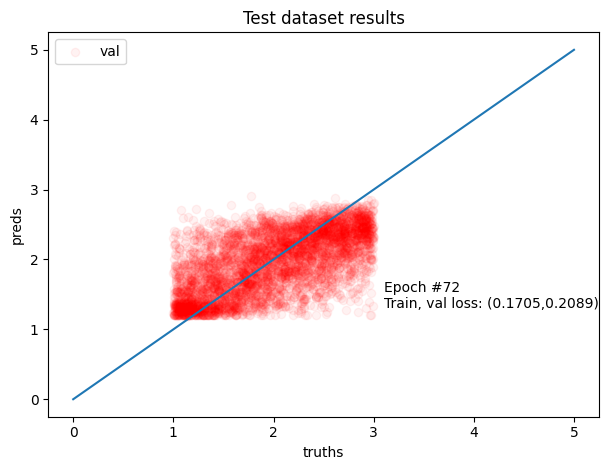

Epoch 73/300 - Train loss:	 0.1698
Epoch 73/300 - Validation MSE:	 0.2196



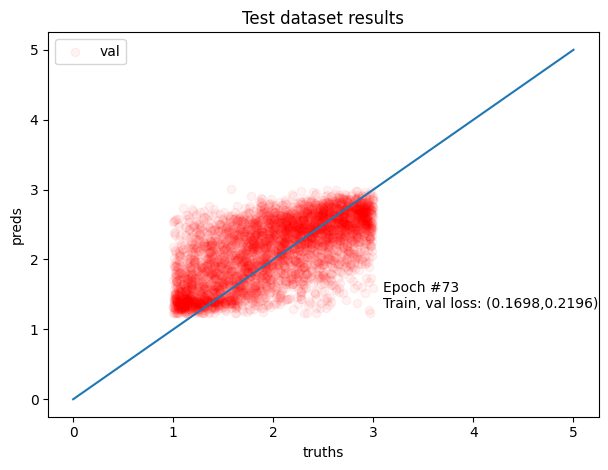

Epoch 74/300 - Train loss:	 0.1690
Epoch 74/300 - Validation MSE:	 0.2040



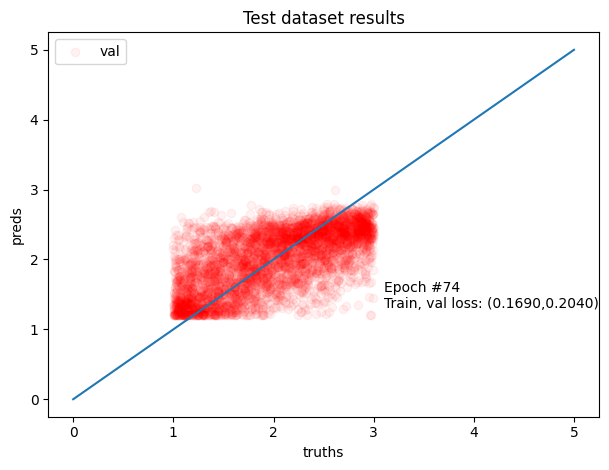

Epoch 75/300 - Train loss:	 0.1686
Epoch 75/300 - Validation MSE:	 0.2160



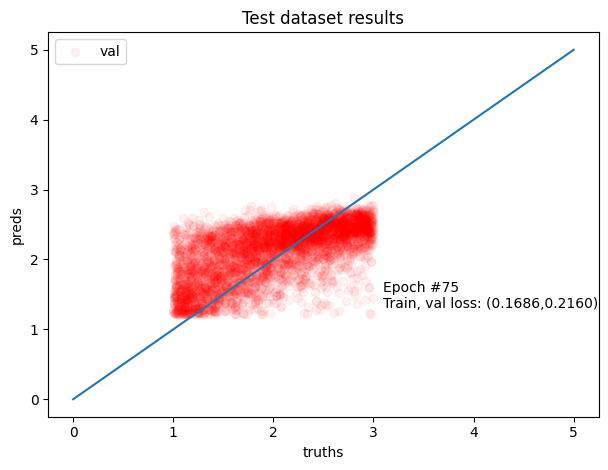

Epoch 76/300 - Train loss:	 0.1666
Epoch 76/300 - Validation MSE:	 0.2041



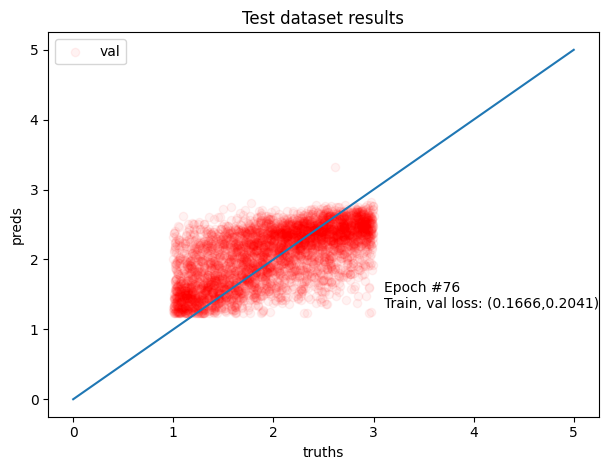

Epoch 77/300 - Train loss:	 0.1660
Epoch 77/300 - Validation MSE:	 0.2062



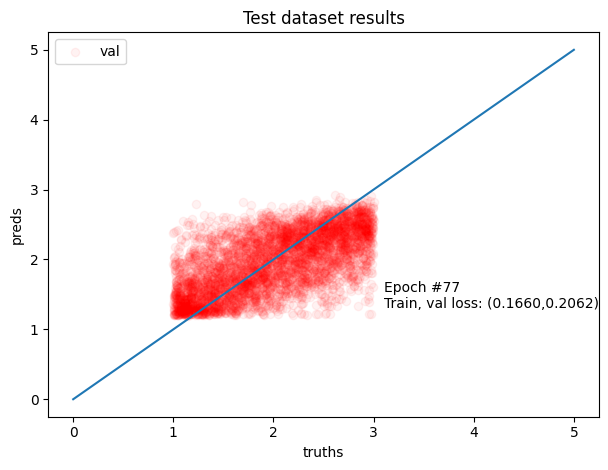

Epoch 78/300 - Train loss:	 0.1644
Epoch 78/300 - Validation MSE:	 0.2055



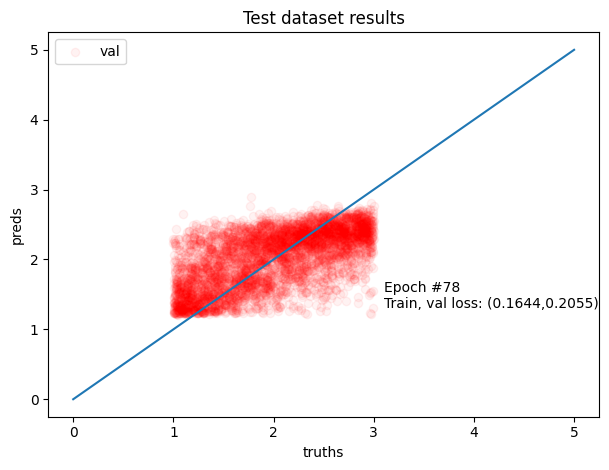

Epoch 79/300 - Train loss:	 0.1646
Epoch 79/300 - Validation MSE:	 0.2135



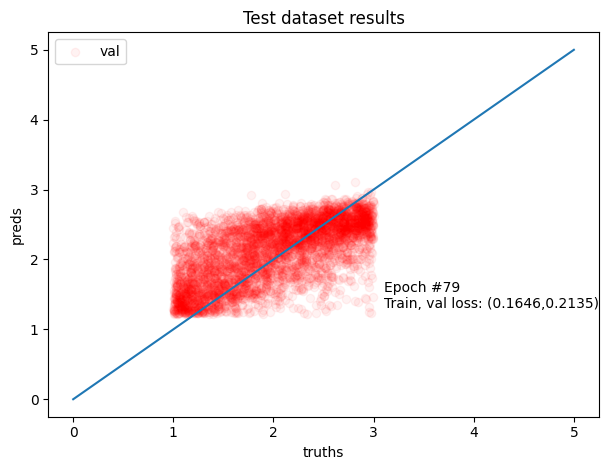

Epoch 80/300 - Train loss:	 0.1636
Epoch 80/300 - Validation MSE:	 0.2170



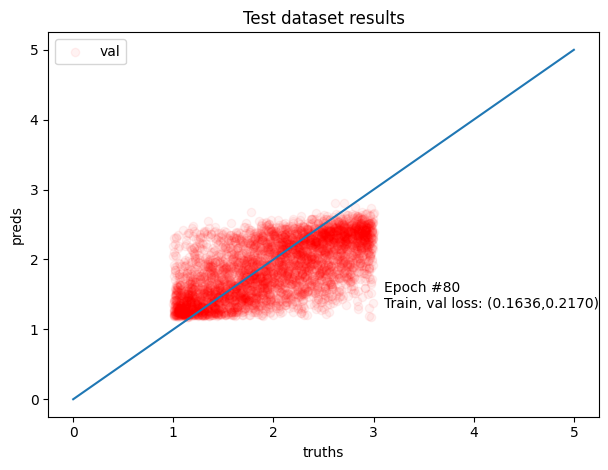

Epoch 81/300 - Train loss:	 0.1607
Epoch 81/300 - Validation MSE:	 0.2033



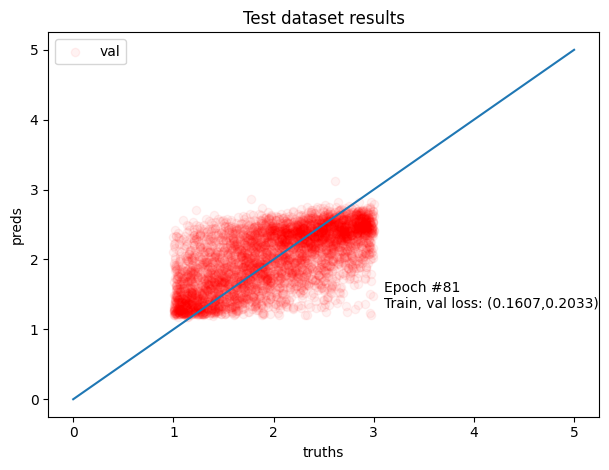

Epoch 82/300 - Train loss:	 0.1610
Epoch 82/300 - Validation MSE:	 0.2067



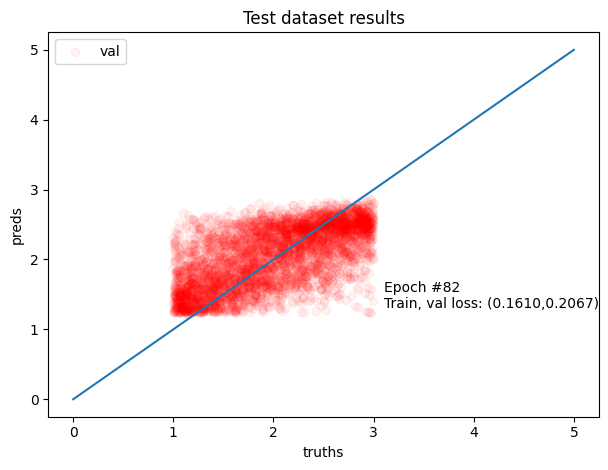

Epoch 83/300 - Train loss:	 0.1575
Epoch 83/300 - Validation MSE:	 0.2029



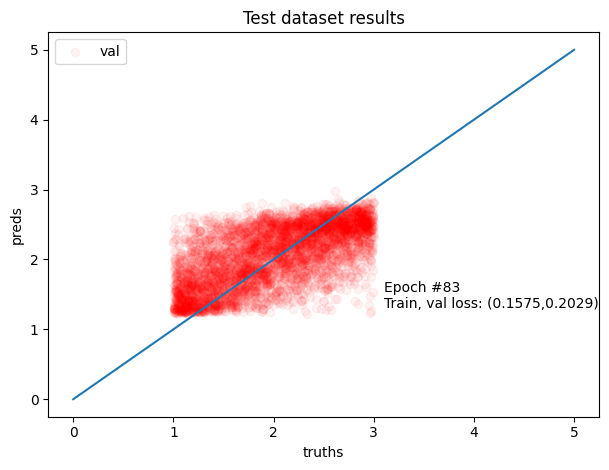

Epoch 84/300 - Train loss:	 0.1595
Epoch 84/300 - Validation MSE:	 0.2013



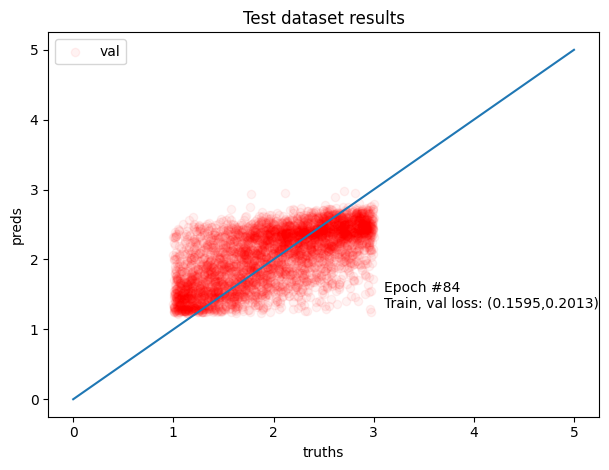

Epoch 85/300 - Train loss:	 0.1568
Epoch 85/300 - Validation MSE:	 0.2009



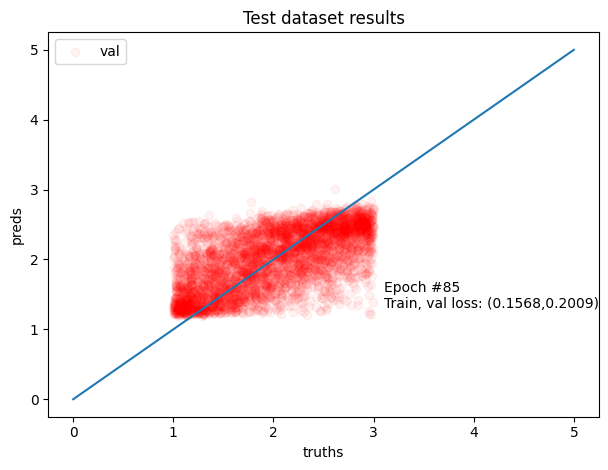

Epoch 86/300 - Train loss:	 0.1563
Epoch 86/300 - Validation MSE:	 0.2155



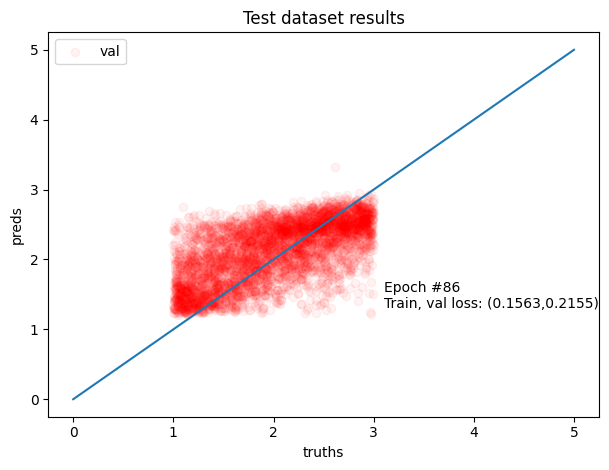

Epoch 87/300 - Train loss:	 0.1543
Epoch 87/300 - Validation MSE:	 0.1977



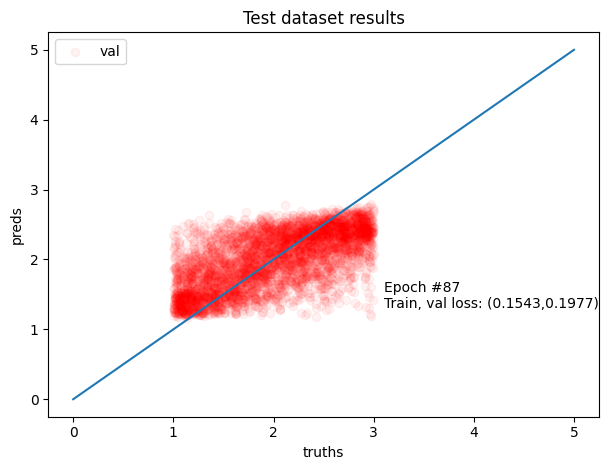

Epoch 88/300 - Train loss:	 0.1543
Epoch 88/300 - Validation MSE:	 0.2083



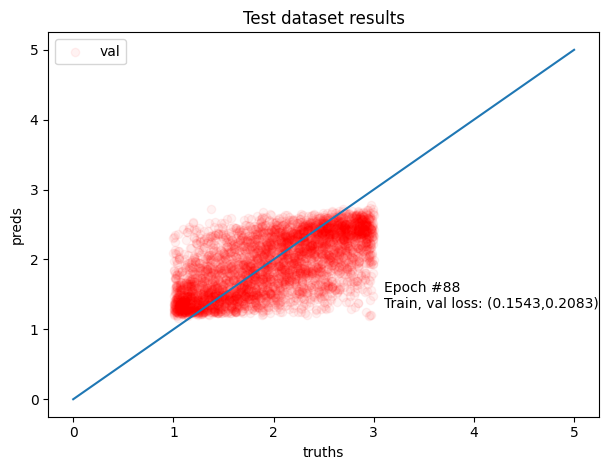

Epoch 89/300 - Train loss:	 0.1538
Epoch 89/300 - Validation MSE:	 0.2156



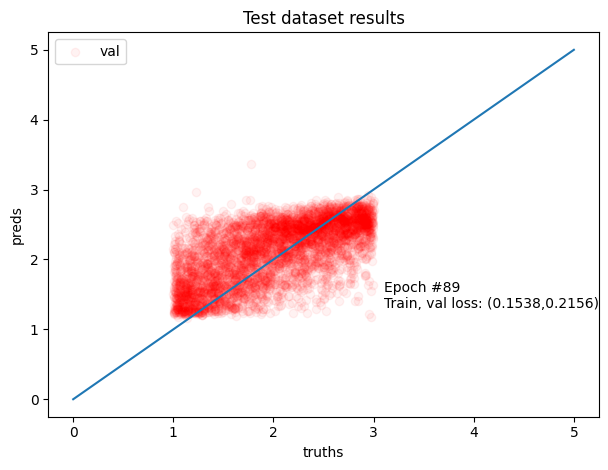

Epoch 90/300 - Train loss:	 0.1520
Epoch 90/300 - Validation MSE:	 0.2047



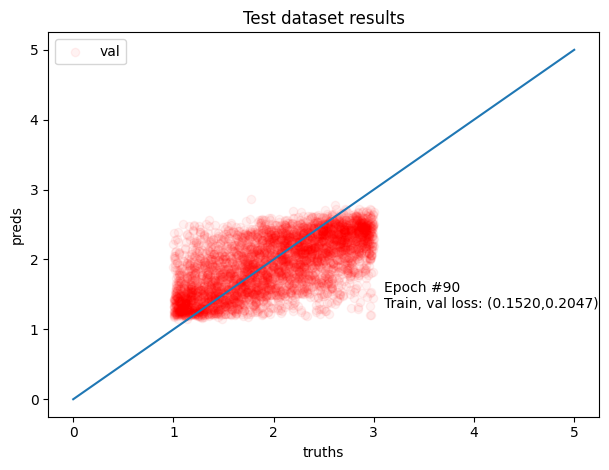

Epoch 91/300 - Train loss:	 0.1506
Epoch 91/300 - Validation MSE:	 0.2027



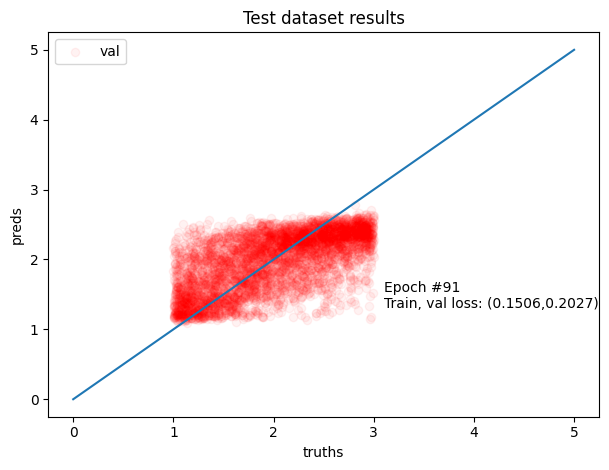

Epoch 92/300 - Train loss:	 0.1498
Epoch 92/300 - Validation MSE:	 0.2021



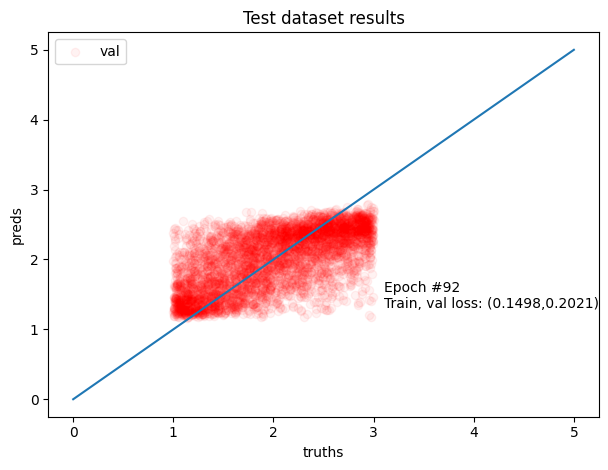

Epoch 93/300 - Train loss:	 0.1490
Epoch 93/300 - Validation MSE:	 0.1966



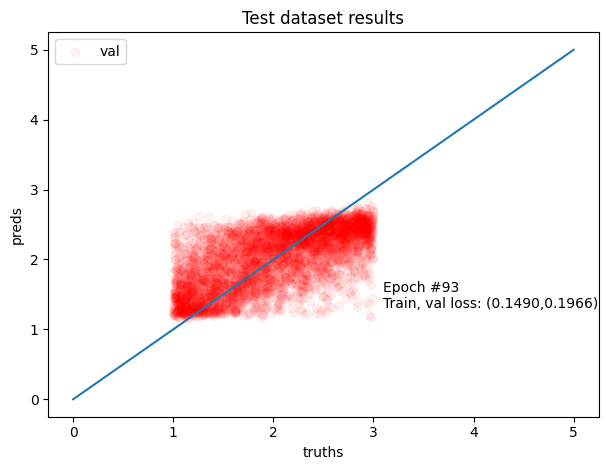

Epoch 94/300 - Train loss:	 0.1466
Epoch 94/300 - Validation MSE:	 0.2005



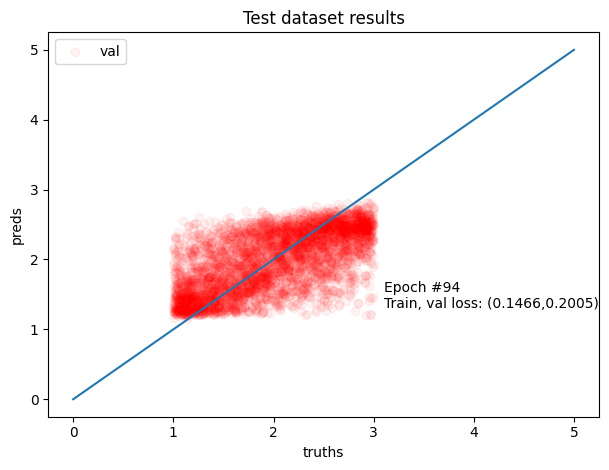

Epoch 95/300 - Train loss:	 0.1451
Epoch 95/300 - Validation MSE:	 0.2013



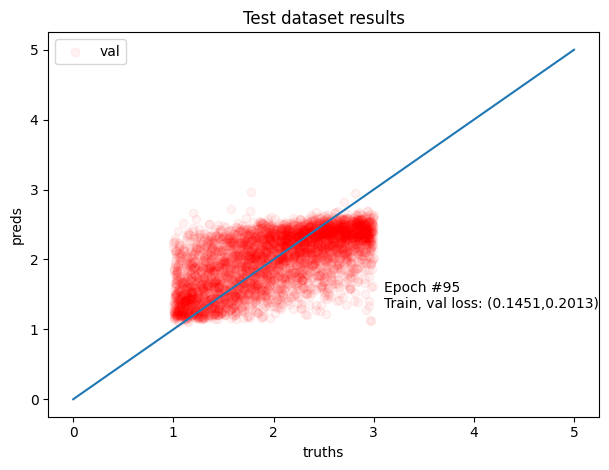

Epoch 96/300 - Train loss:	 0.1470
Epoch 96/300 - Validation MSE:	 0.2064



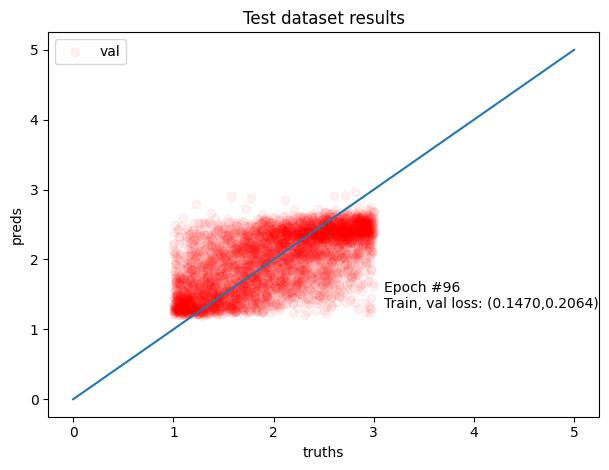

Epoch 97/300 - Train loss:	 0.1439
Epoch 97/300 - Validation MSE:	 0.2138



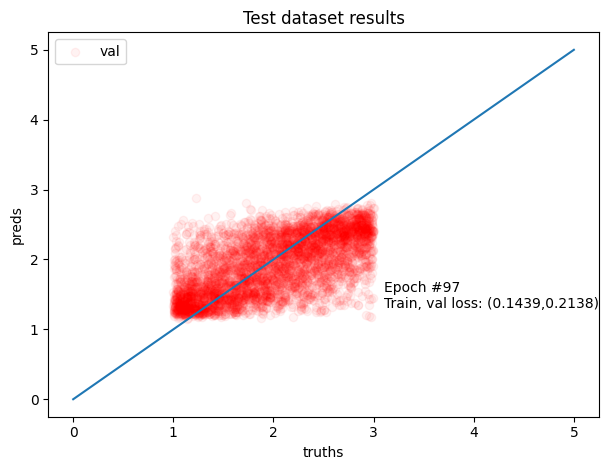

Epoch 98/300 - Train loss:	 0.1427
Epoch 98/300 - Validation MSE:	 0.2045



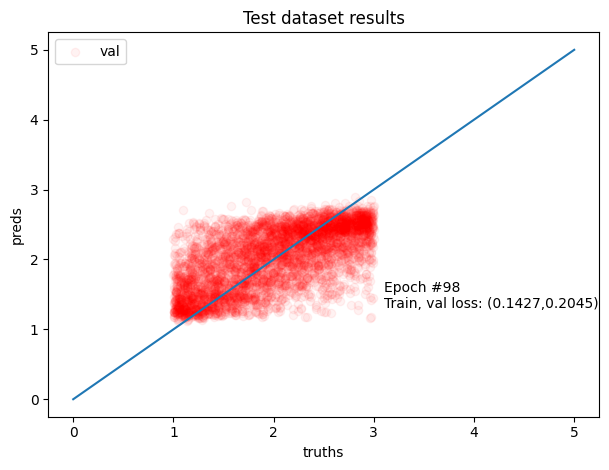

Epoch 99/300 - Train loss:	 0.1431
Epoch 99/300 - Validation MSE:	 0.2044



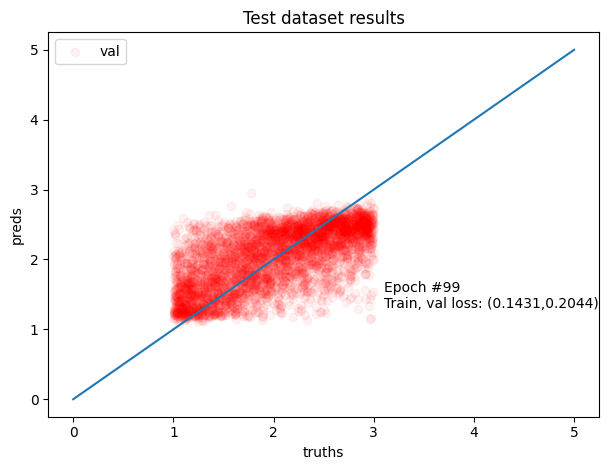

Epoch 100/300 - Train loss:	 0.1403
Epoch 100/300 - Validation MSE:	 0.2039



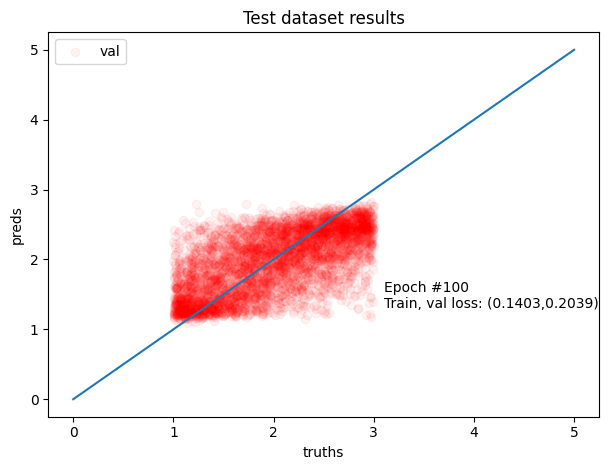

Epoch 101/300 - Train loss:	 0.1401
Epoch 101/300 - Validation MSE:	 0.2108



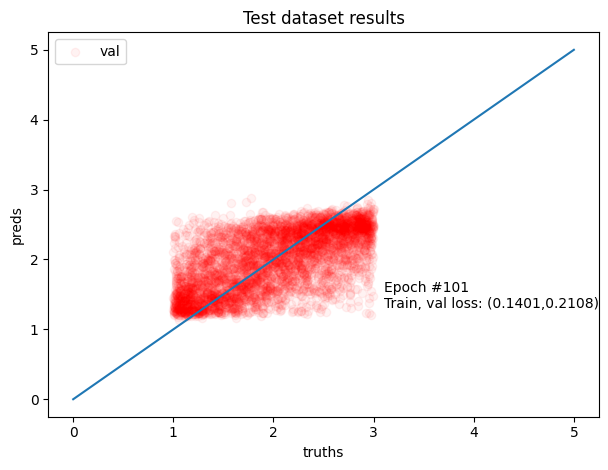

Epoch 102/300 - Train loss:	 0.1392
Epoch 102/300 - Validation MSE:	 0.2191



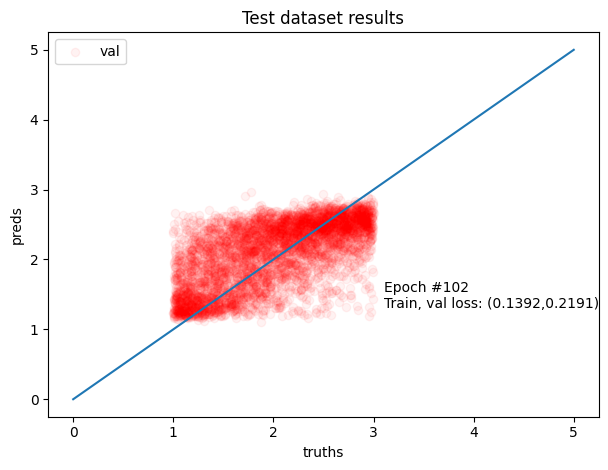

Epoch 103/300 - Train loss:	 0.1384
Epoch 103/300 - Validation MSE:	 0.2086



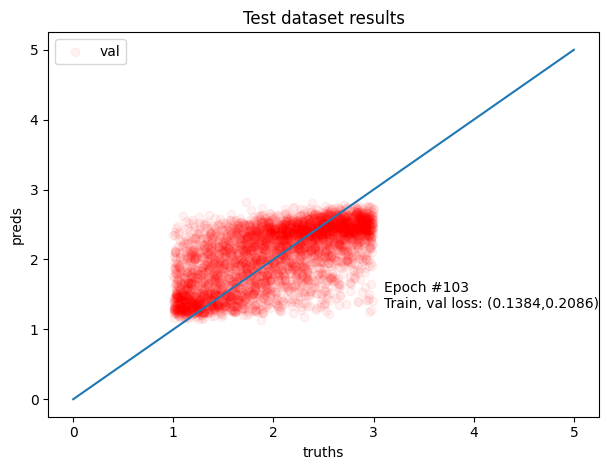

Epoch 104/300 - Train loss:	 0.1371
Epoch 104/300 - Validation MSE:	 0.2067



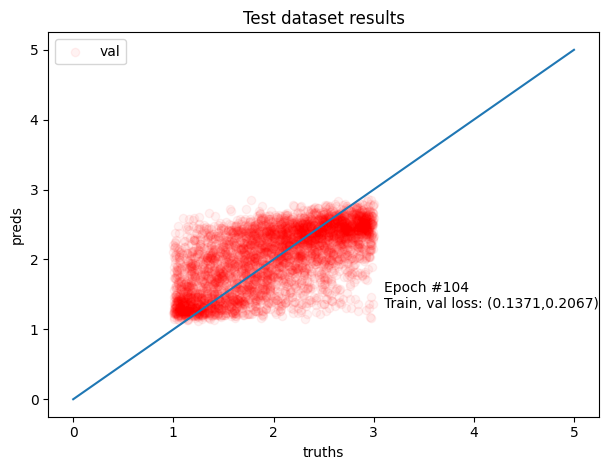

Epoch 105/300 - Train loss:	 0.1363
Epoch 105/300 - Validation MSE:	 0.2116



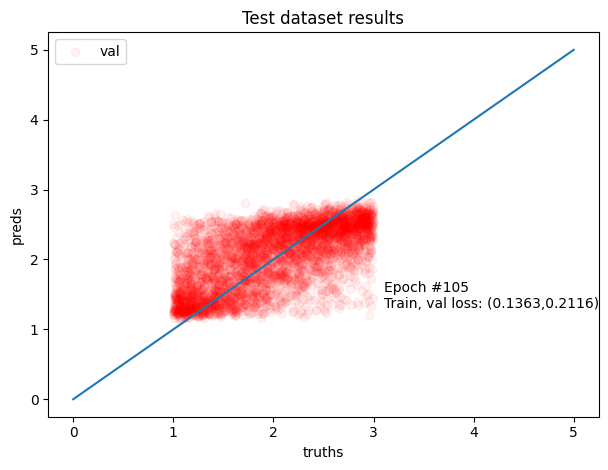

Epoch 106/300 - Train loss:	 0.1346
Epoch 106/300 - Validation MSE:	 0.2038



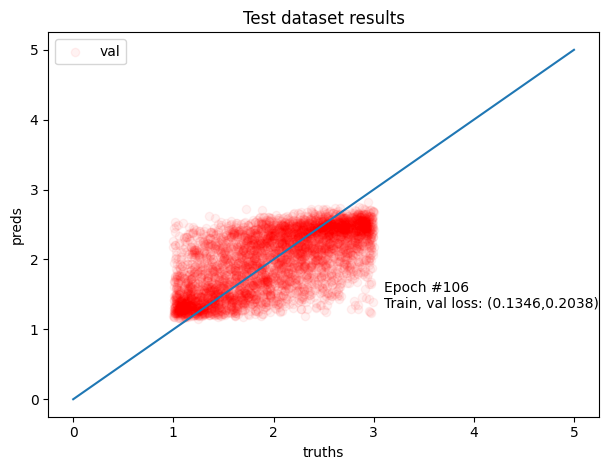

Epoch 107/300 - Train loss:	 0.1341
Epoch 107/300 - Validation MSE:	 0.2116



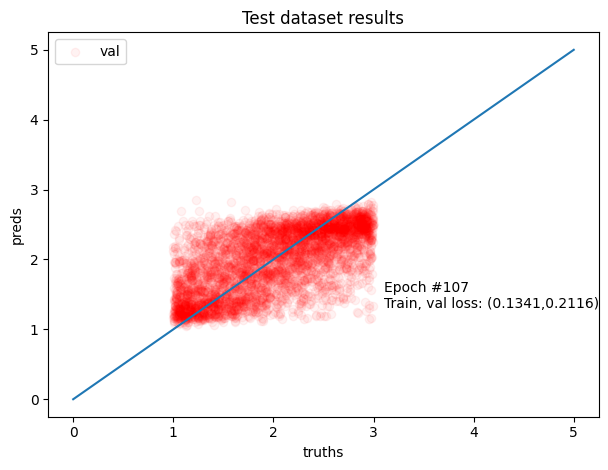

Epoch 108/300 - Train loss:	 0.1327
Epoch 108/300 - Validation MSE:	 0.2093



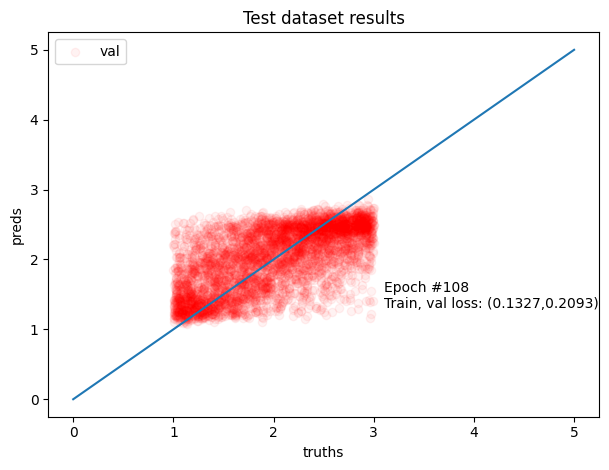

Epoch 109/300 - Train loss:	 0.1311
Epoch 109/300 - Validation MSE:	 0.2095



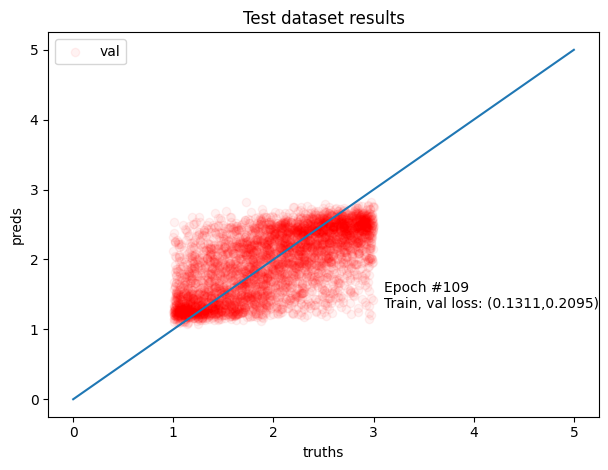

Epoch 110/300 - Train loss:	 0.1311
Epoch 110/300 - Validation MSE:	 0.2069



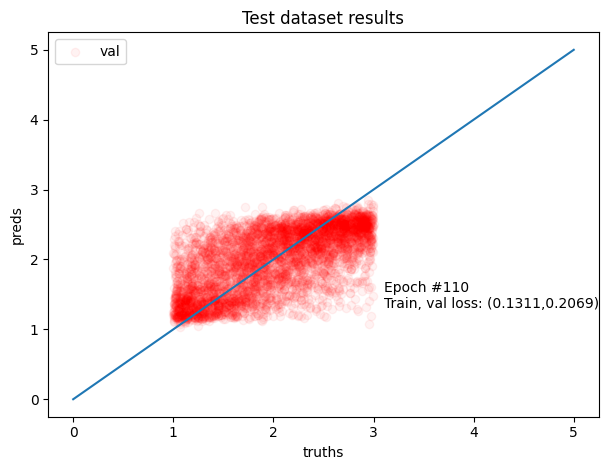

Epoch 111/300 - Train loss:	 0.1293
Epoch 111/300 - Validation MSE:	 0.2155



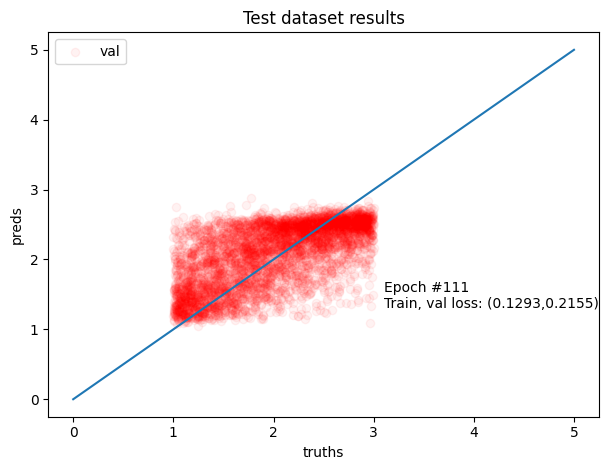

Epoch 112/300 - Train loss:	 0.1278
Epoch 112/300 - Validation MSE:	 0.2121



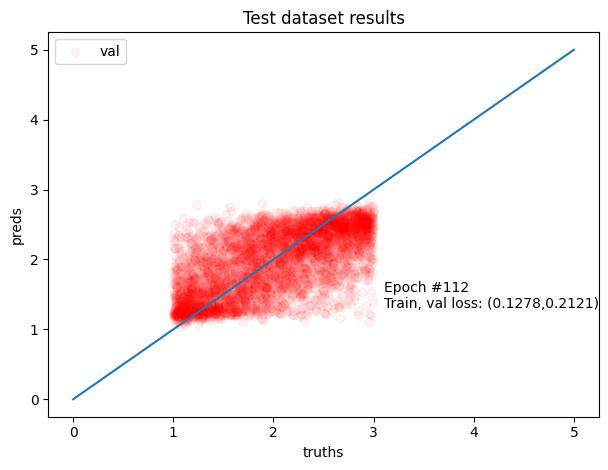

Epoch 113/300 - Train loss:	 0.1283
Epoch 113/300 - Validation MSE:	 0.2190



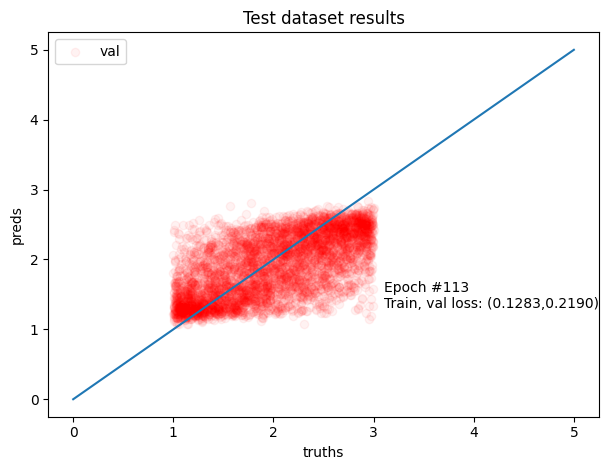

Epoch 114/300 - Train loss:	 0.1262
Epoch 114/300 - Validation MSE:	 0.2149



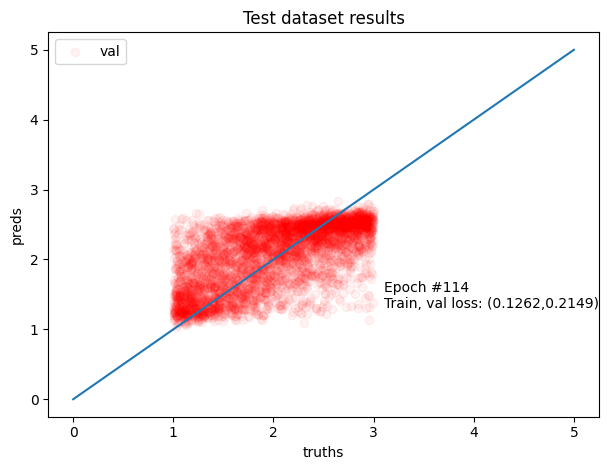

Epoch 115/300 - Train loss:	 0.1250
Epoch 115/300 - Validation MSE:	 0.2194



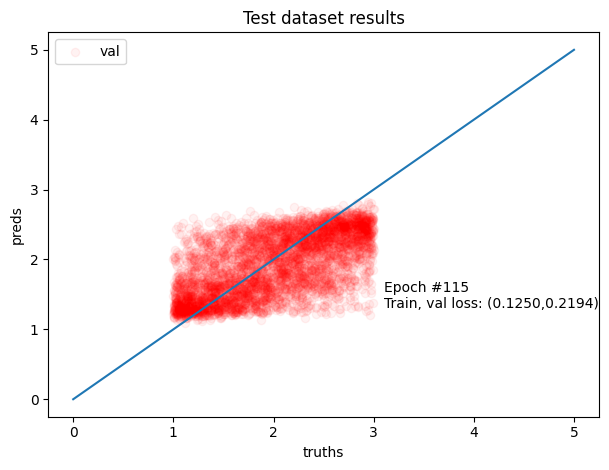

Epoch 116/300 - Train loss:	 0.1247
Epoch 116/300 - Validation MSE:	 0.2128



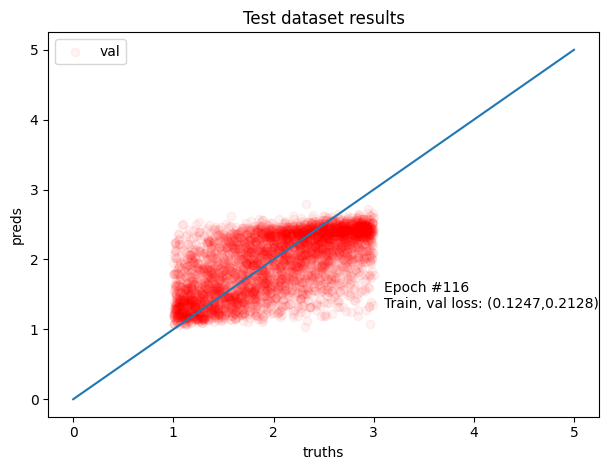

Epoch 117/300 - Train loss:	 0.1234
Epoch 117/300 - Validation MSE:	 0.2099



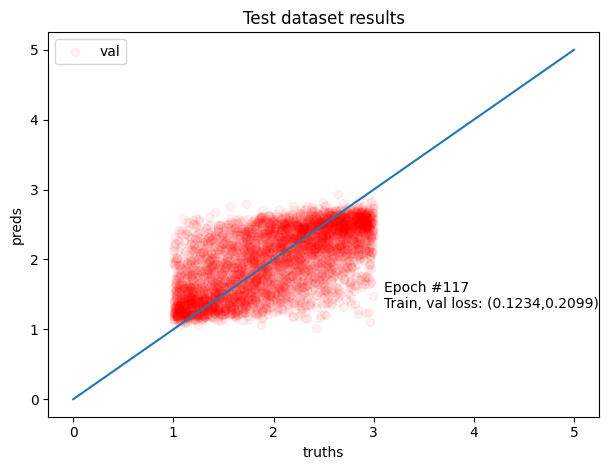

Epoch 118/300 - Train loss:	 0.1206
Epoch 118/300 - Validation MSE:	 0.2119



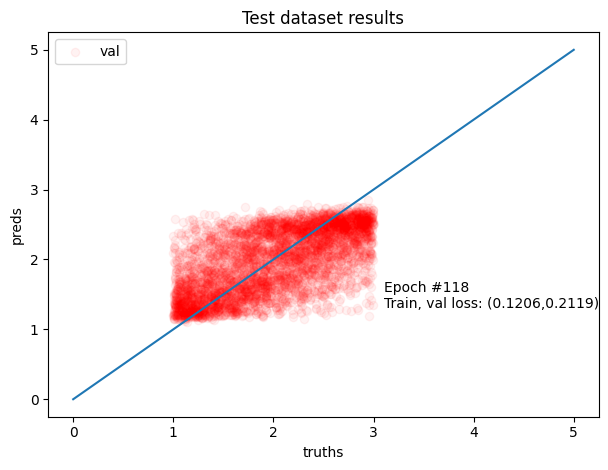

Epoch 119/300 - Train loss:	 0.1233
Epoch 119/300 - Validation MSE:	 0.2145



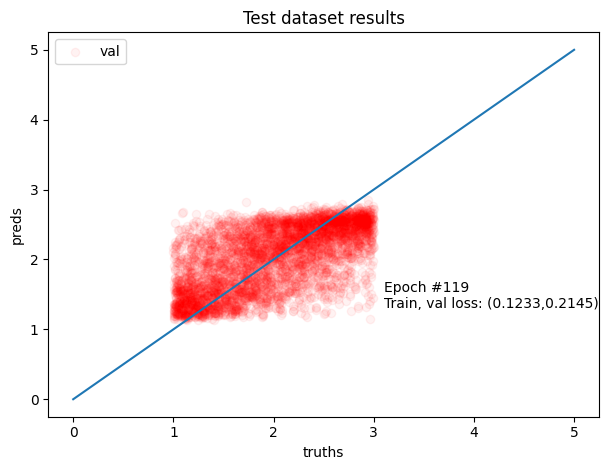

Epoch 120/300 - Train loss:	 0.1210
Epoch 120/300 - Validation MSE:	 0.2184



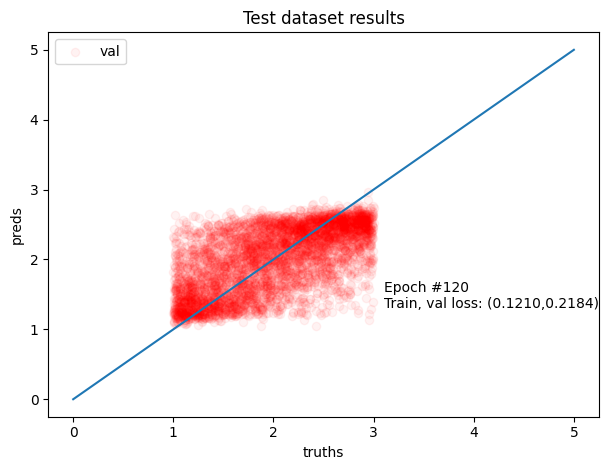

Epoch 121/300 - Train loss:	 0.1197
Epoch 121/300 - Validation MSE:	 0.2237



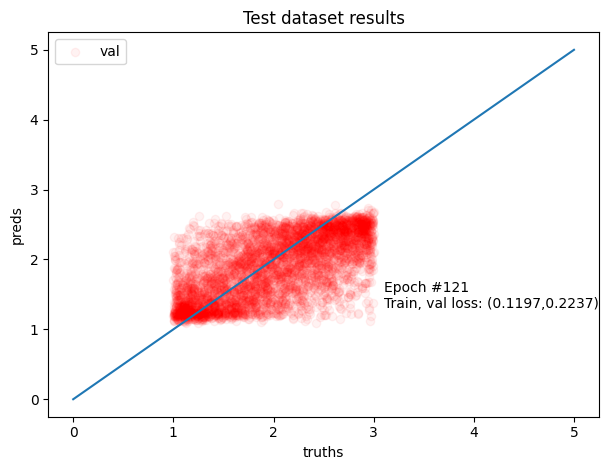

Epoch 122/300 - Train loss:	 0.1183
Epoch 122/300 - Validation MSE:	 0.2157



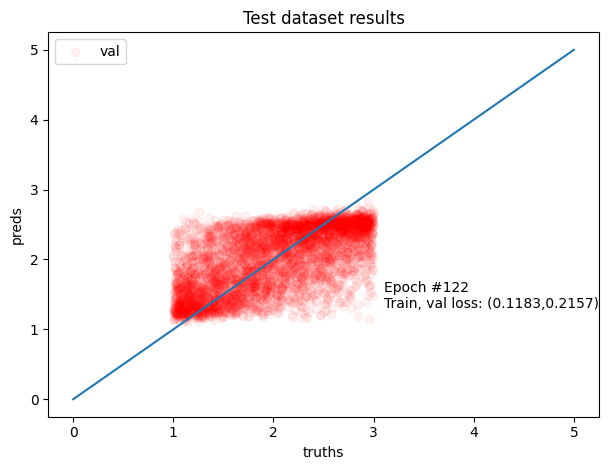

Epoch 123/300 - Train loss:	 0.1179
Epoch 123/300 - Validation MSE:	 0.2200



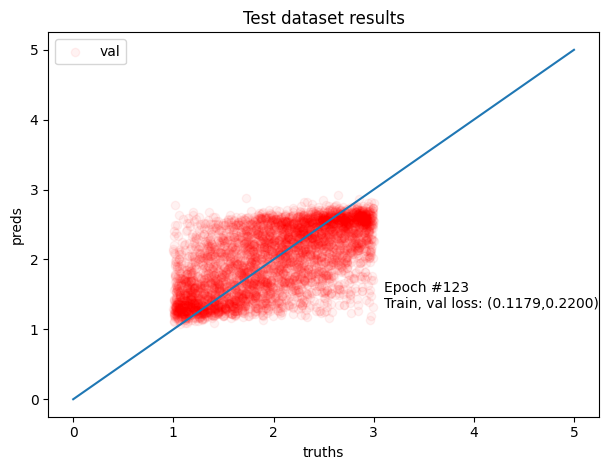

Epoch 124/300 - Train loss:	 0.1180
Epoch 124/300 - Validation MSE:	 0.2189



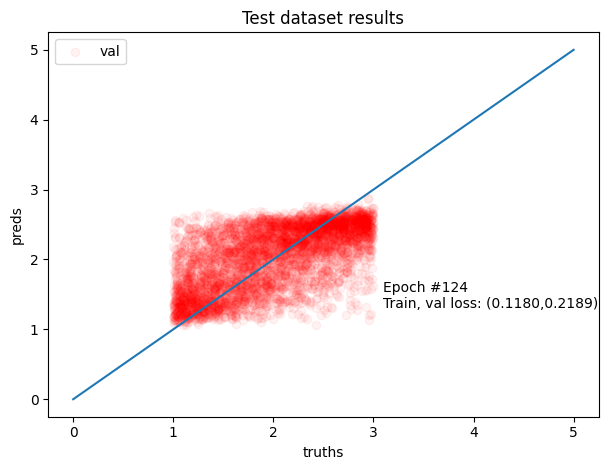

Epoch 125/300 - Train loss:	 0.1163
Epoch 125/300 - Validation MSE:	 0.2186



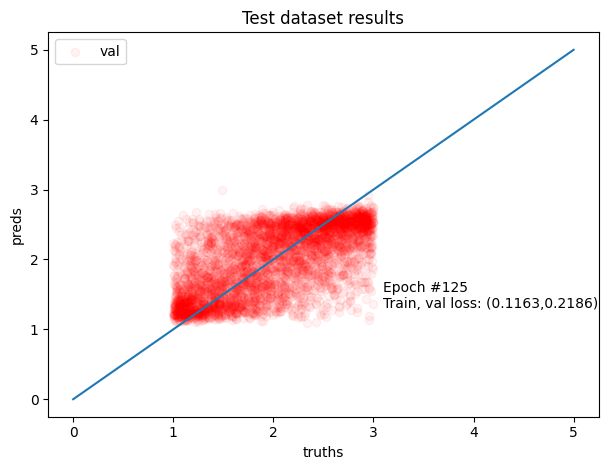

Epoch 126/300 - Train loss:	 0.1138
Epoch 126/300 - Validation MSE:	 0.2172



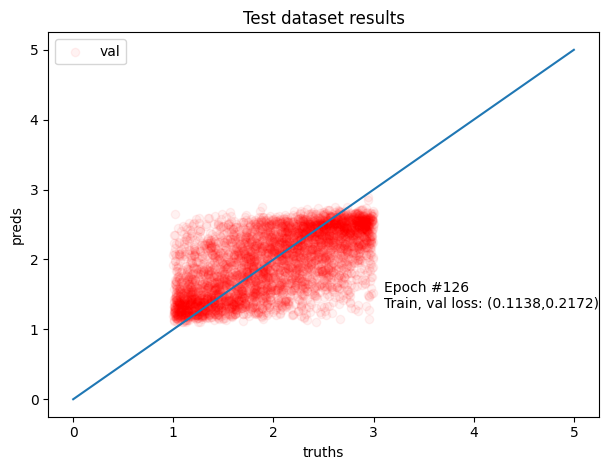

Epoch 127/300 - Train loss:	 0.1144
Epoch 127/300 - Validation MSE:	 0.2208



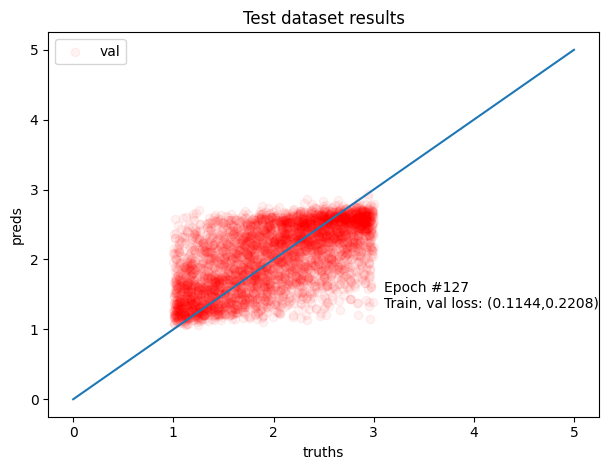

Epoch 128/300 - Train loss:	 0.1125
Epoch 128/300 - Validation MSE:	 0.2215



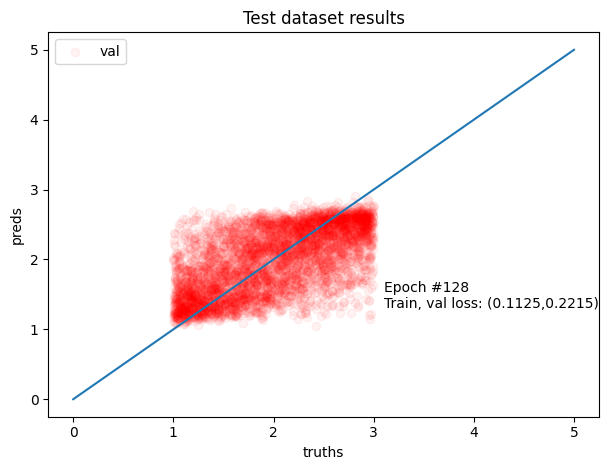

Epoch 129/300 - Train loss:	 0.1130
Epoch 129/300 - Validation MSE:	 0.2260



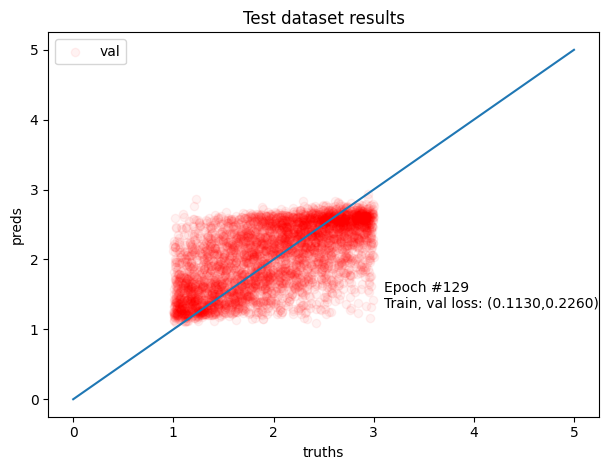

Epoch 130/300 - Train loss:	 0.1128
Epoch 130/300 - Validation MSE:	 0.2250



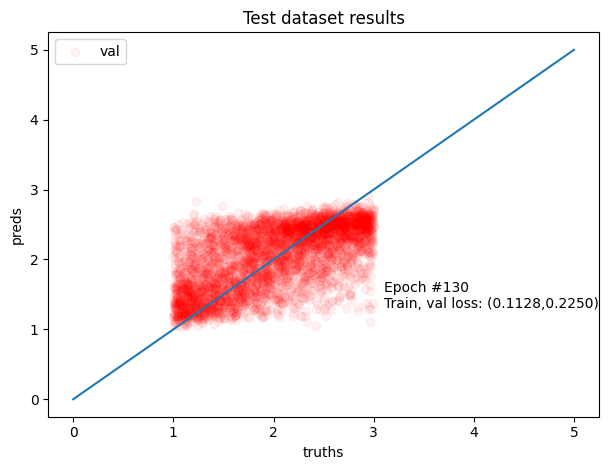

Epoch 131/300 - Train loss:	 0.1096
Epoch 131/300 - Validation MSE:	 0.2273



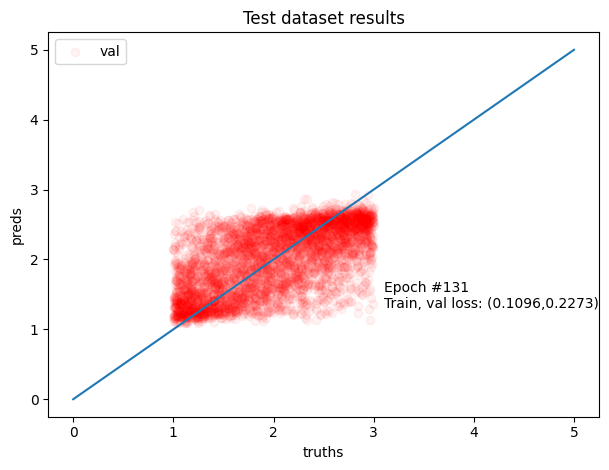

Epoch 132/300 - Train loss:	 0.1088
Epoch 132/300 - Validation MSE:	 0.2213



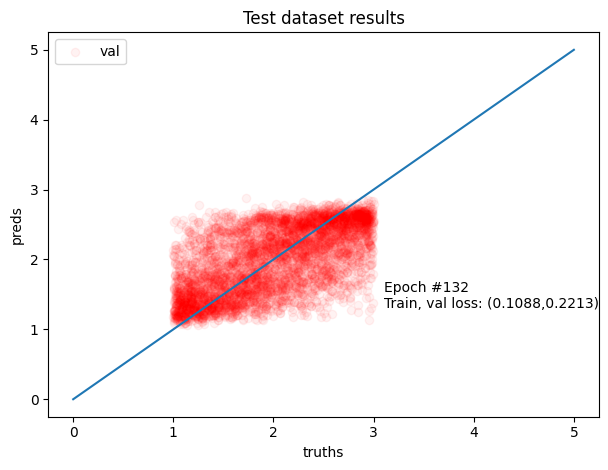

Epoch 133/300 - Train loss:	 0.1079
Epoch 133/300 - Validation MSE:	 0.2259



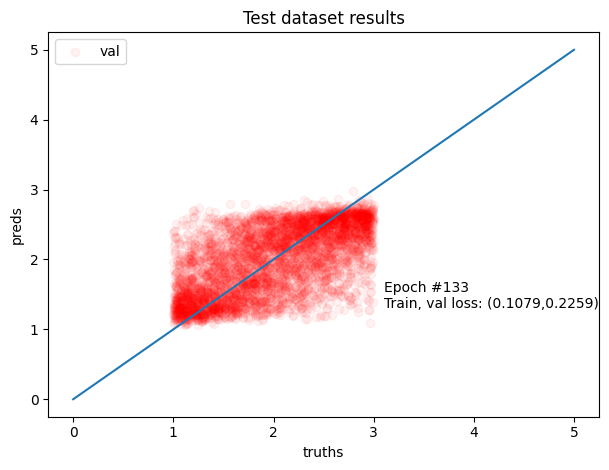

Epoch 134/300 - Train loss:	 0.1069
Epoch 134/300 - Validation MSE:	 0.2241



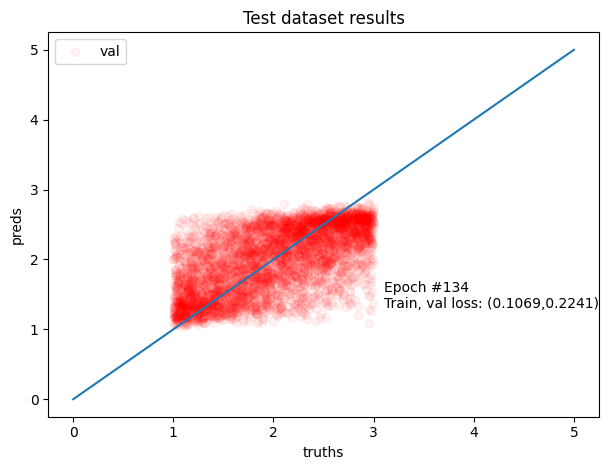

Epoch 135/300 - Train loss:	 0.1050
Epoch 135/300 - Validation MSE:	 0.2201



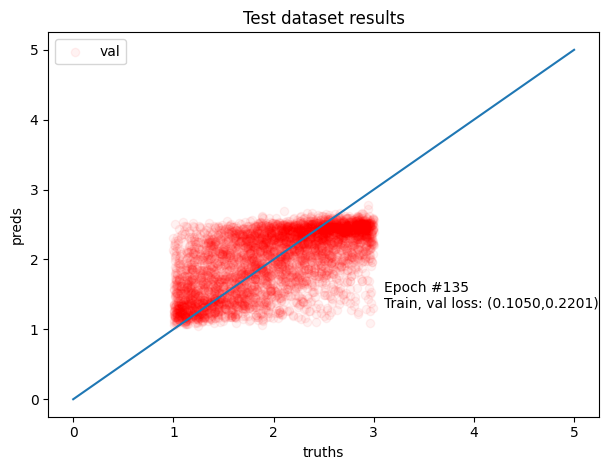

Epoch 136/300 - Train loss:	 0.1057
Epoch 136/300 - Validation MSE:	 0.2246



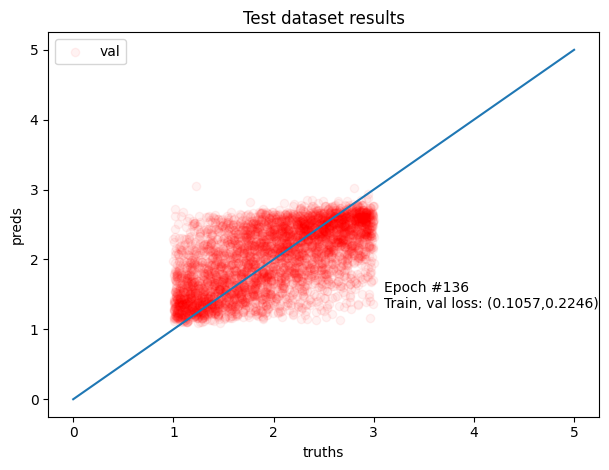

Epoch 137/300 - Train loss:	 0.1051
Epoch 137/300 - Validation MSE:	 0.2284



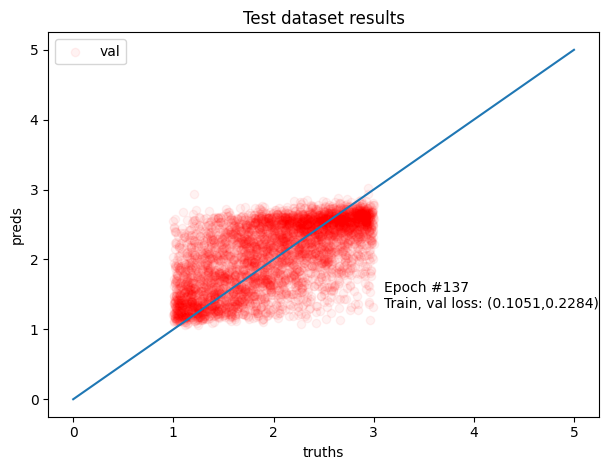

Epoch 138/300 - Train loss:	 0.1031
Epoch 138/300 - Validation MSE:	 0.2230



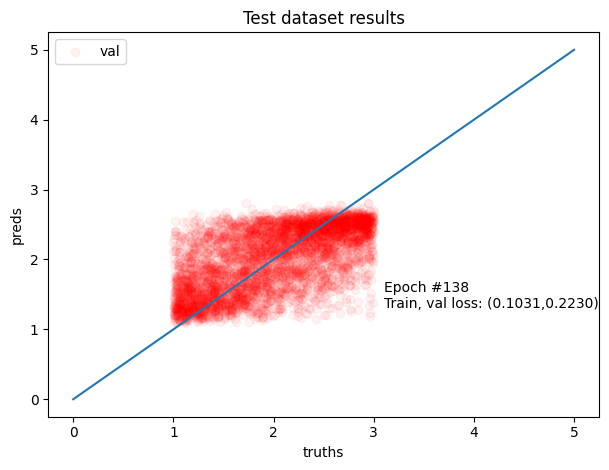

Epoch 139/300 - Train loss:	 0.1031
Epoch 139/300 - Validation MSE:	 0.2297



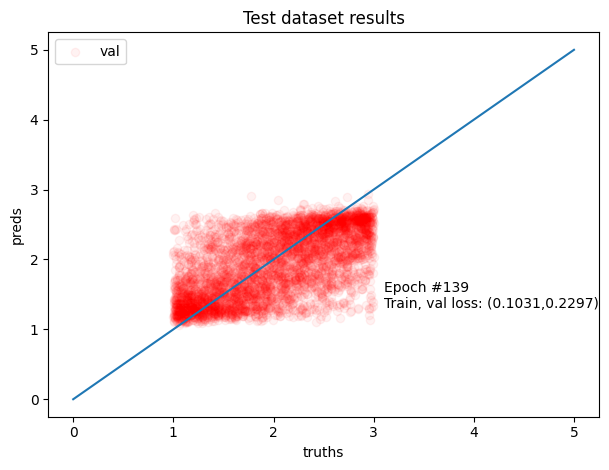

Epoch 140/300 - Train loss:	 0.1012
Epoch 140/300 - Validation MSE:	 0.2323



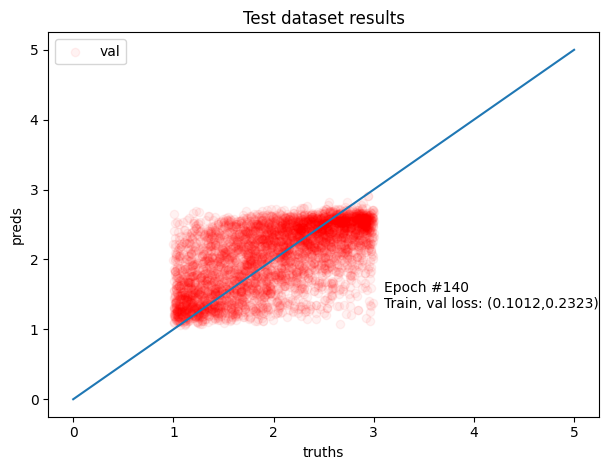

Epoch 141/300 - Train loss:	 0.1013
Epoch 141/300 - Validation MSE:	 0.2433



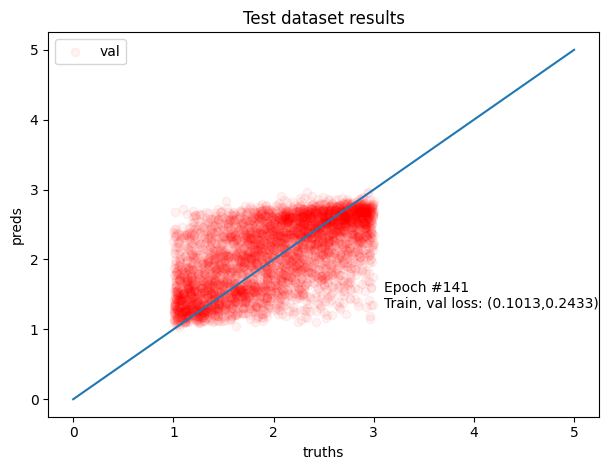

Epoch 154/300 - Train loss:	 0.0882
Epoch 154/300 - Validation MSE:	 0.2372



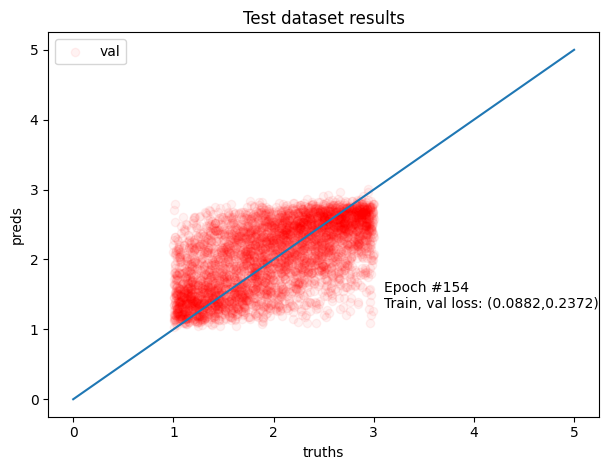

Epoch 155/300 - Train loss:	 0.0876
Epoch 155/300 - Validation MSE:	 0.2316



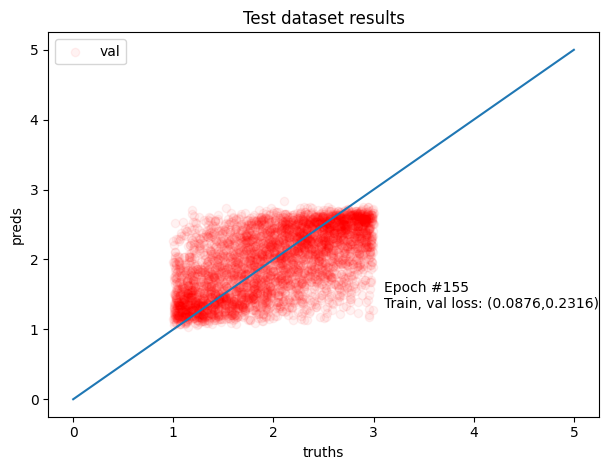

Epoch 156/300 - Train loss:	 0.0884
Epoch 156/300 - Validation MSE:	 0.2418



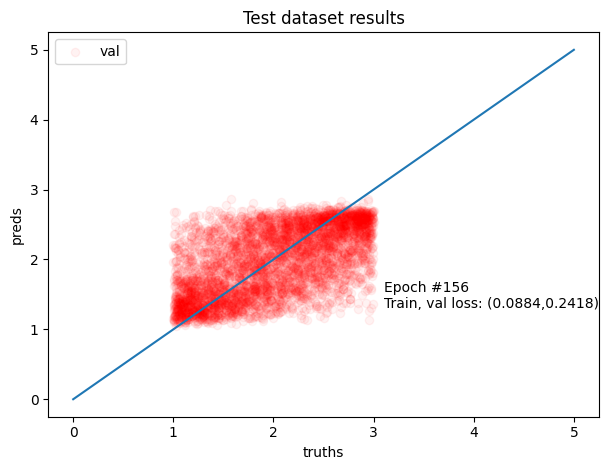

Epoch 157/300 - Train loss:	 0.0873
Epoch 157/300 - Validation MSE:	 0.2362



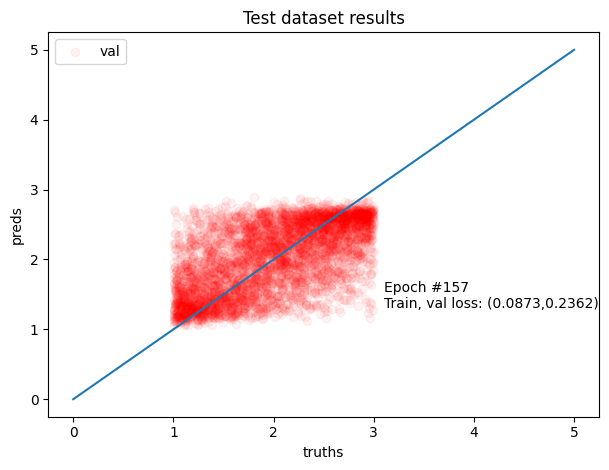

Epoch 158/300 - Train loss:	 0.0867
Epoch 158/300 - Validation MSE:	 0.2469



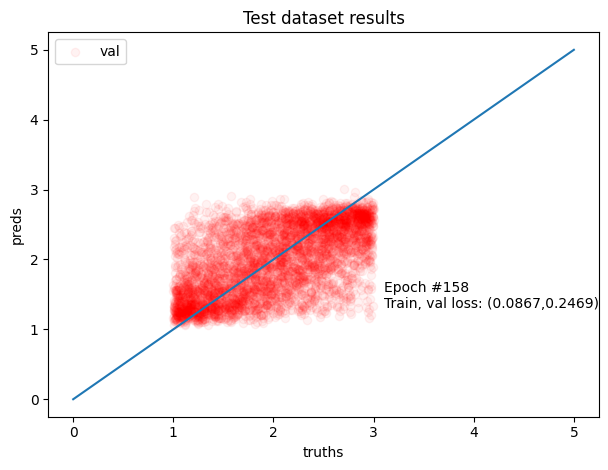

Epoch 159/300 - Train loss:	 0.0870
Epoch 159/300 - Validation MSE:	 0.2458



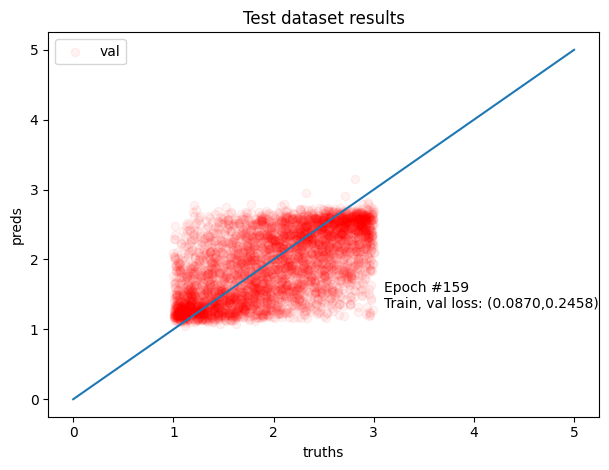

Epoch 160/300 - Train loss:	 0.0839
Epoch 160/300 - Validation MSE:	 0.2334



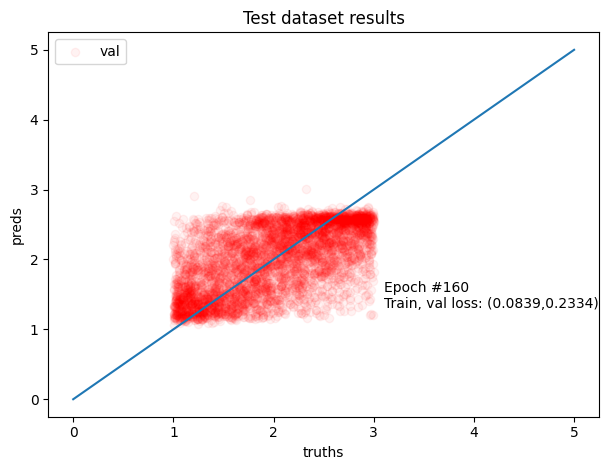

Epoch 161/300 - Train loss:	 0.0833
Epoch 161/300 - Validation MSE:	 0.2472



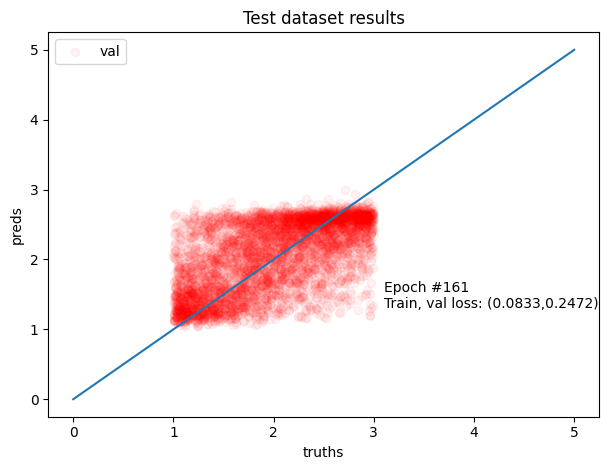

Epoch 162/300 - Train loss:	 0.0861
Epoch 162/300 - Validation MSE:	 0.2383



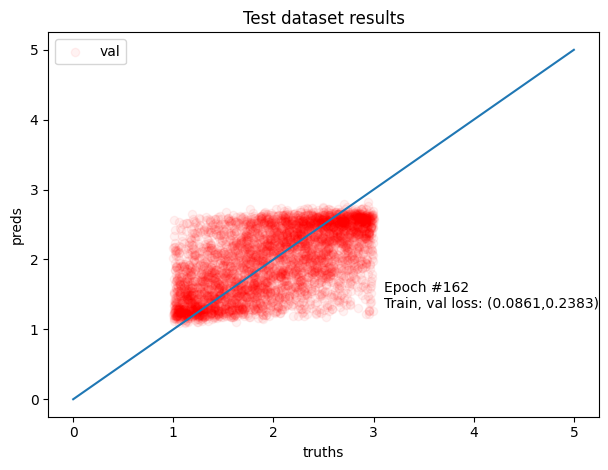

Epoch 163/300 - Train loss:	 0.0809
Epoch 163/300 - Validation MSE:	 0.2480



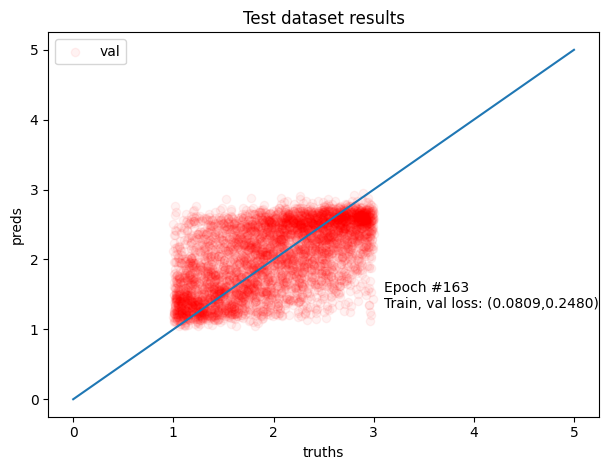

Epoch 164/300 - Train loss:	 0.0833
Epoch 164/300 - Validation MSE:	 0.2413



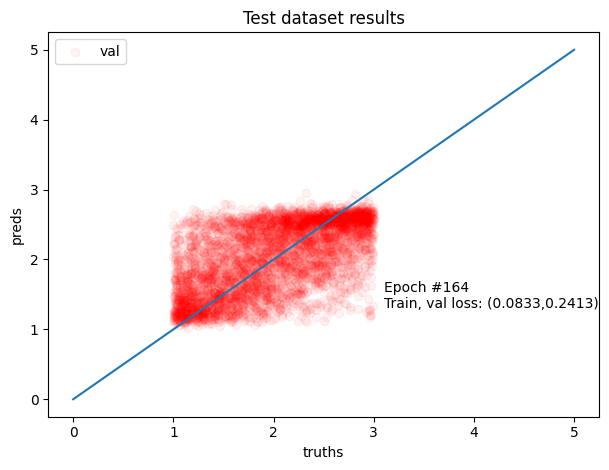

Epoch 165/300 - Train loss:	 0.0811
Epoch 165/300 - Validation MSE:	 0.2393



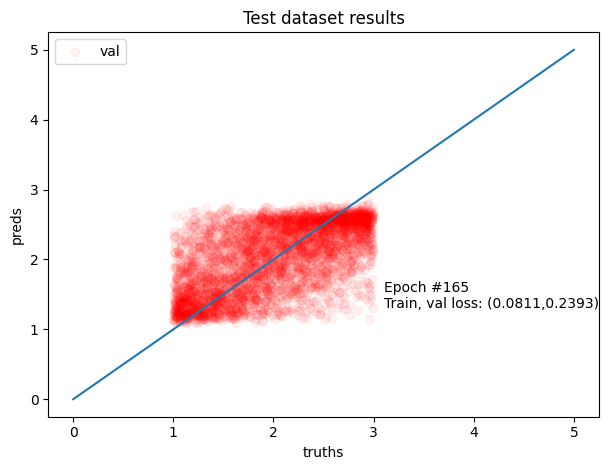

Epoch 166/300 - Train loss:	 0.0803
Epoch 166/300 - Validation MSE:	 0.2408



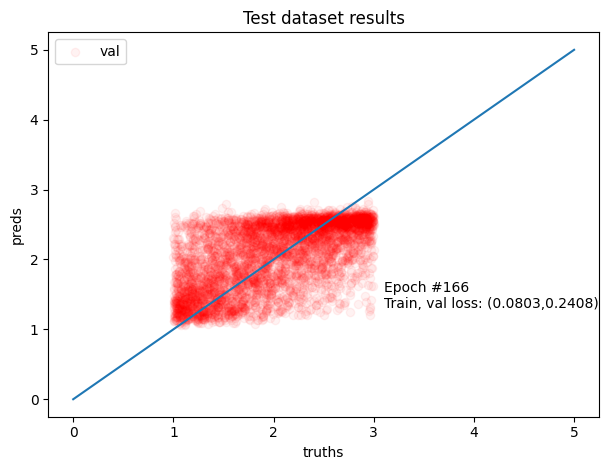

Epoch 167/300 - Train loss:	 0.0799
Epoch 167/300 - Validation MSE:	 0.2518



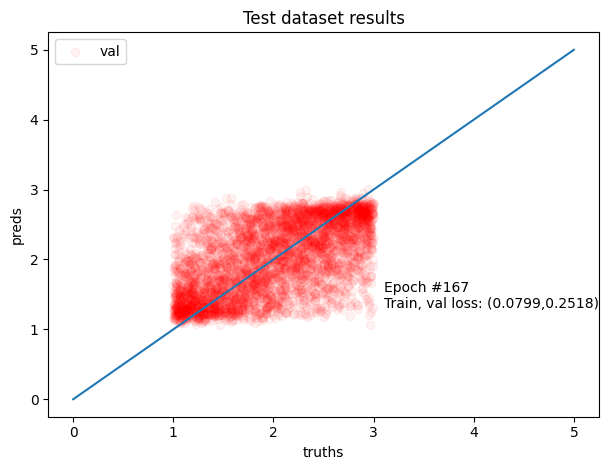

Epoch 168/300 - Train loss:	 0.0793
Epoch 168/300 - Validation MSE:	 0.2420



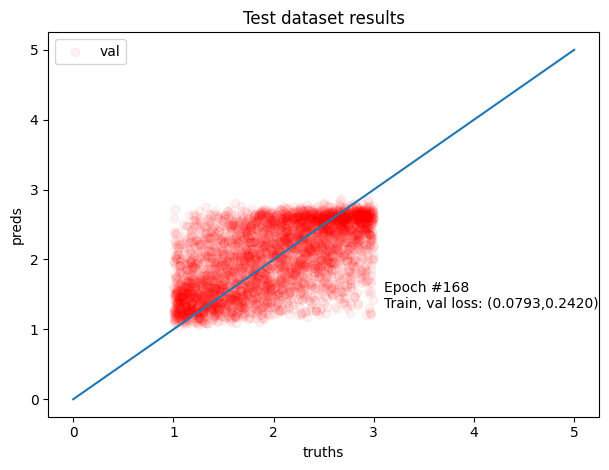

Epoch 169/300 - Train loss:	 0.0782
Epoch 169/300 - Validation MSE:	 0.2474



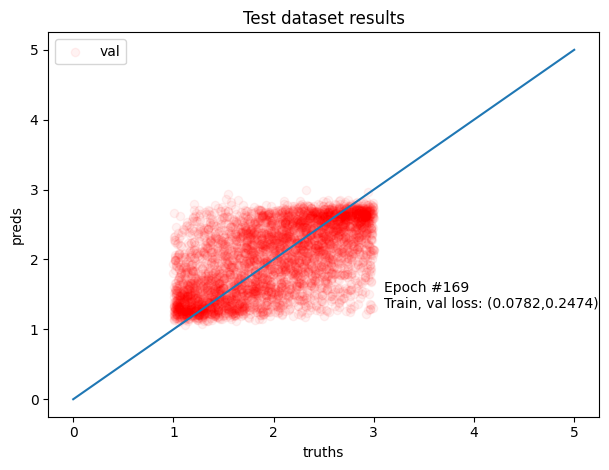

Epoch 170/300 - Train loss:	 0.0764
Epoch 170/300 - Validation MSE:	 0.2507



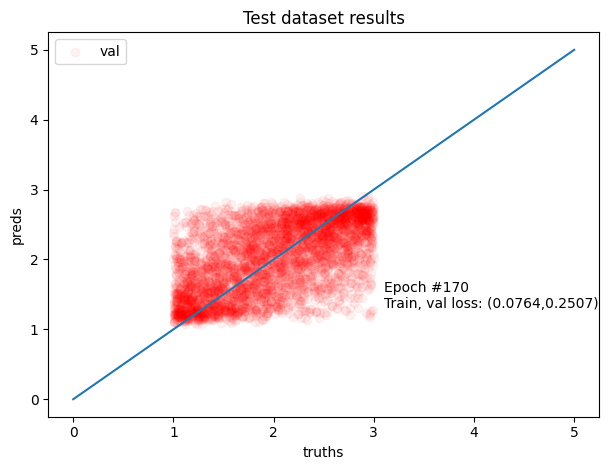

Epoch 171/300 - Train loss:	 0.0798
Epoch 171/300 - Validation MSE:	 0.2457



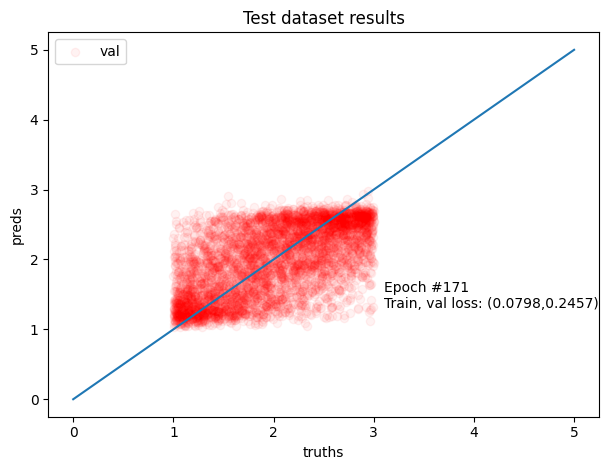

Epoch 172/300 - Train loss:	 0.0763
Epoch 172/300 - Validation MSE:	 0.2455



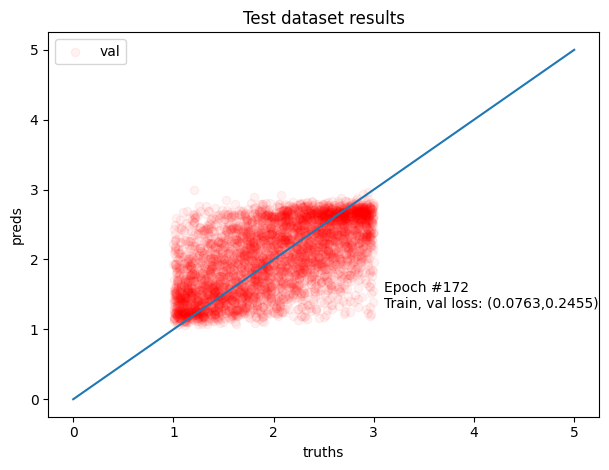

Epoch 173/300 - Train loss:	 0.0747
Epoch 173/300 - Validation MSE:	 0.2453



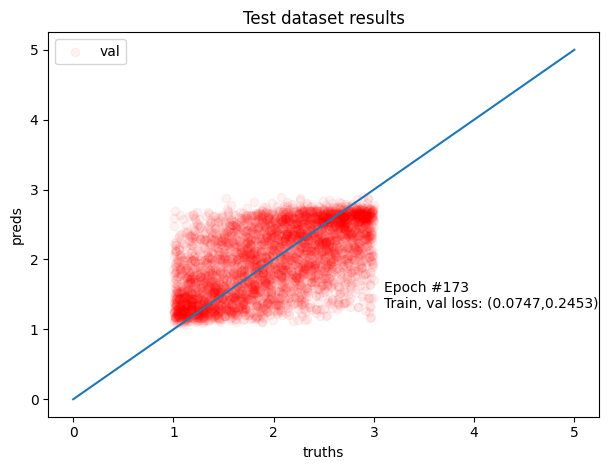

Epoch 174/300 - Train loss:	 0.0745
Epoch 174/300 - Validation MSE:	 0.2480



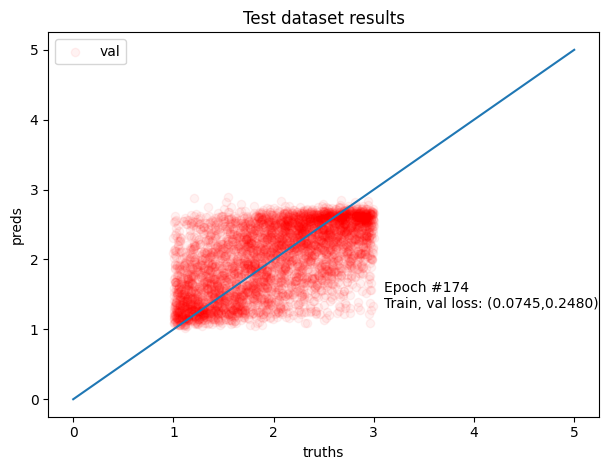

Epoch 175/300 - Train loss:	 0.0741
Epoch 175/300 - Validation MSE:	 0.2462



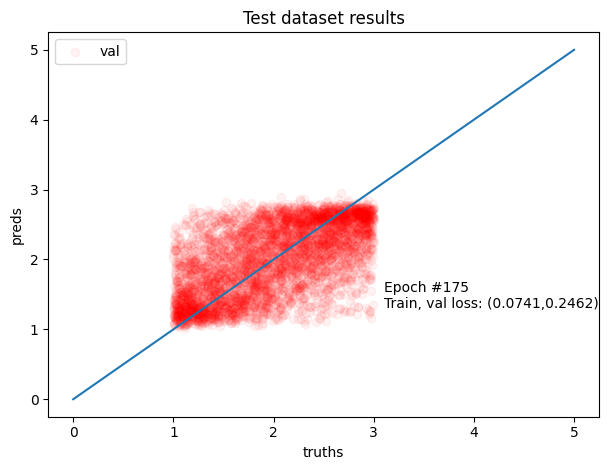

Epoch 176/300 - Train loss:	 0.0746
Epoch 176/300 - Validation MSE:	 0.2541



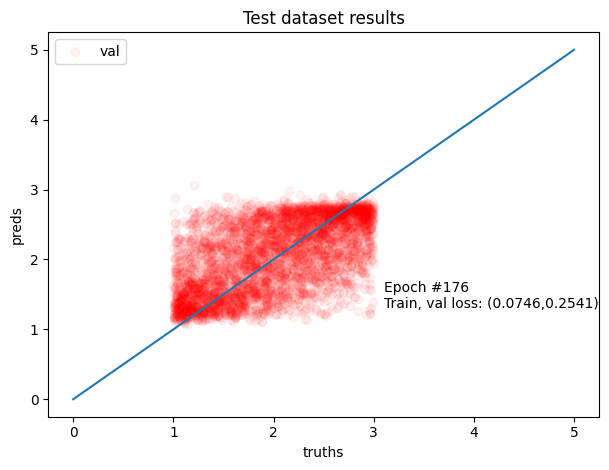

Epoch 177/300 - Train loss:	 0.0701
Epoch 177/300 - Validation MSE:	 0.2451



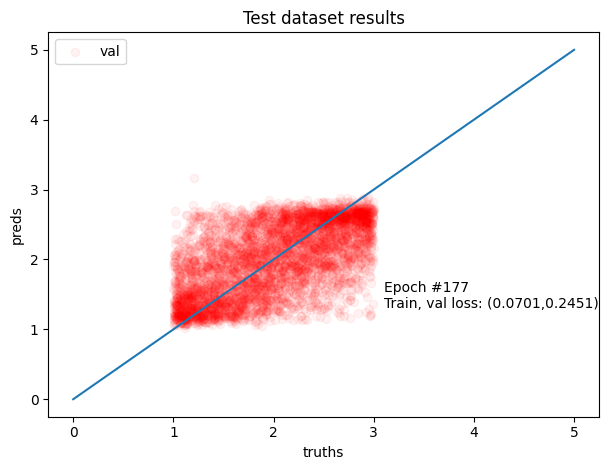

Epoch 178/300 - Train loss:	 0.0737
Epoch 178/300 - Validation MSE:	 0.2501



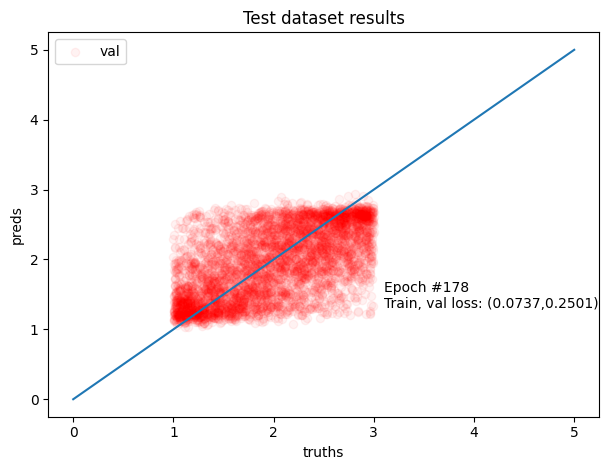

Epoch 179/300 - Train loss:	 0.0715
Epoch 179/300 - Validation MSE:	 0.2550



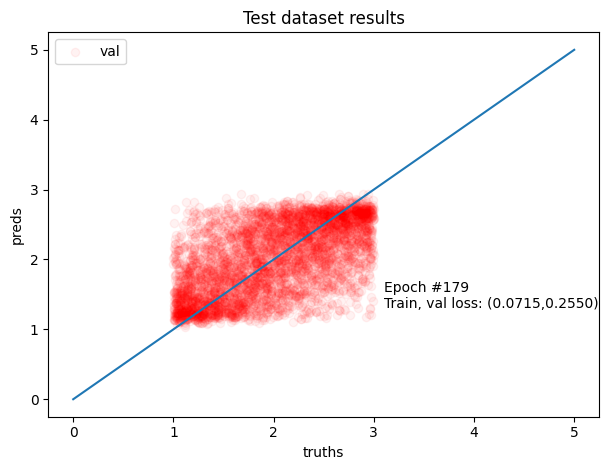

Epoch 180/300 - Train loss:	 0.0726
Epoch 180/300 - Validation MSE:	 0.2523



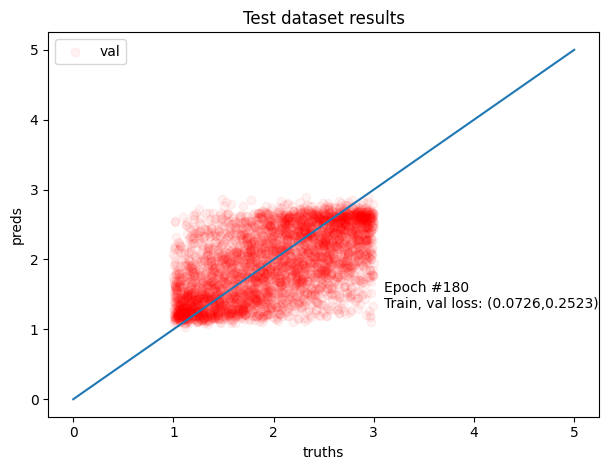

Epoch 181/300 - Train loss:	 0.0710
Epoch 181/300 - Validation MSE:	 0.2523



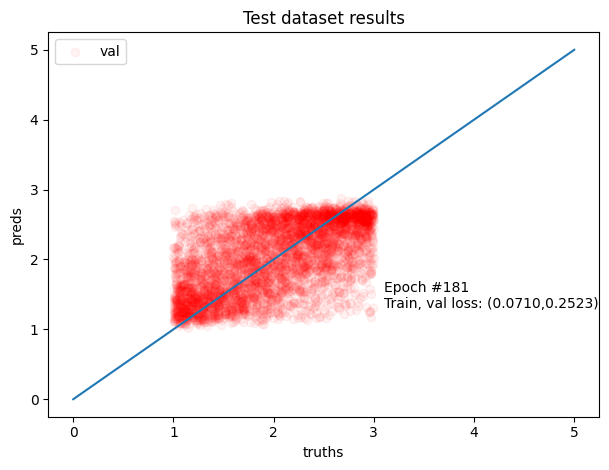

Epoch 182/300 - Train loss:	 0.0681
Epoch 182/300 - Validation MSE:	 0.2683



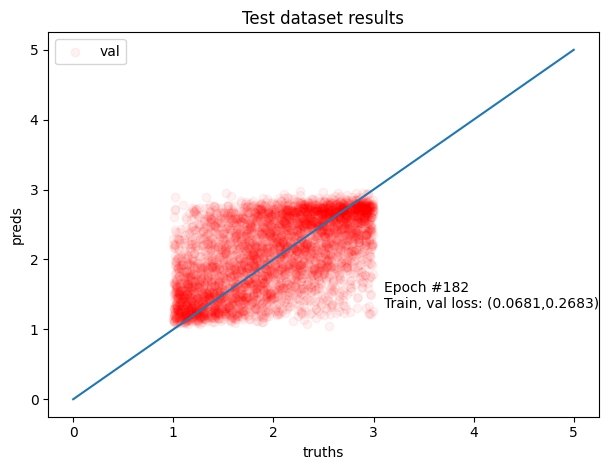

Epoch 183/300 - Train loss:	 0.0693
Epoch 183/300 - Validation MSE:	 0.2428



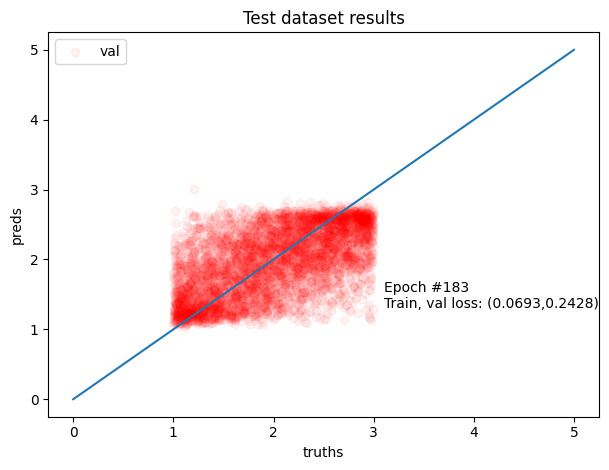

Epoch 184/300 - Train loss:	 0.0693
Epoch 184/300 - Validation MSE:	 0.2605



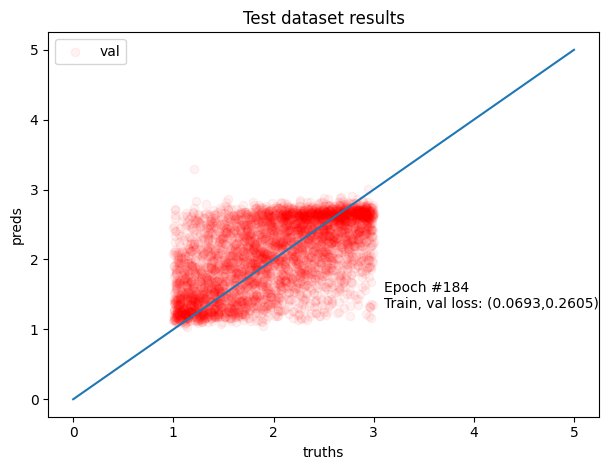

Epoch 185/300 - Train loss:	 0.0657
Epoch 185/300 - Validation MSE:	 0.2576



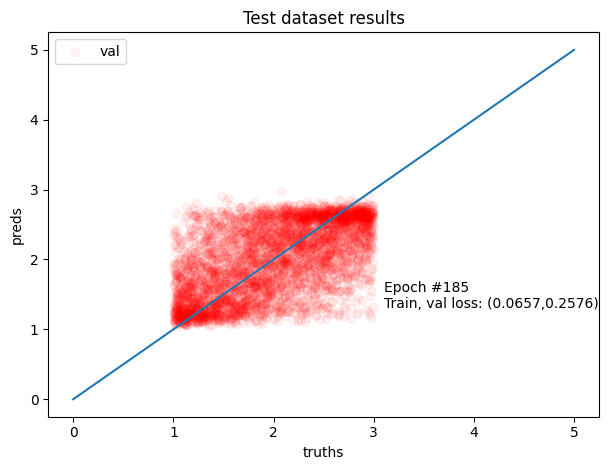

Epoch 186/300 - Train loss:	 0.0666
Epoch 186/300 - Validation MSE:	 0.2585



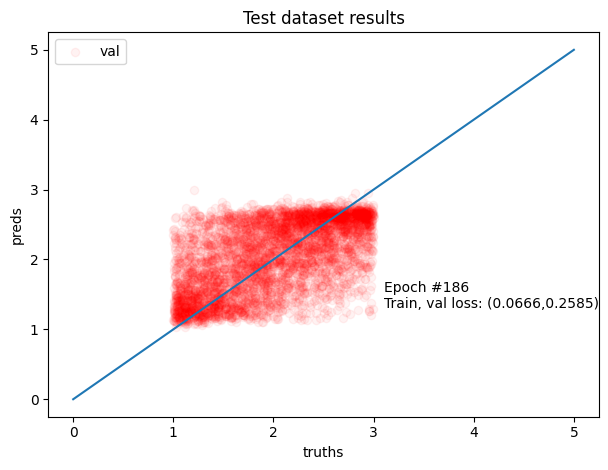

Epoch 187/300 - Train loss:	 0.0678
Epoch 187/300 - Validation MSE:	 0.2510



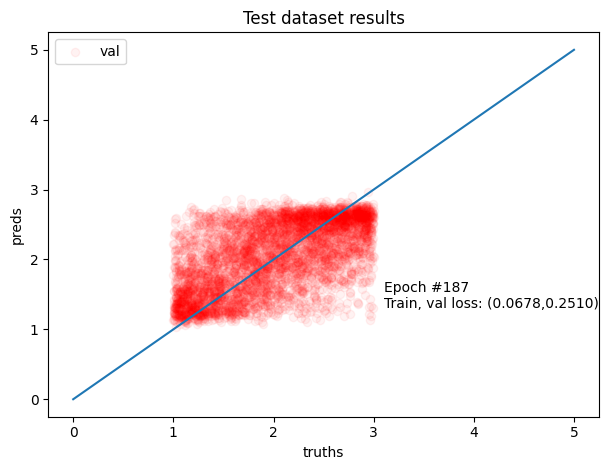

Epoch 188/300 - Train loss:	 0.0652
Epoch 188/300 - Validation MSE:	 0.2688



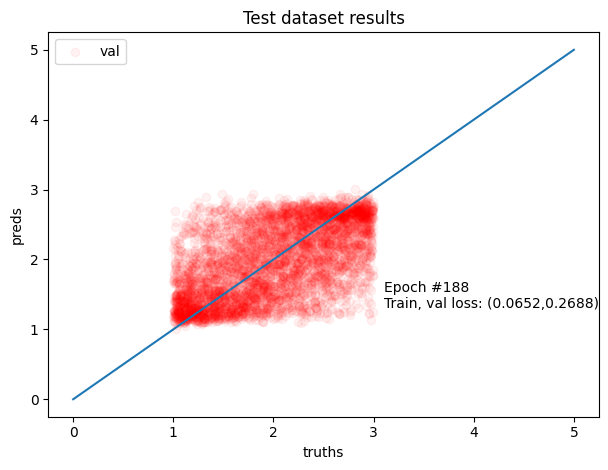

Epoch 189/300 - Train loss:	 0.0647
Epoch 189/300 - Validation MSE:	 0.2562



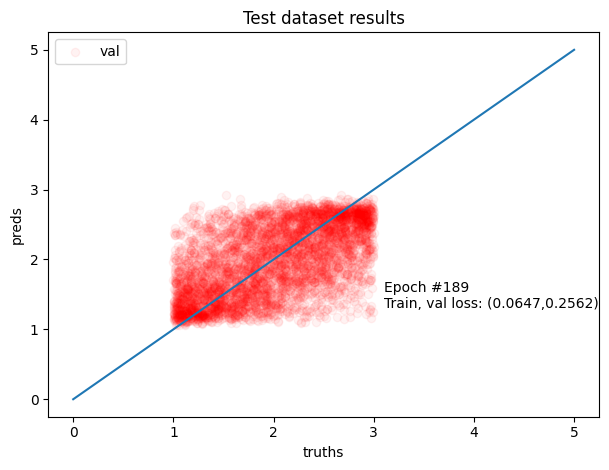

Epoch 190/300 - Train loss:	 0.0661
Epoch 190/300 - Validation MSE:	 0.2568



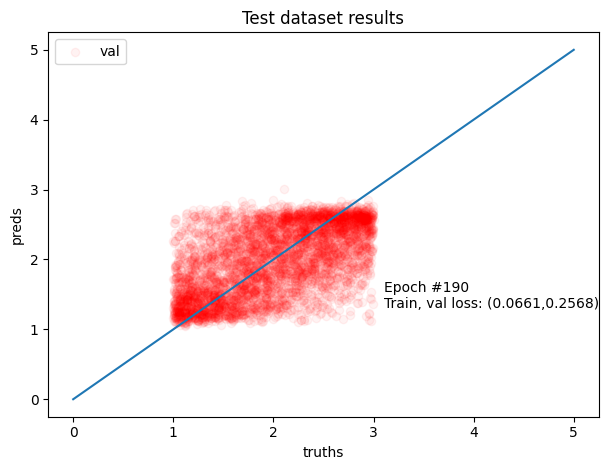

Epoch 191/300 - Train loss:	 0.0653
Epoch 191/300 - Validation MSE:	 0.2546



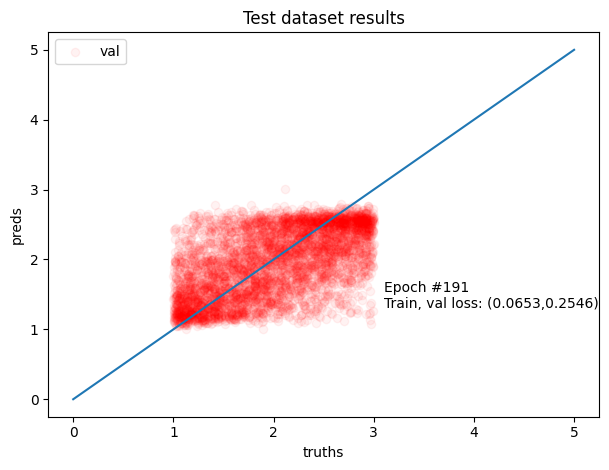

Epoch 192/300 - Train loss:	 0.0644
Epoch 192/300 - Validation MSE:	 0.2613



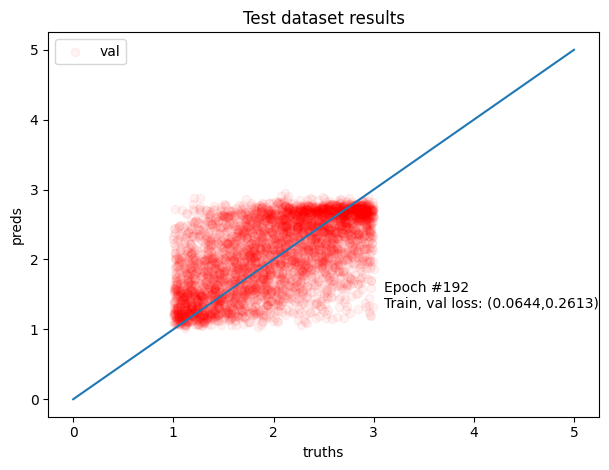

Epoch 193/300 - Train loss:	 0.0627
Epoch 193/300 - Validation MSE:	 0.2511



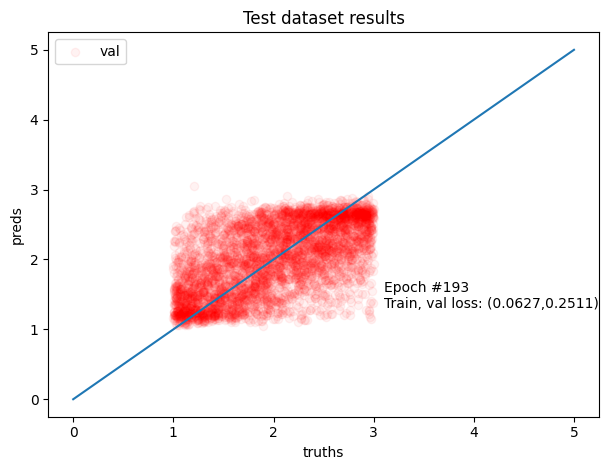

Epoch 194/300 - Train loss:	 0.0633
Epoch 194/300 - Validation MSE:	 0.2475



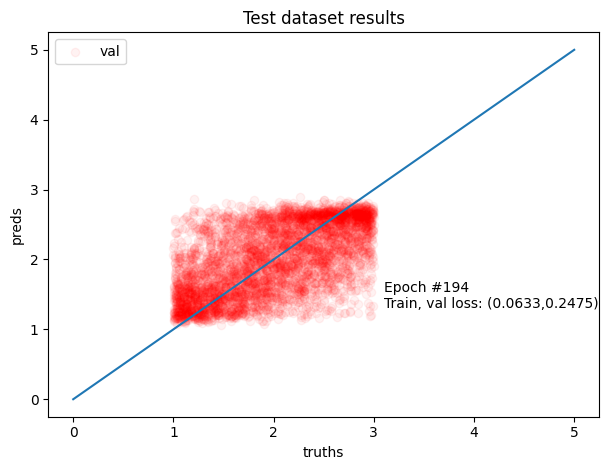

Epoch 195/300 - Train loss:	 0.0611
Epoch 195/300 - Validation MSE:	 0.2558



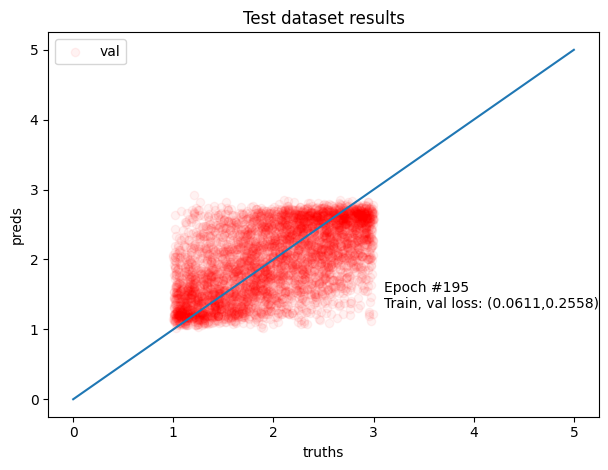

Epoch 196/300 - Train loss:	 0.0620
Epoch 196/300 - Validation MSE:	 0.2557



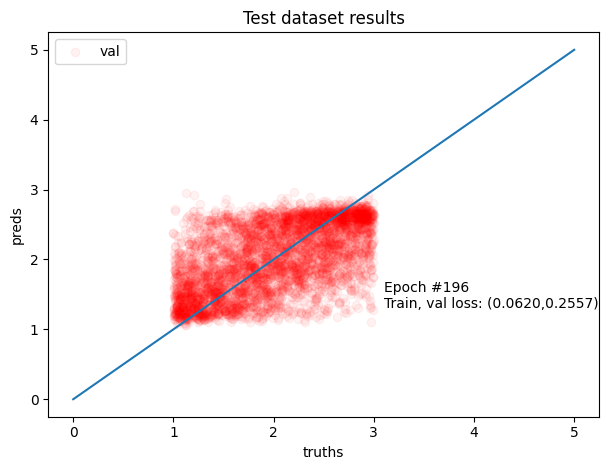

Epoch 197/300 - Train loss:	 0.0612
Epoch 197/300 - Validation MSE:	 0.2544



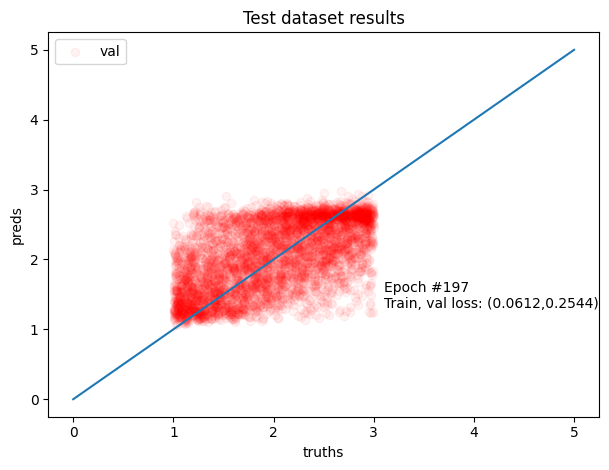

Epoch 198/300 - Train loss:	 0.0591
Epoch 198/300 - Validation MSE:	 0.2602



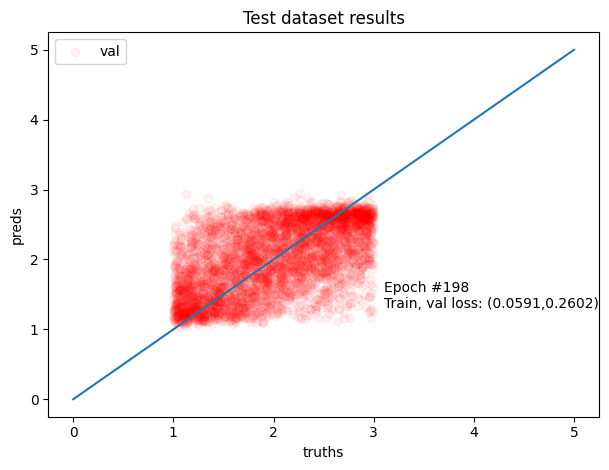

Epoch 199/300 - Train loss:	 0.0624
Epoch 199/300 - Validation MSE:	 0.2582



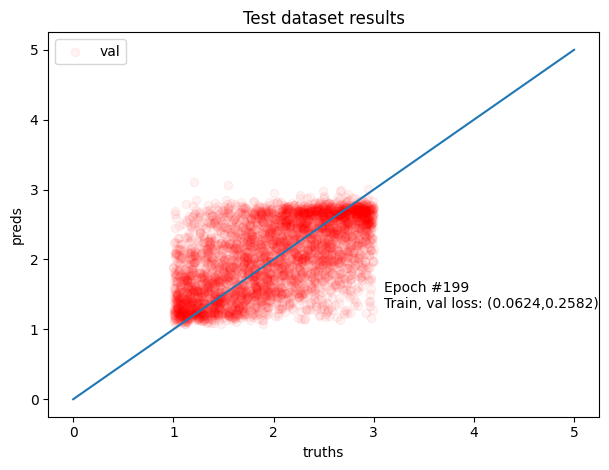

Epoch 200/300 - Train loss:	 0.0585
Epoch 200/300 - Validation MSE:	 0.2517



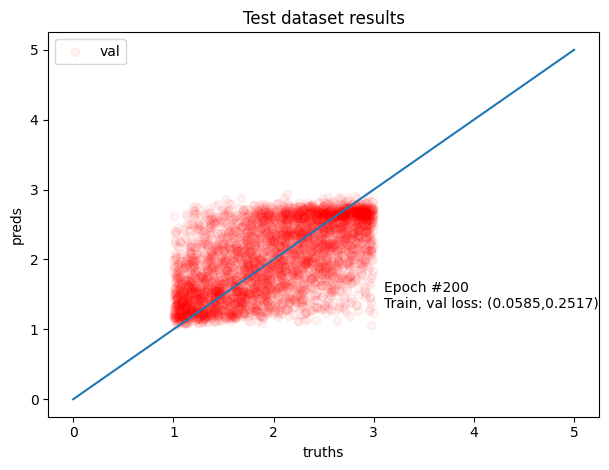

Epoch 201/300 - Train loss:	 0.0603
Epoch 201/300 - Validation MSE:	 0.2564



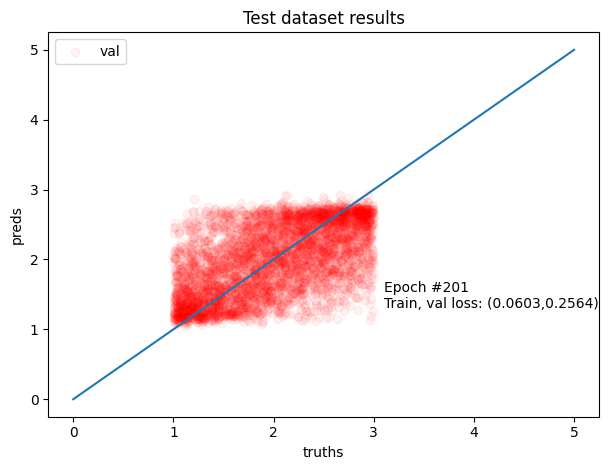

Epoch 202/300 - Train loss:	 0.0576
Epoch 202/300 - Validation MSE:	 0.2541



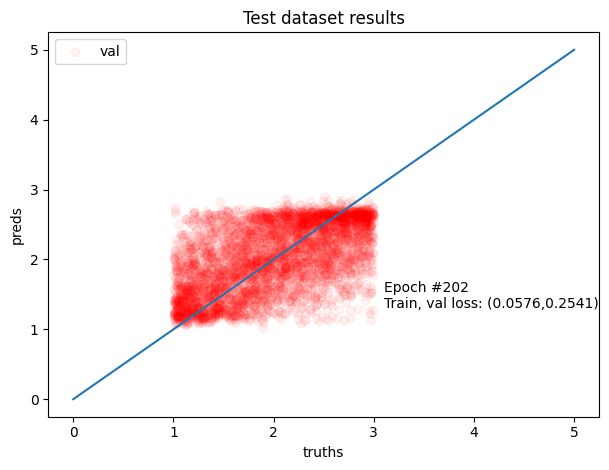

Epoch 203/300 - Train loss:	 0.0592
Epoch 203/300 - Validation MSE:	 0.2606



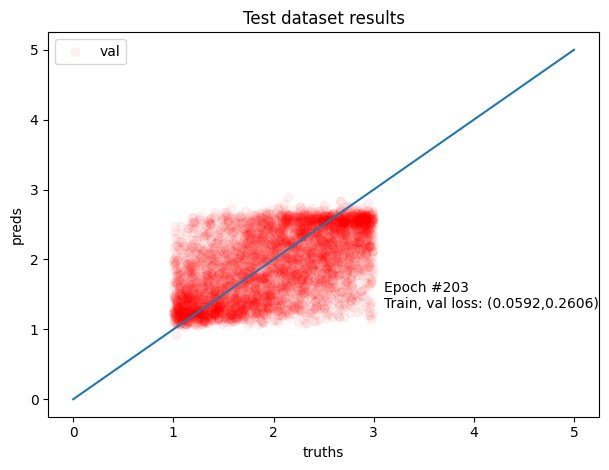

Epoch 204/300 - Train loss:	 0.0570
Epoch 204/300 - Validation MSE:	 0.2542



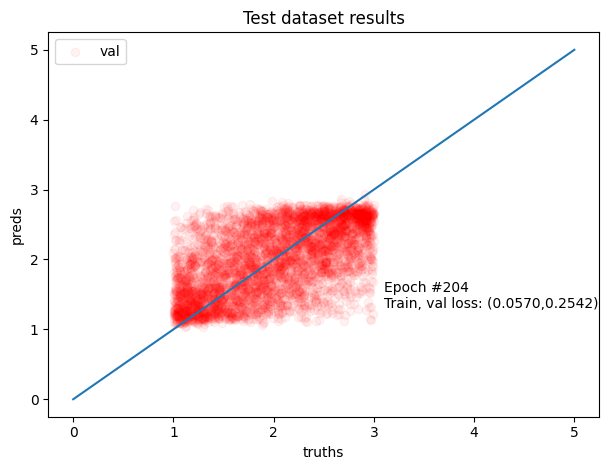

Epoch 205/300 - Train loss:	 0.0572
Epoch 205/300 - Validation MSE:	 0.2702



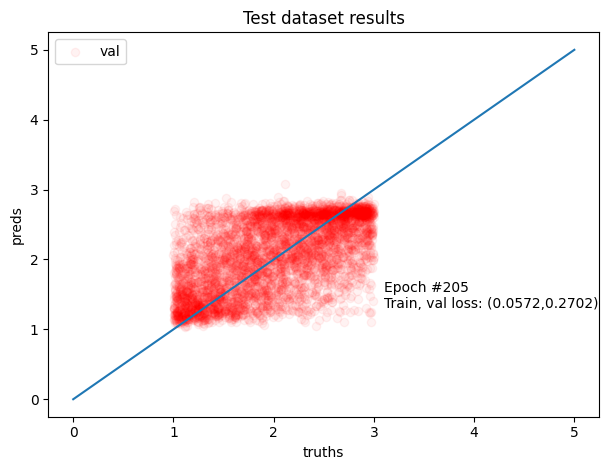

Epoch 206/300 - Train loss:	 0.0595
Epoch 206/300 - Validation MSE:	 0.2680



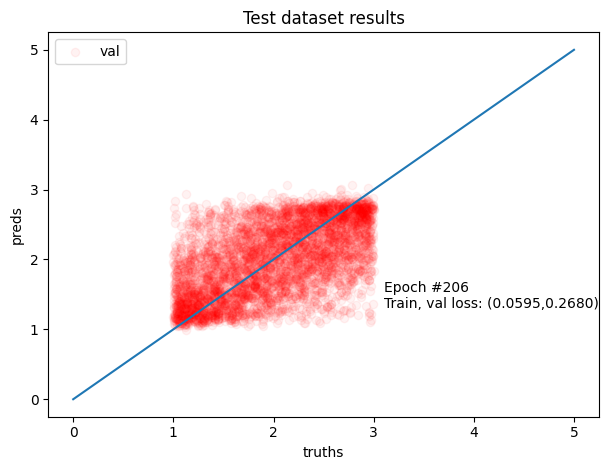

Epoch 207/300 - Train loss:	 0.0551
Epoch 207/300 - Validation MSE:	 0.2638



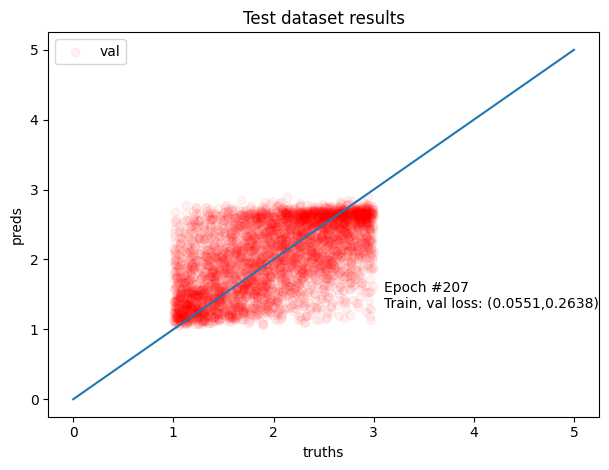

Epoch 208/300 - Train loss:	 0.0576
Epoch 208/300 - Validation MSE:	 0.2594



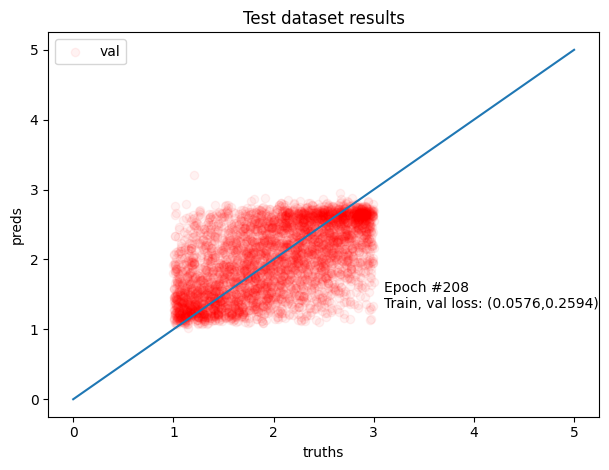

Epoch 209/300 - Train loss:	 0.0552
Epoch 209/300 - Validation MSE:	 0.2593



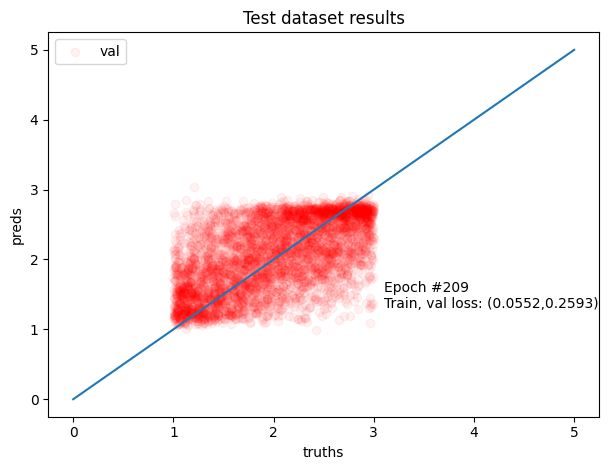

Epoch 210/300 - Train loss:	 0.0567
Epoch 210/300 - Validation MSE:	 0.2741



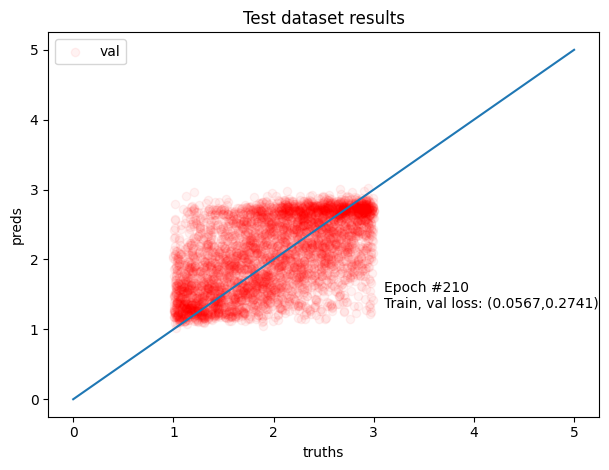

Epoch 211/300 - Train loss:	 0.0543
Epoch 211/300 - Validation MSE:	 0.2528



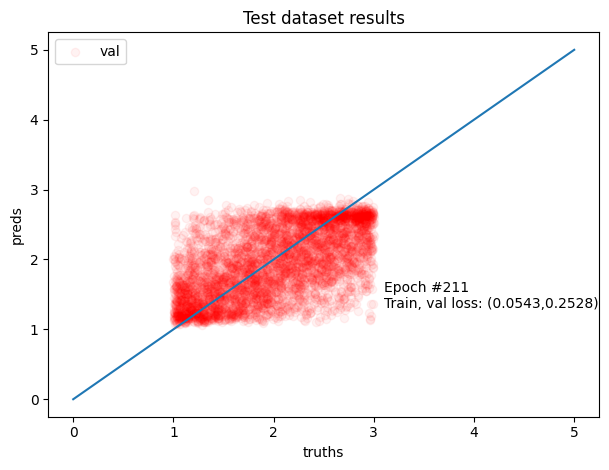

Epoch 212/300 - Train loss:	 0.0548
Epoch 212/300 - Validation MSE:	 0.2713



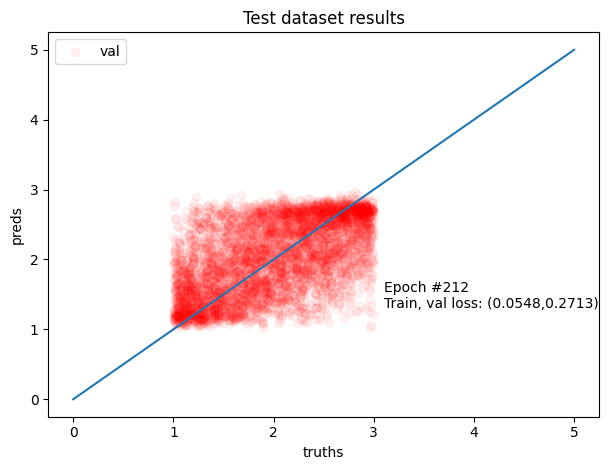

Epoch 213/300 - Train loss:	 0.0533
Epoch 213/300 - Validation MSE:	 0.2654



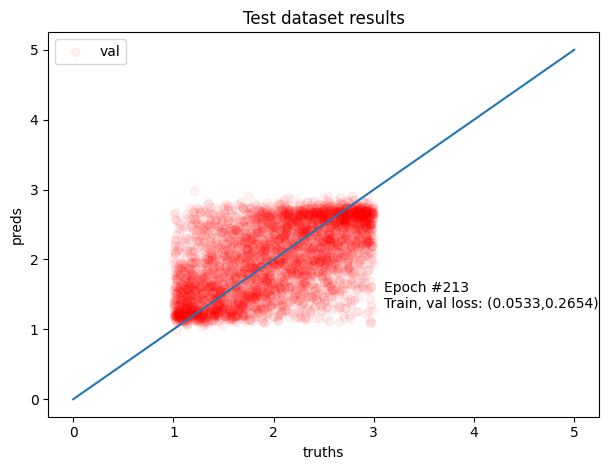

Epoch 214/300 - Train loss:	 0.0541
Epoch 214/300 - Validation MSE:	 0.2655



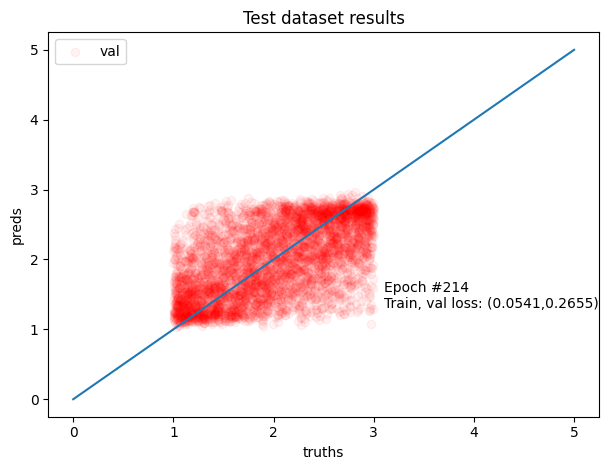

Epoch 215/300 - Train loss:	 0.0534
Epoch 215/300 - Validation MSE:	 0.2546



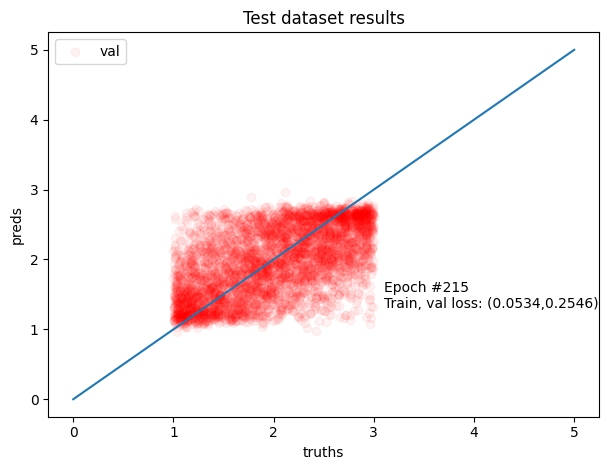

Epoch 216/300 - Train loss:	 0.0544
Epoch 216/300 - Validation MSE:	 0.2562



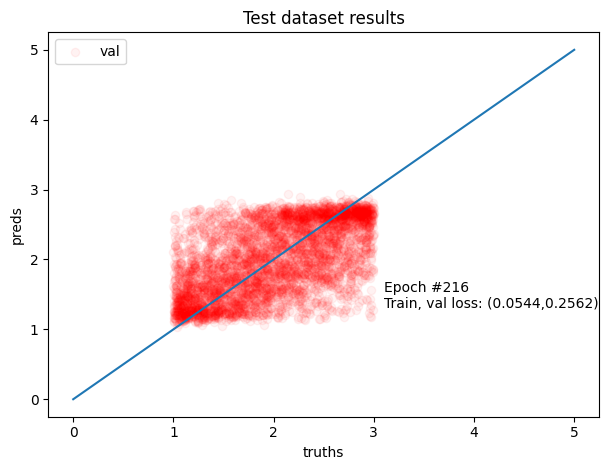

Epoch 217/300 - Train loss:	 0.0502
Epoch 217/300 - Validation MSE:	 0.2662



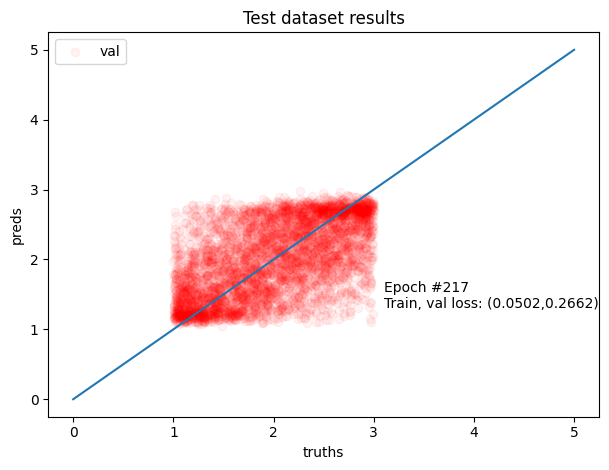

Epoch 218/300 - Train loss:	 0.0524
Epoch 218/300 - Validation MSE:	 0.2655



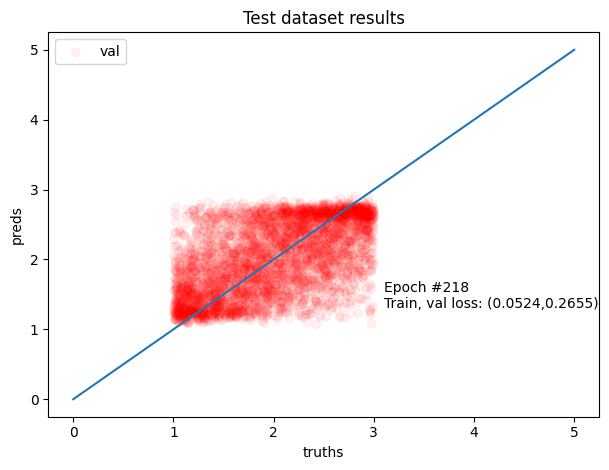

Epoch 219/300 - Train loss:	 0.0502
Epoch 219/300 - Validation MSE:	 0.2625



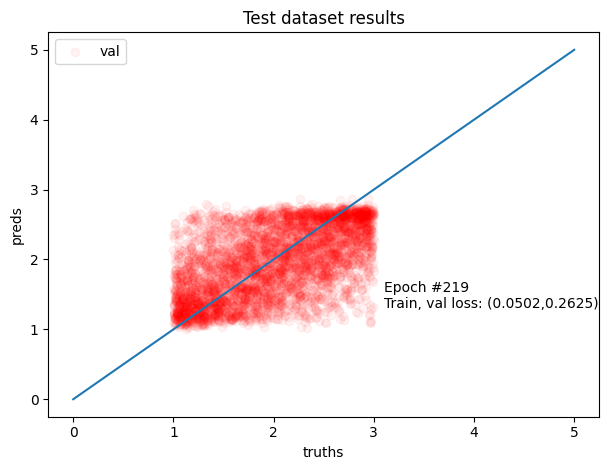

Epoch 220/300 - Train loss:	 0.0516
Epoch 220/300 - Validation MSE:	 0.2637



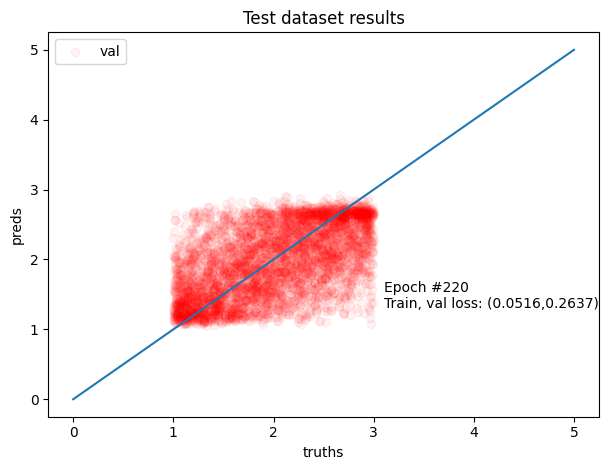

Epoch 221/300 - Train loss:	 0.0525
Epoch 221/300 - Validation MSE:	 0.2622



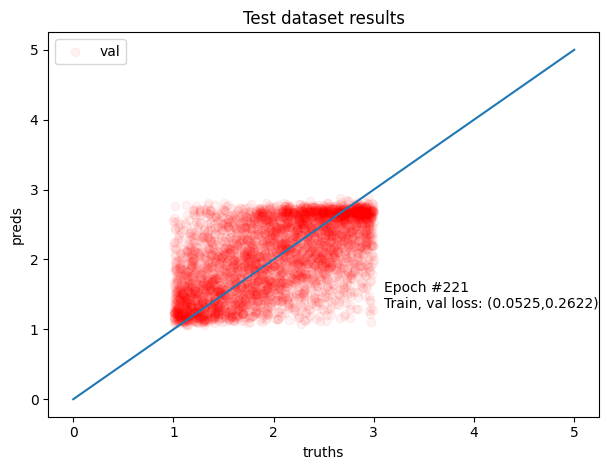

Epoch 222/300 - Train loss:	 0.0507
Epoch 222/300 - Validation MSE:	 0.2602



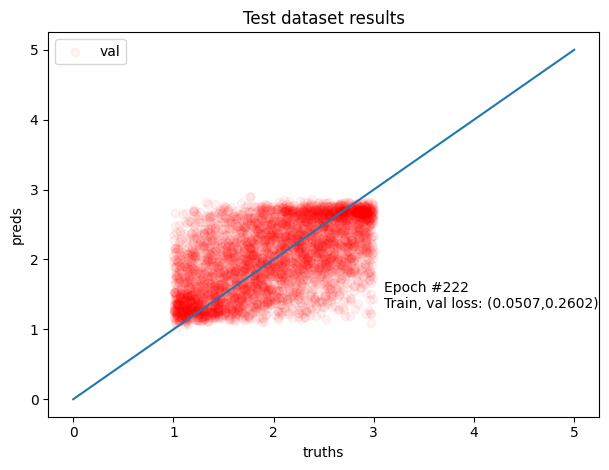

Epoch 223/300 - Train loss:	 0.0504
Epoch 223/300 - Validation MSE:	 0.2660



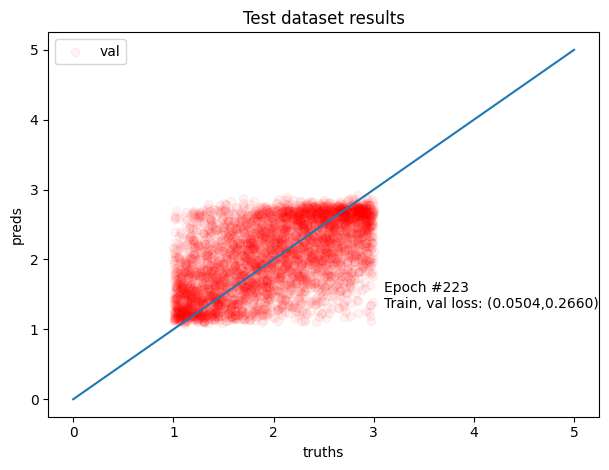

Epoch 224/300 - Train loss:	 0.0514
Epoch 224/300 - Validation MSE:	 0.2709



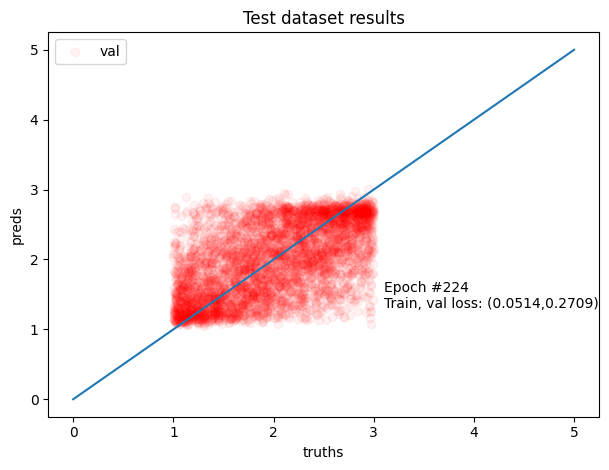

Epoch 225/300 - Train loss:	 0.0464
Epoch 225/300 - Validation MSE:	 0.2618



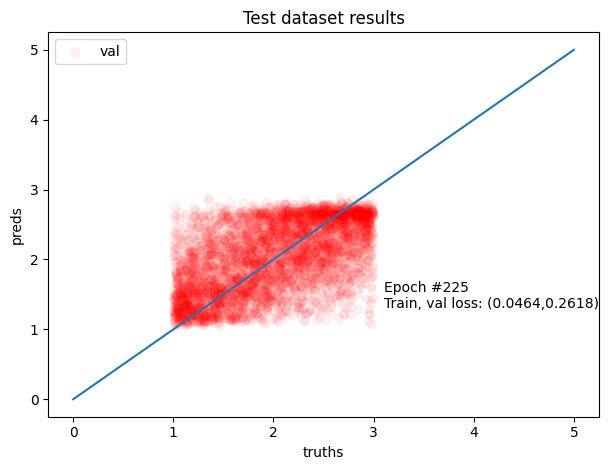

Epoch 226/300 - Train loss:	 0.0521
Epoch 226/300 - Validation MSE:	 0.2723



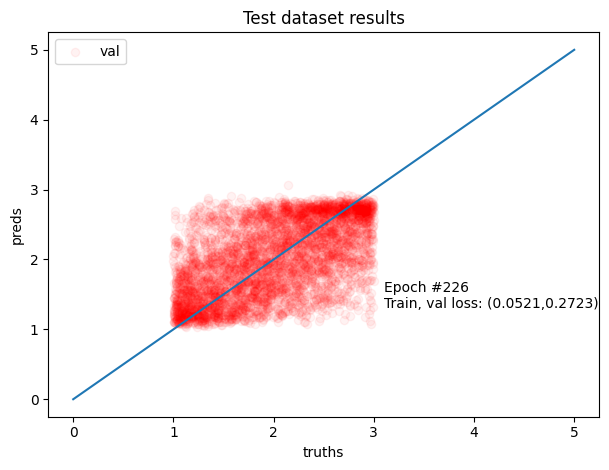

Epoch 227/300 - Train loss:	 0.0479
Epoch 227/300 - Validation MSE:	 0.2651



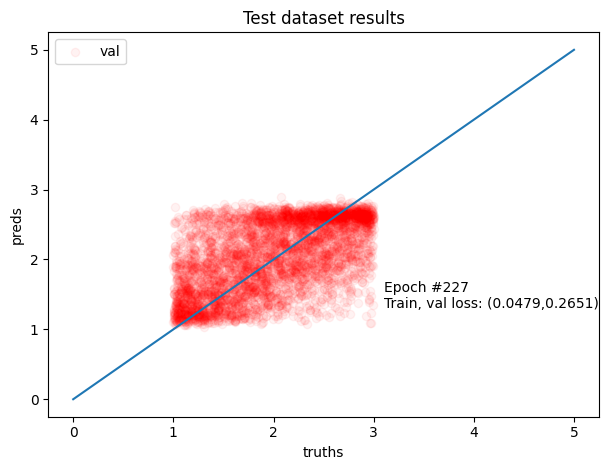

Epoch 228/300 - Train loss:	 0.0491
Epoch 228/300 - Validation MSE:	 0.2610



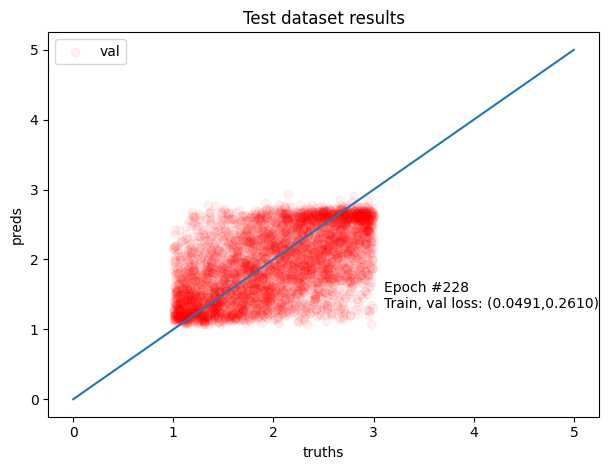

Epoch 229/300 - Train loss:	 0.0471
Epoch 229/300 - Validation MSE:	 0.2626



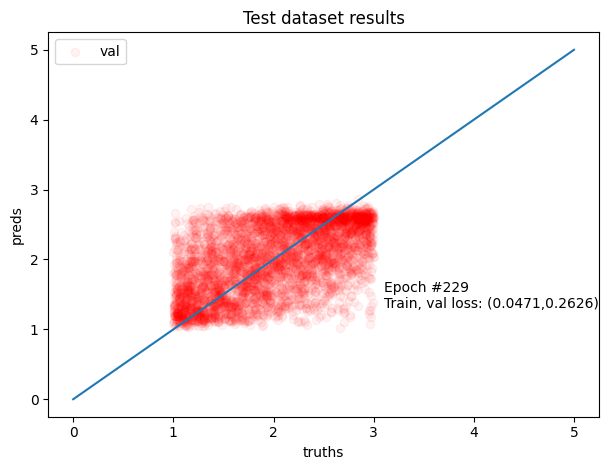

Epoch 230/300 - Train loss:	 0.0473
Epoch 230/300 - Validation MSE:	 0.2724



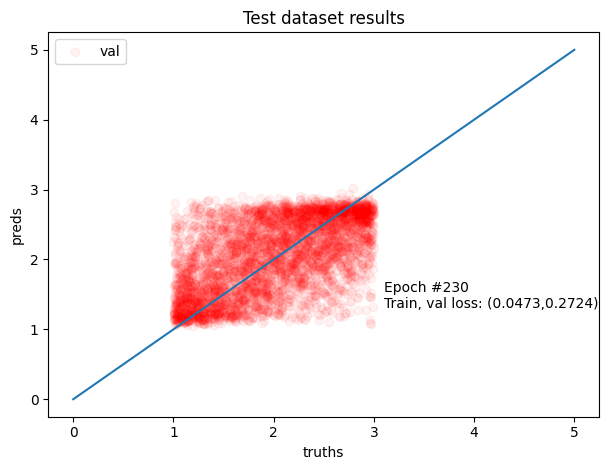

Epoch 231/300 - Train loss:	 0.0478
Epoch 231/300 - Validation MSE:	 0.2718



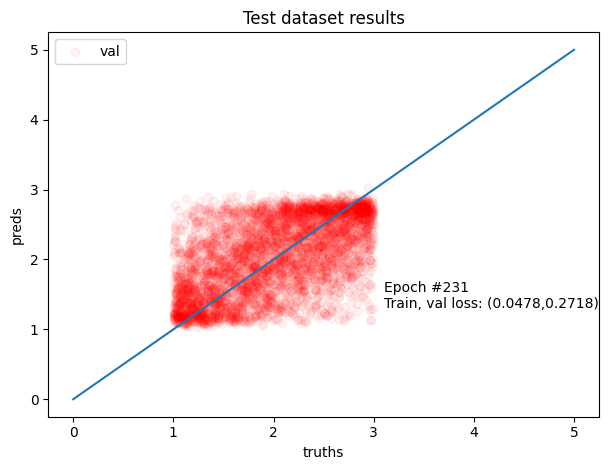

Epoch 232/300 - Train loss:	 0.0466
Epoch 232/300 - Validation MSE:	 0.2719



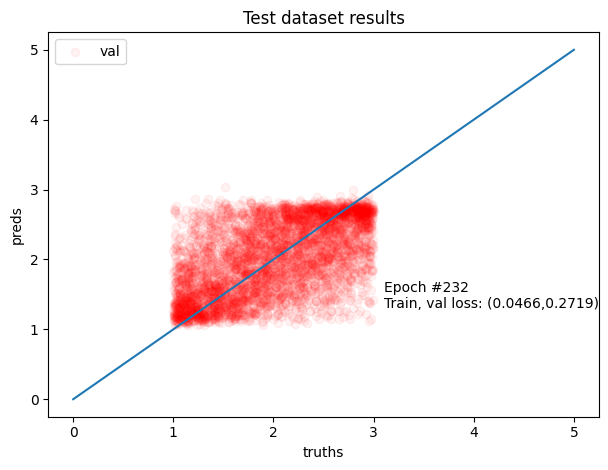

Epoch 233/300 - Train loss:	 0.0470
Epoch 233/300 - Validation MSE:	 0.2641



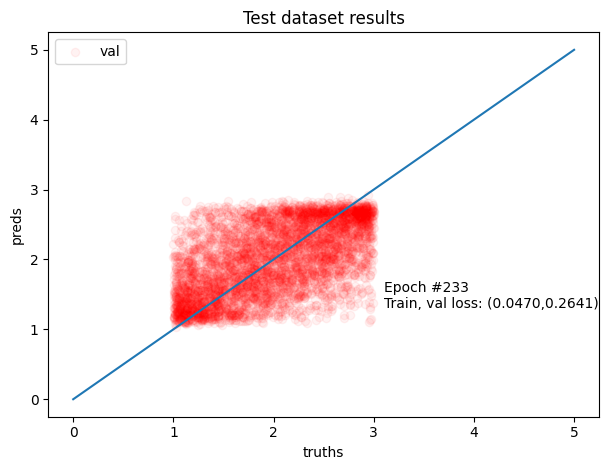

Epoch 234/300 - Train loss:	 0.0444
Epoch 234/300 - Validation MSE:	 0.2729



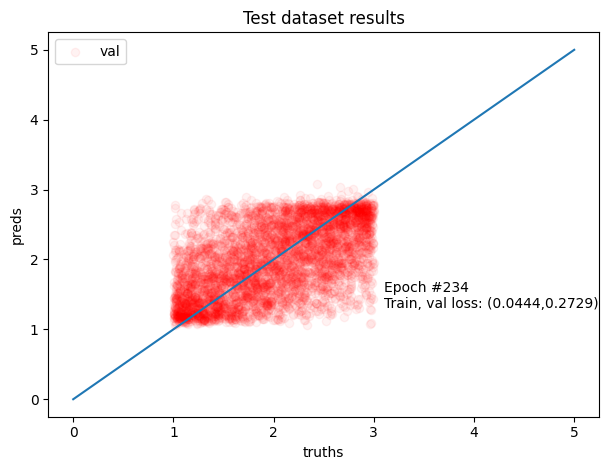

Epoch 235/300 - Train loss:	 0.0461
Epoch 235/300 - Validation MSE:	 0.2727



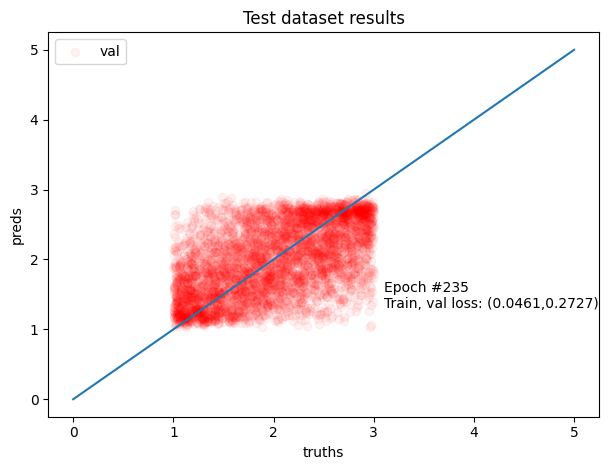

Epoch 236/300 - Train loss:	 0.0477
Epoch 236/300 - Validation MSE:	 0.2698



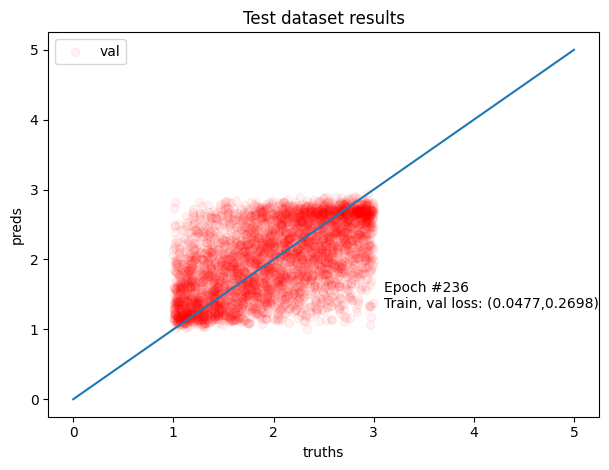

Epoch 237/300 - Train loss:	 0.0448
Epoch 237/300 - Validation MSE:	 0.2722



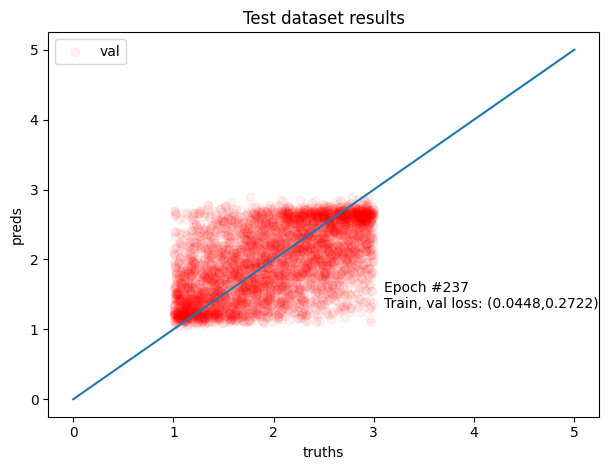

Epoch 238/300 - Train loss:	 0.0480
Epoch 238/300 - Validation MSE:	 0.2645



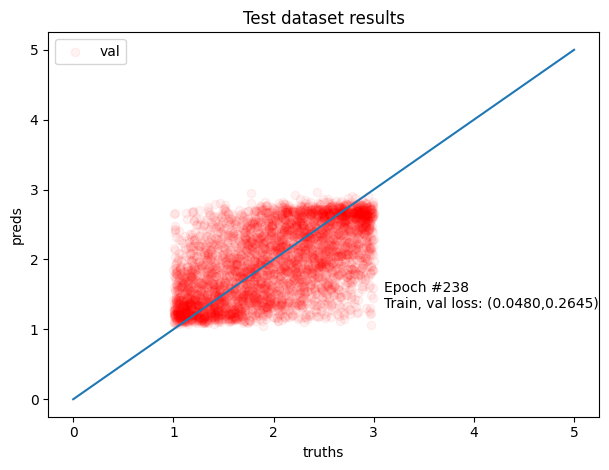

Epoch 239/300 - Train loss:	 0.0463
Epoch 239/300 - Validation MSE:	 0.2713



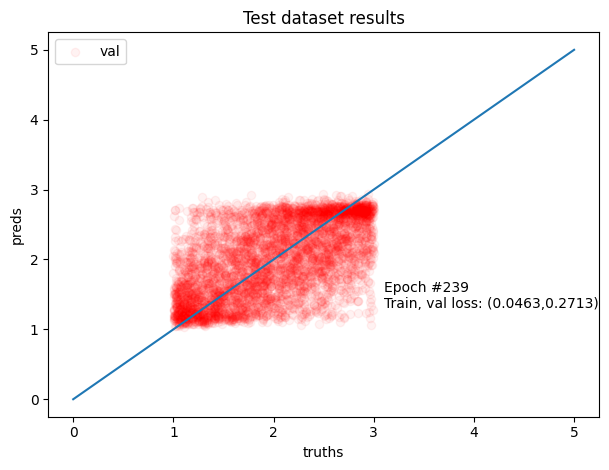

Epoch 240/300 - Train loss:	 0.0436
Epoch 240/300 - Validation MSE:	 0.2741



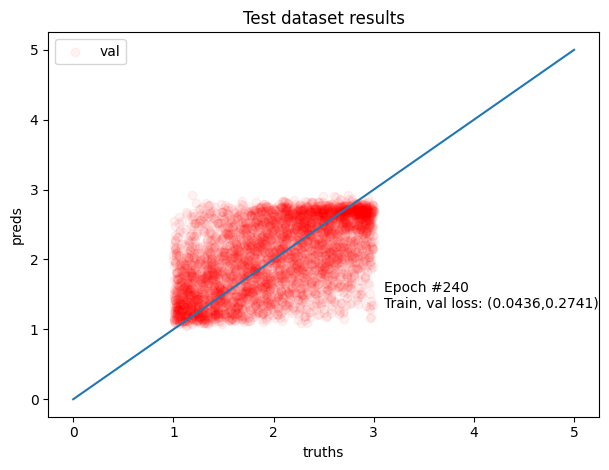

Epoch 241/300 - Train loss:	 0.0427
Epoch 241/300 - Validation MSE:	 0.2625



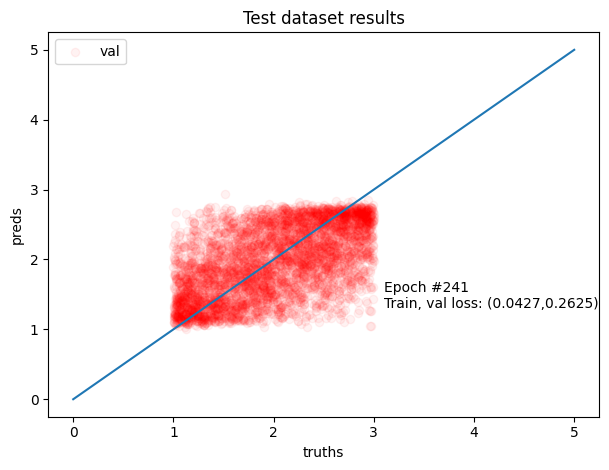

Epoch 242/300 - Train loss:	 0.0457
Epoch 242/300 - Validation MSE:	 0.2639



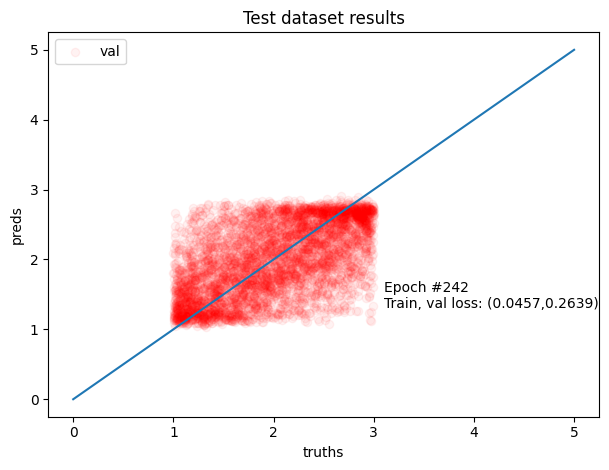

Epoch 243/300 - Train loss:	 0.0437
Epoch 243/300 - Validation MSE:	 0.2617



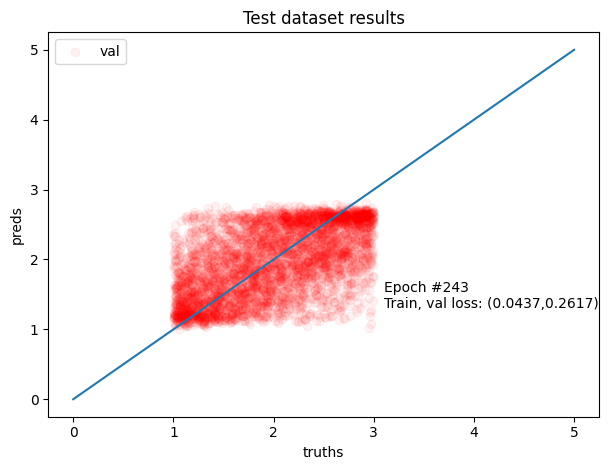

Epoch 244/300 - Train loss:	 0.0453
Epoch 244/300 - Validation MSE:	 0.2717



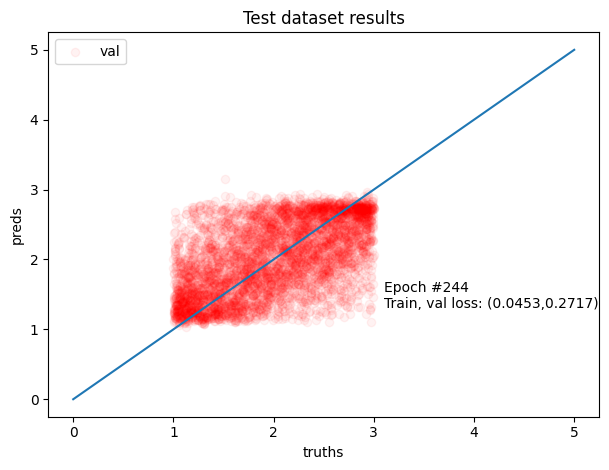

Epoch 245/300 - Train loss:	 0.0436
Epoch 245/300 - Validation MSE:	 0.2717



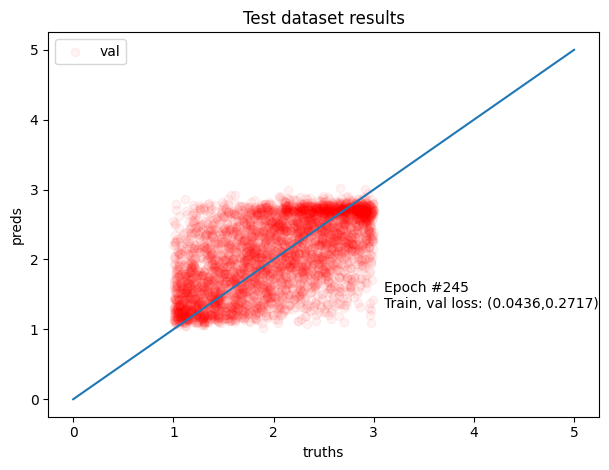

Epoch 246/300 - Train loss:	 0.0413
Epoch 246/300 - Validation MSE:	 0.2710



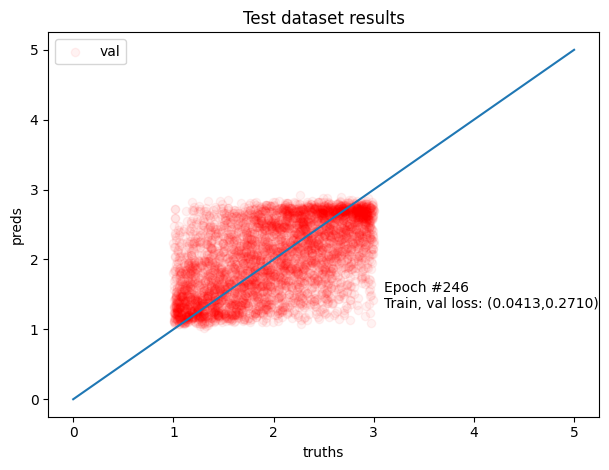

Epoch 247/300 - Train loss:	 0.0438
Epoch 247/300 - Validation MSE:	 0.2676



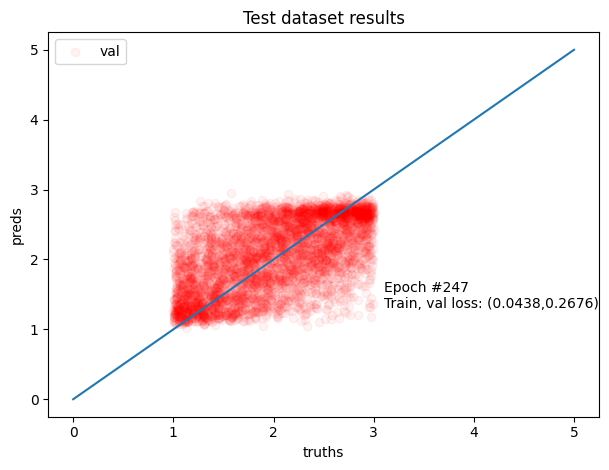

Epoch 248/300 - Train loss:	 0.0425
Epoch 248/300 - Validation MSE:	 0.2774



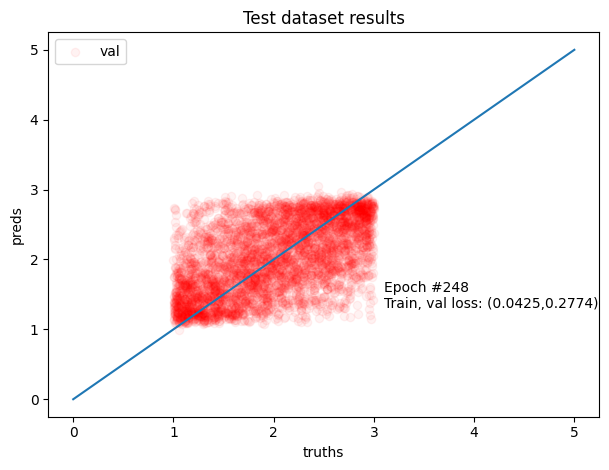

Epoch 249/300 - Train loss:	 0.0436
Epoch 249/300 - Validation MSE:	 0.2746



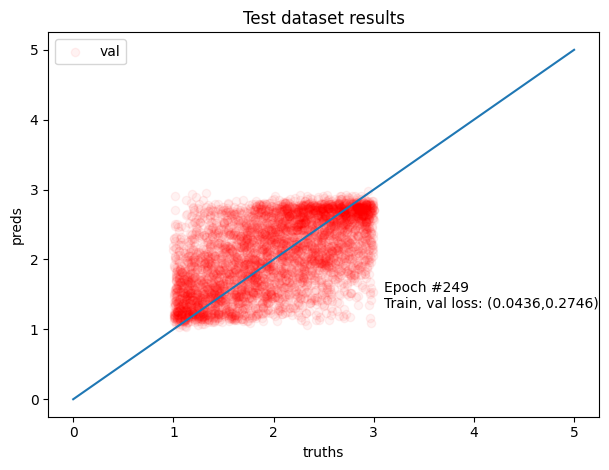

Epoch 250/300 - Train loss:	 0.0441
Epoch 250/300 - Validation MSE:	 0.2687



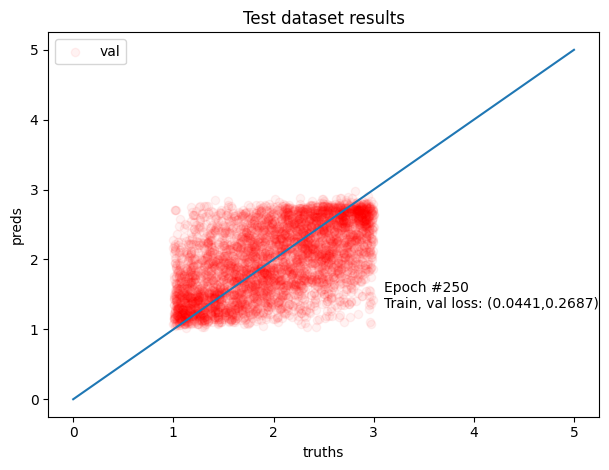

Epoch 251/300 - Train loss:	 0.0414
Epoch 251/300 - Validation MSE:	 0.2684



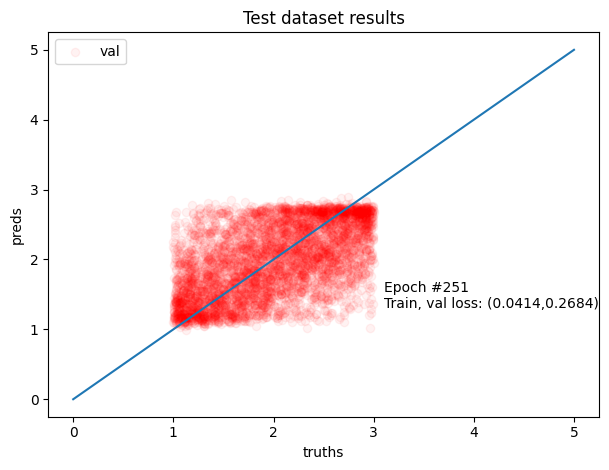

Epoch 252/300 - Train loss:	 0.0416
Epoch 252/300 - Validation MSE:	 0.2811



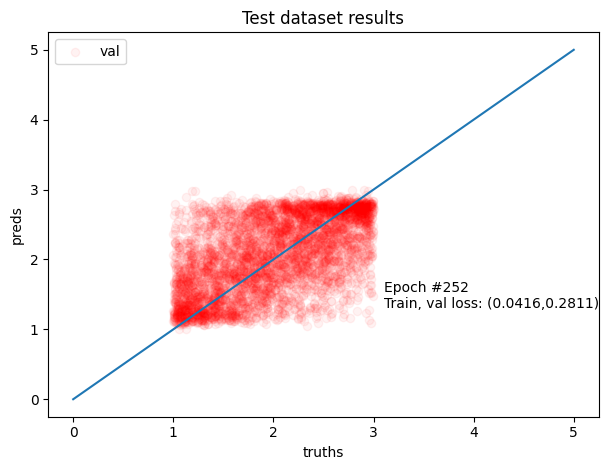

Epoch 253/300 - Train loss:	 0.0405
Epoch 253/300 - Validation MSE:	 0.2685



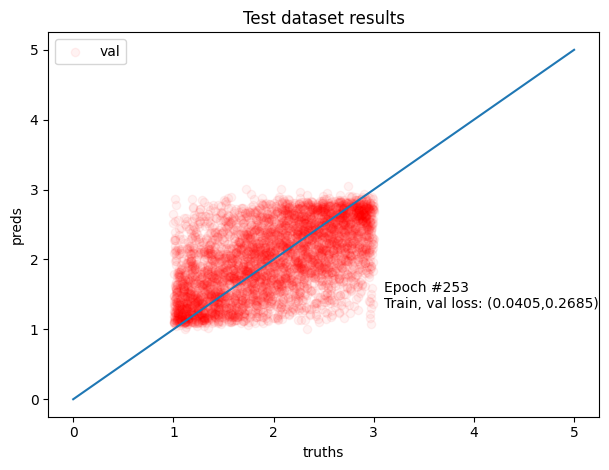

Epoch 254/300 - Train loss:	 0.0408
Epoch 254/300 - Validation MSE:	 0.2738



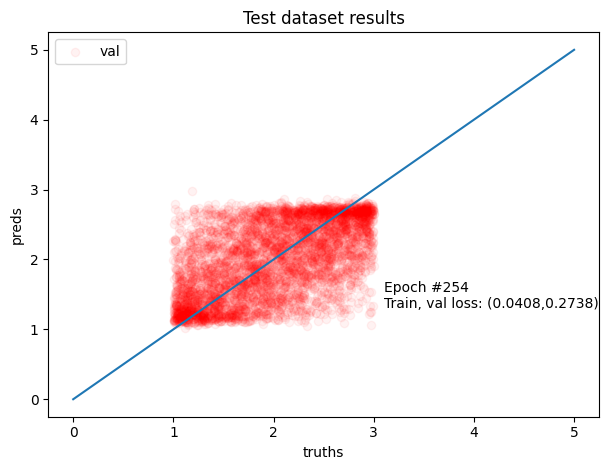

Epoch 255/300 - Train loss:	 0.0415
Epoch 255/300 - Validation MSE:	 0.2662



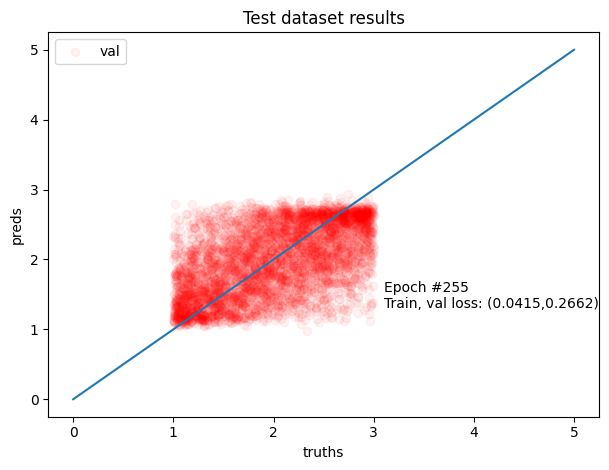

Epoch 256/300 - Train loss:	 0.0411
Epoch 256/300 - Validation MSE:	 0.2838



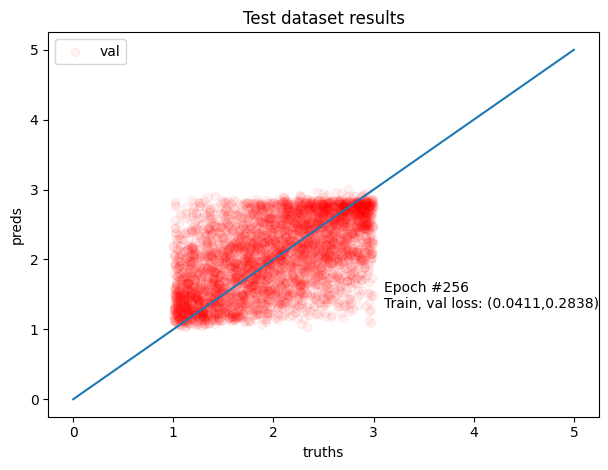

Epoch 257/300 - Train loss:	 0.0378
Epoch 257/300 - Validation MSE:	 0.2760



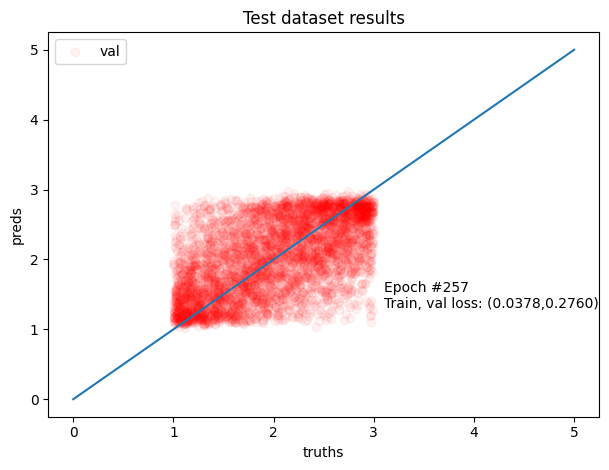

Epoch 258/300 - Train loss:	 0.0406
Epoch 258/300 - Validation MSE:	 0.2650



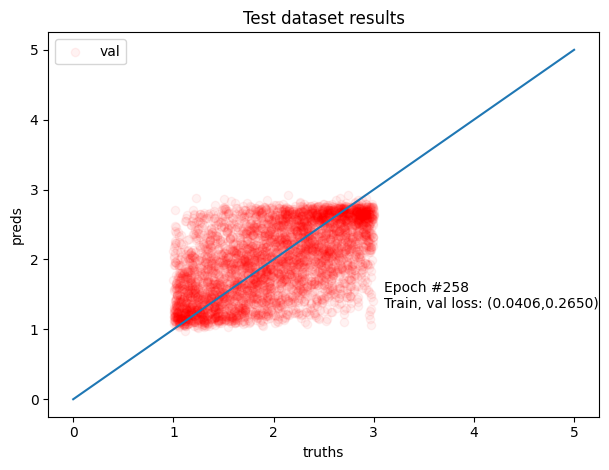

Epoch 259/300 - Train loss:	 0.0411
Epoch 259/300 - Validation MSE:	 0.2673



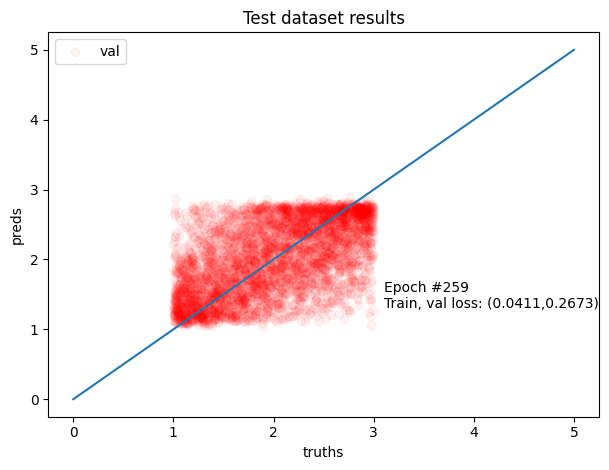

Epoch 260/300 - Train loss:	 0.0372
Epoch 260/300 - Validation MSE:	 0.2729



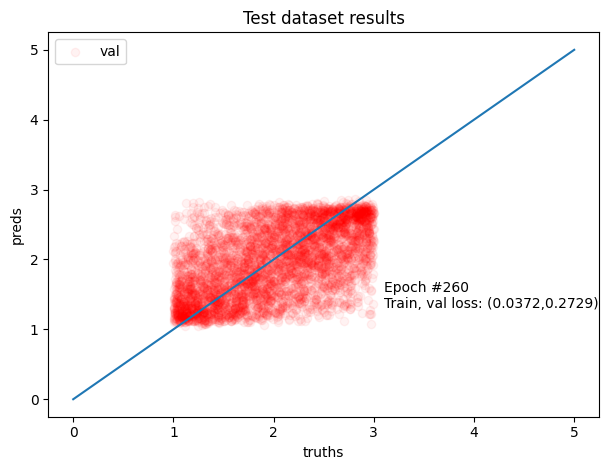

Epoch 261/300 - Train loss:	 0.0413
Epoch 261/300 - Validation MSE:	 0.2718



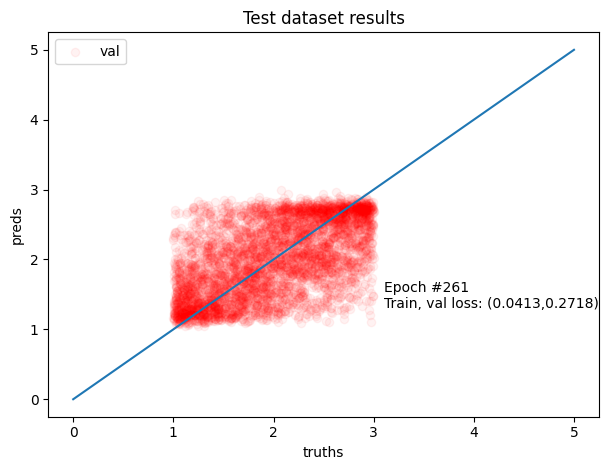

Epoch 262/300 - Train loss:	 0.0394
Epoch 262/300 - Validation MSE:	 0.2688



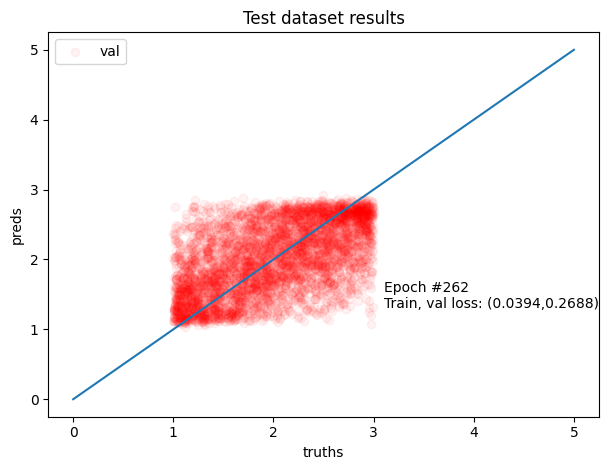

Epoch 263/300 - Train loss:	 0.0421
Epoch 263/300 - Validation MSE:	 0.2744



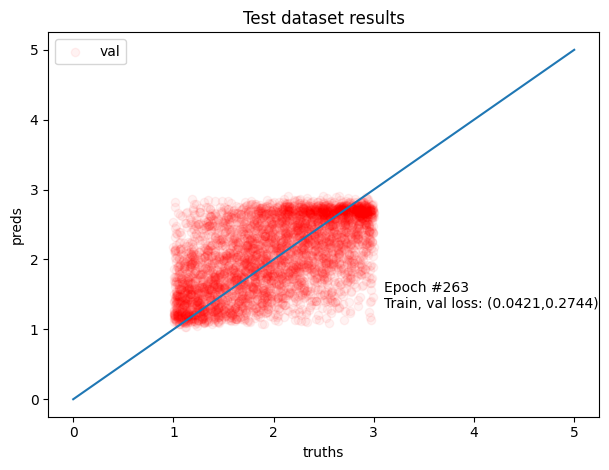

Epoch 264/300 - Train loss:	 0.0380
Epoch 264/300 - Validation MSE:	 0.2727



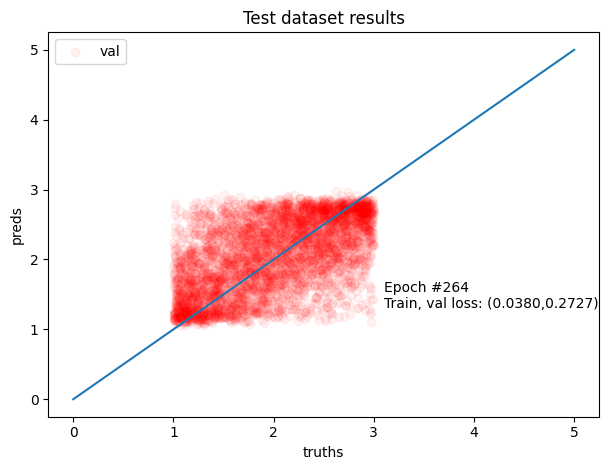

Epoch 265/300 - Train loss:	 0.0366
Epoch 265/300 - Validation MSE:	 0.2763



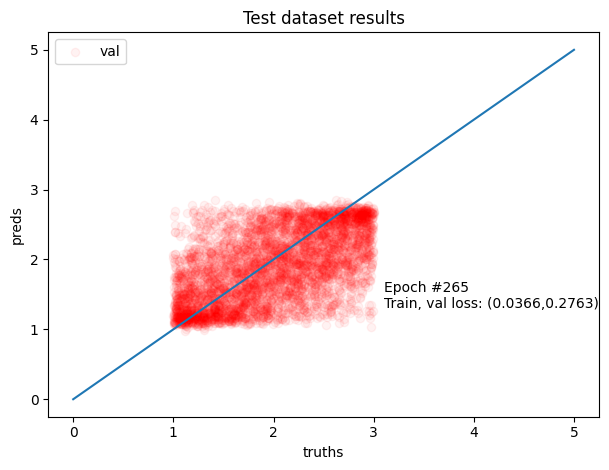

Epoch 266/300 - Train loss:	 0.0414
Epoch 266/300 - Validation MSE:	 0.2751



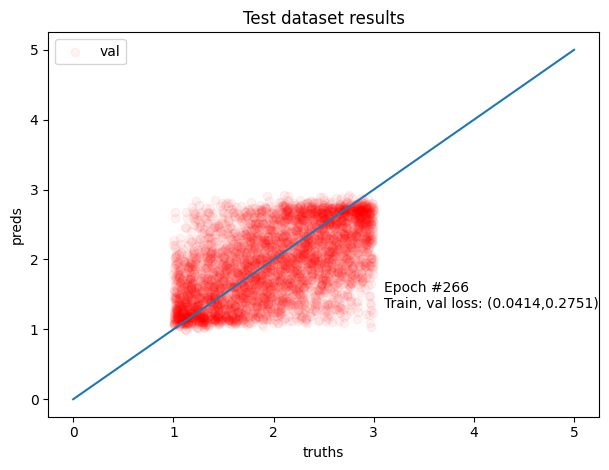

Epoch 267/300 - Train loss:	 0.0384
Epoch 267/300 - Validation MSE:	 0.2658



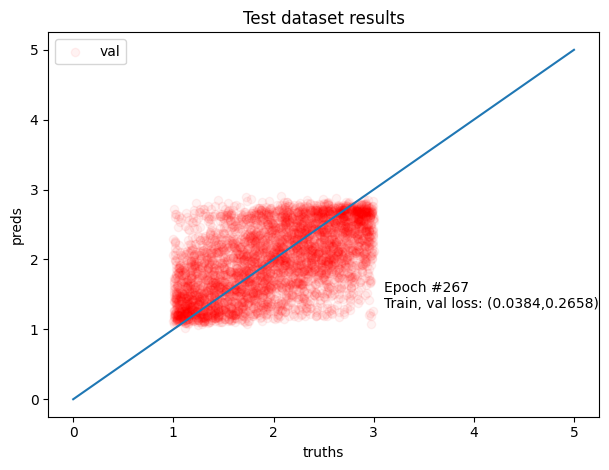

Epoch 268/300 - Train loss:	 0.0365
Epoch 268/300 - Validation MSE:	 0.2778



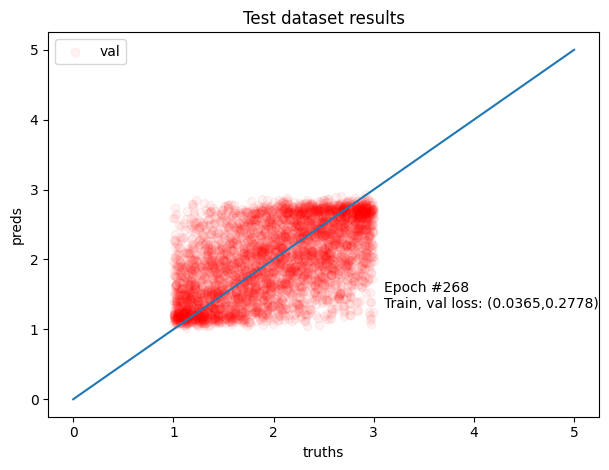

Epoch 269/300 - Train loss:	 0.0370
Epoch 269/300 - Validation MSE:	 0.2596



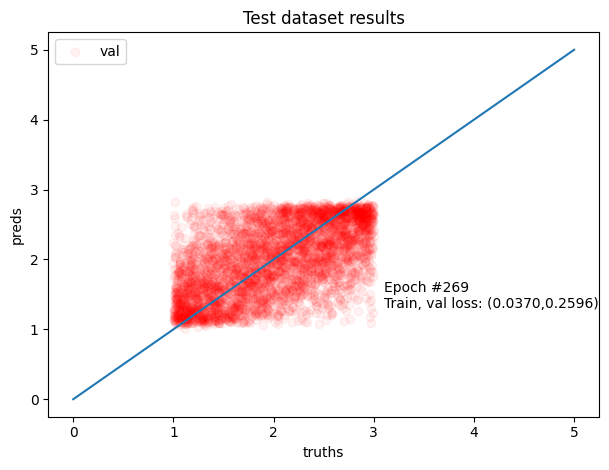

Epoch 270/300 - Train loss:	 0.0399
Epoch 270/300 - Validation MSE:	 0.2679



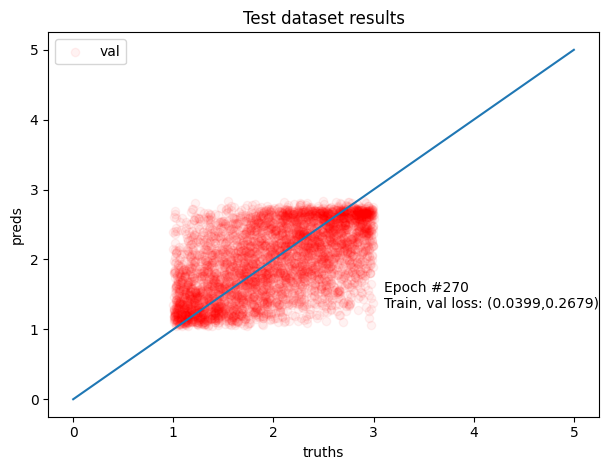

Epoch 271/300 - Train loss:	 0.0341
Epoch 271/300 - Validation MSE:	 0.2743



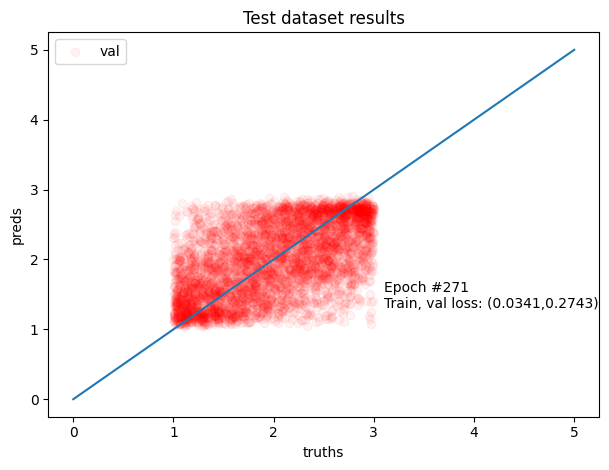

Epoch 272/300 - Train loss:	 0.0357
Epoch 272/300 - Validation MSE:	 0.2685



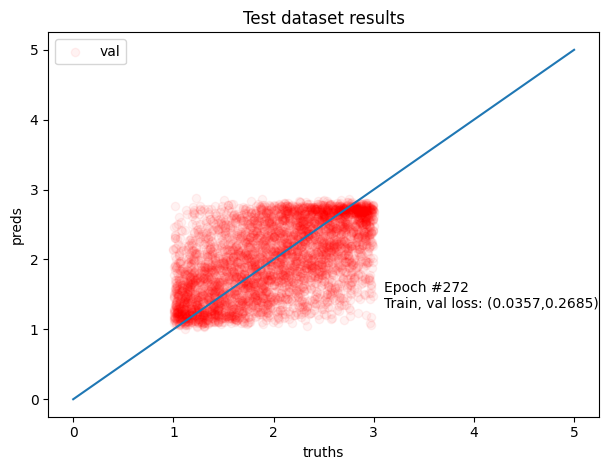

Epoch 273/300 - Train loss:	 0.0355
Epoch 273/300 - Validation MSE:	 0.2692



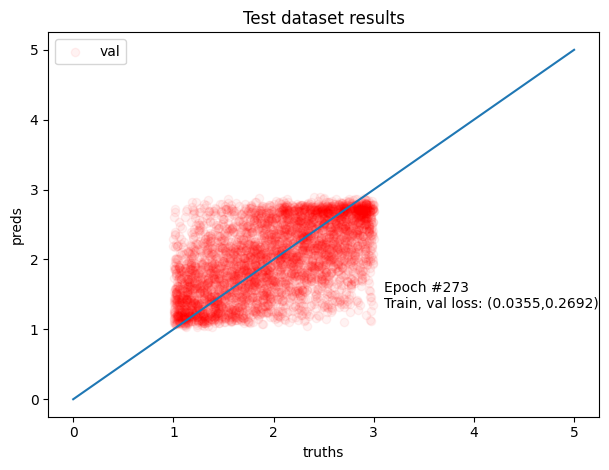

Epoch 274/300 - Train loss:	 0.0362
Epoch 274/300 - Validation MSE:	 0.2776



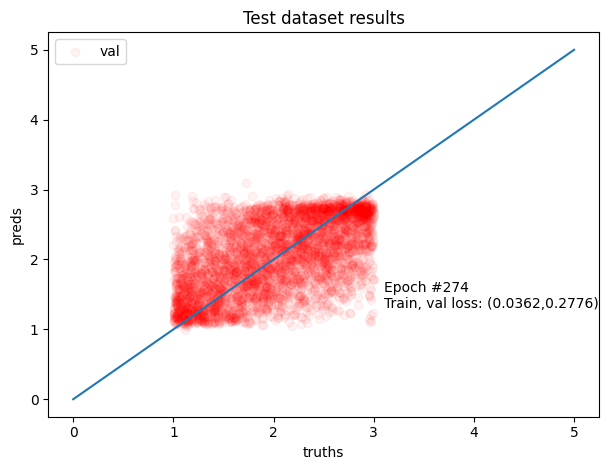

Epoch 275/300 - Train loss:	 0.0371
Epoch 275/300 - Validation MSE:	 0.2683



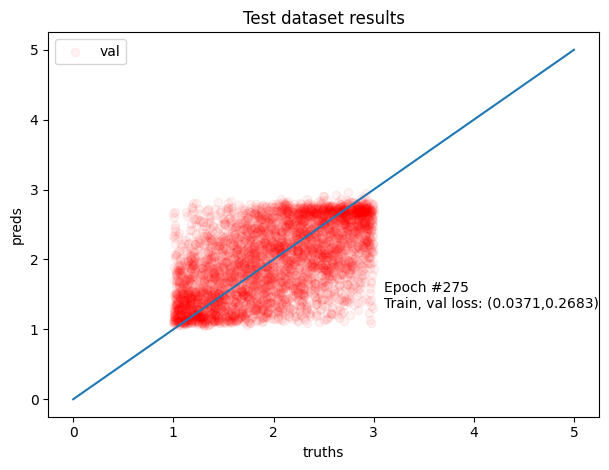

Epoch 276/300 - Train loss:	 0.0380
Epoch 276/300 - Validation MSE:	 0.2634



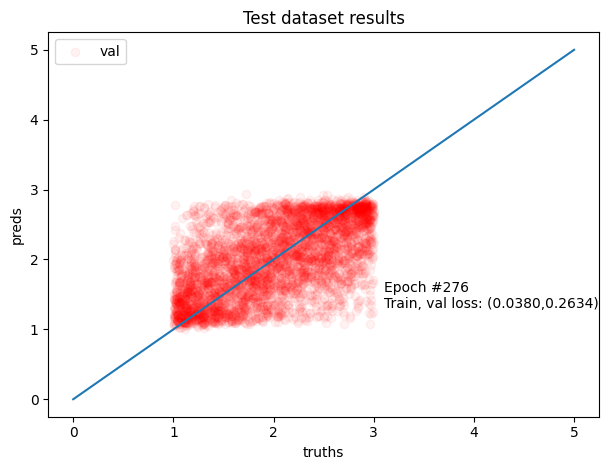

Epoch 277/300 - Train loss:	 0.0353
Epoch 277/300 - Validation MSE:	 0.2720



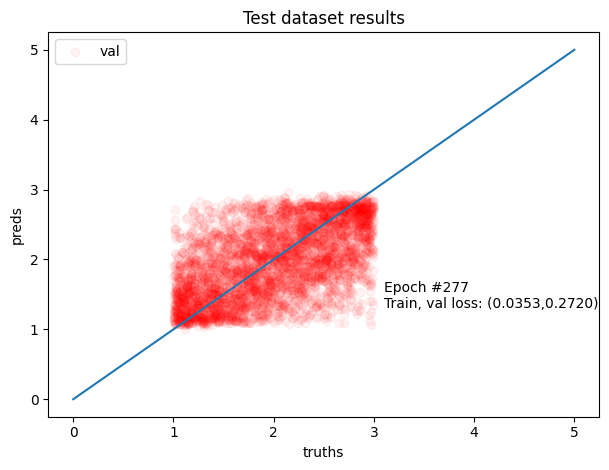

Epoch 278/300 - Train loss:	 0.0335
Epoch 278/300 - Validation MSE:	 0.2739



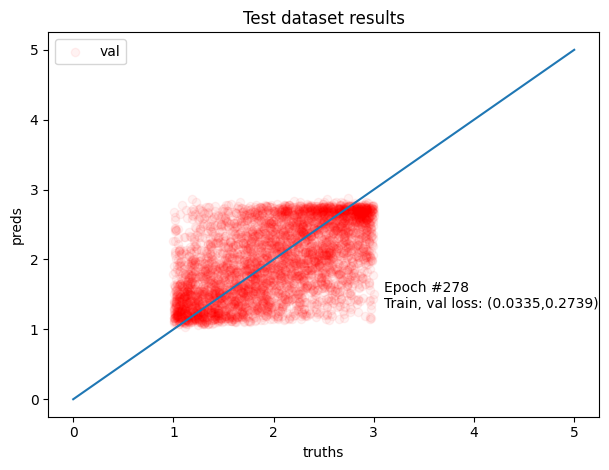

Epoch 279/300 - Train loss:	 0.0371
Epoch 279/300 - Validation MSE:	 0.2715



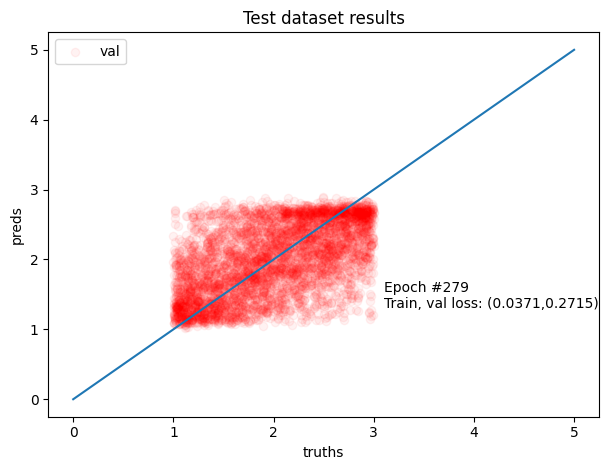

Epoch 280/300 - Train loss:	 0.0346
Epoch 280/300 - Validation MSE:	 0.2670



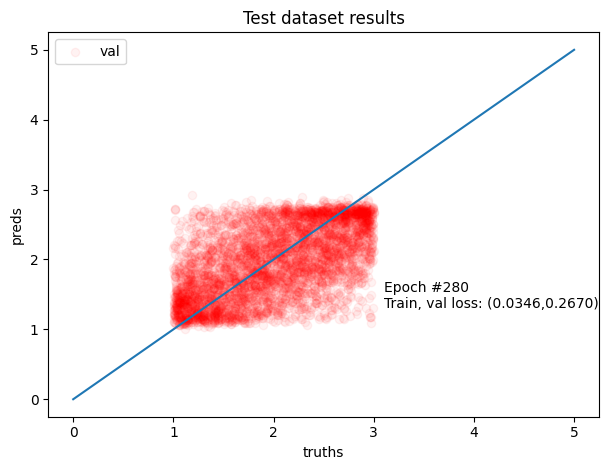

Epoch 281/300 - Train loss:	 0.0347
Epoch 281/300 - Validation MSE:	 0.2731



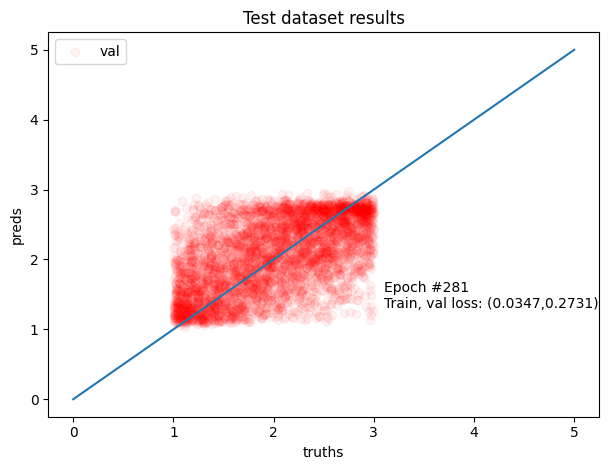

Epoch 282/300 - Train loss:	 0.0357
Epoch 282/300 - Validation MSE:	 0.2842



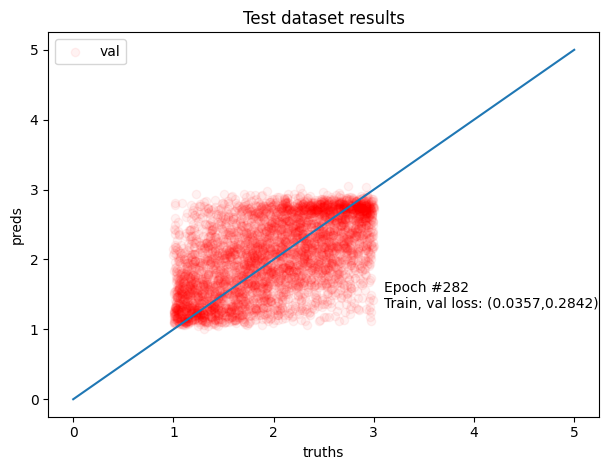

Epoch 283/300 - Train loss:	 0.0345
Epoch 283/300 - Validation MSE:	 0.2727



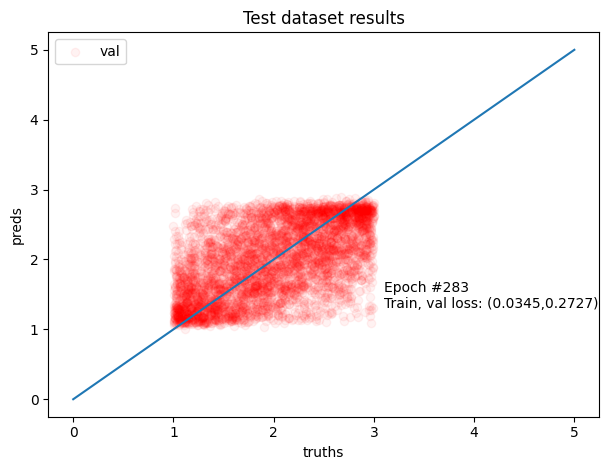

Epoch 284/300 - Train loss:	 0.0343
Epoch 284/300 - Validation MSE:	 0.2601



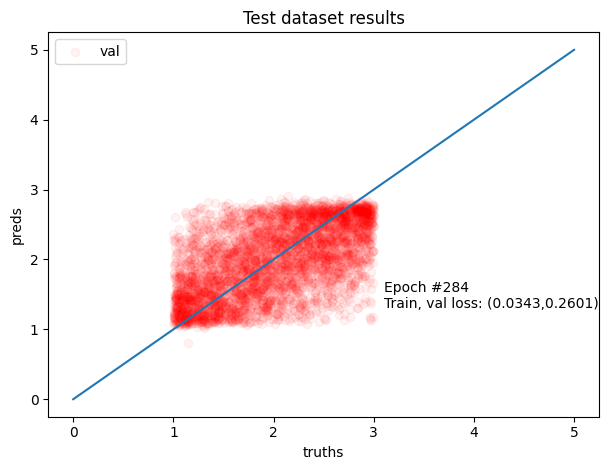

Epoch 285/300 - Train loss:	 0.0357
Epoch 285/300 - Validation MSE:	 0.2667



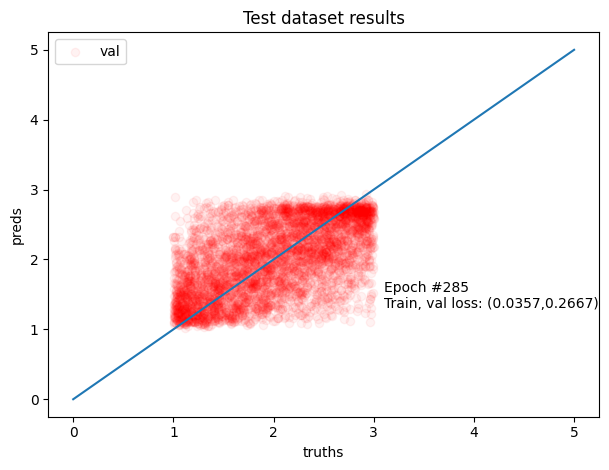

Epoch 286/300 - Train loss:	 0.0333
Epoch 286/300 - Validation MSE:	 0.2702



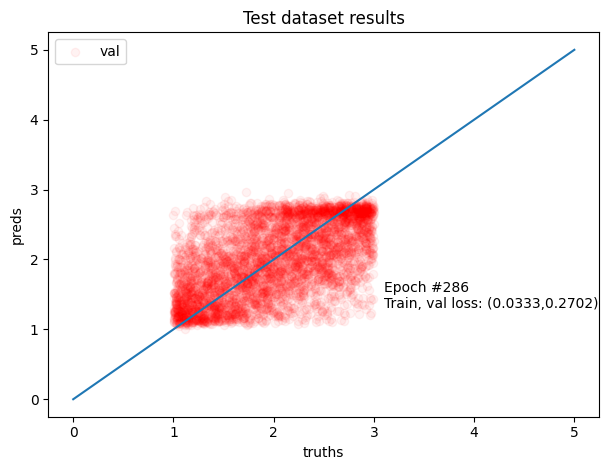

Epoch 287/300 - Train loss:	 0.0356
Epoch 287/300 - Validation MSE:	 0.2666



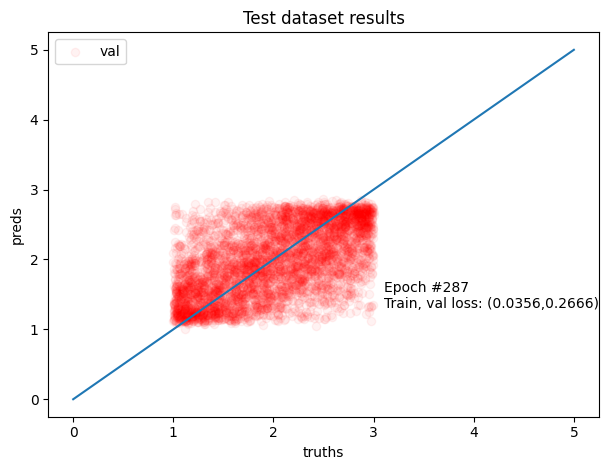

Epoch 288/300 - Train loss:	 0.0315
Epoch 288/300 - Validation MSE:	 0.2722



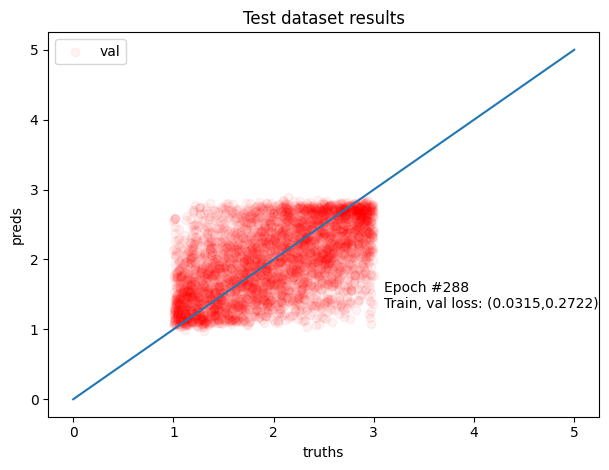

Epoch 289/300 - Train loss:	 0.0326
Epoch 289/300 - Validation MSE:	 0.2762



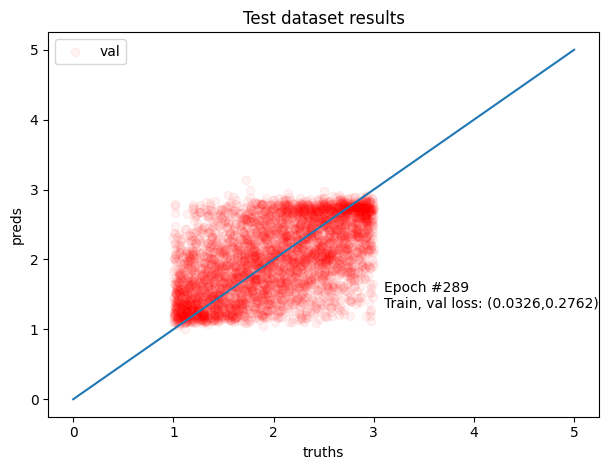

Epoch 290/300 - Train loss:	 0.0383
Epoch 290/300 - Validation MSE:	 0.2780



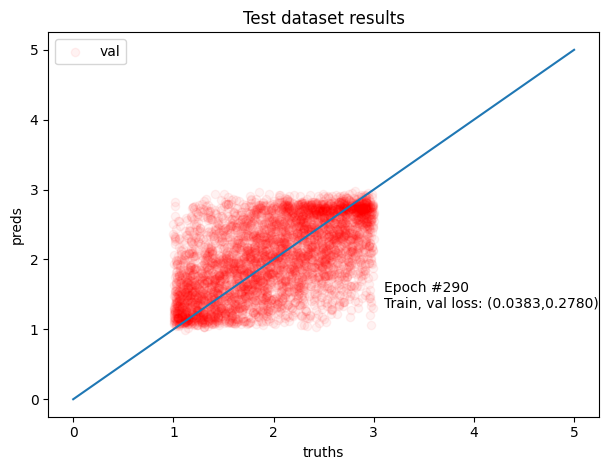

Epoch 291/300 - Train loss:	 0.0342
Epoch 291/300 - Validation MSE:	 0.2695



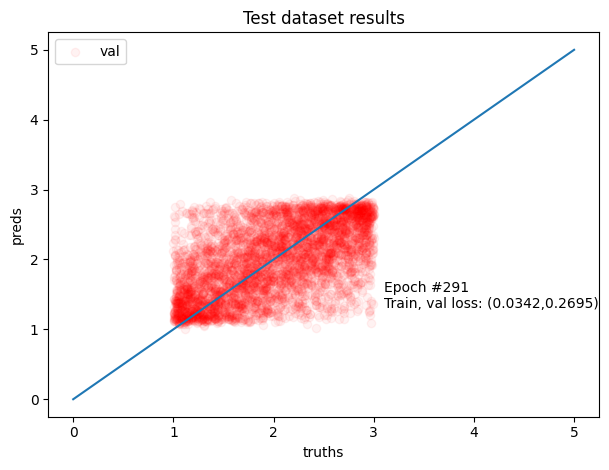

Epoch 292/300 - Train loss:	 0.0320
Epoch 292/300 - Validation MSE:	 0.2838



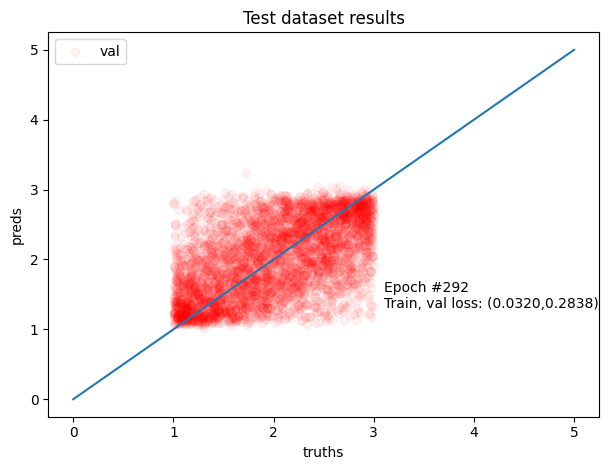

Epoch 293/300 - Train loss:	 0.0321
Epoch 293/300 - Validation MSE:	 0.2688



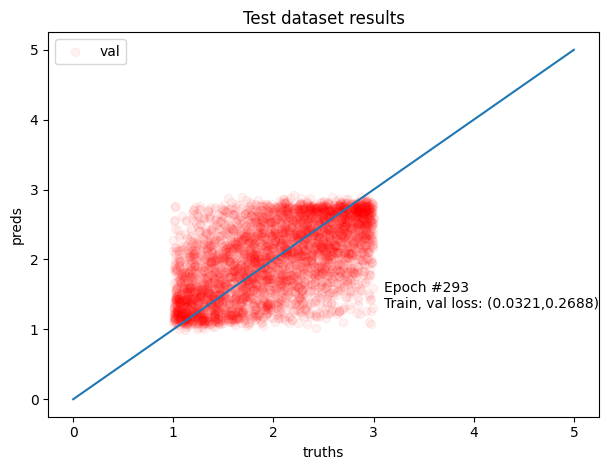

Epoch 294/300 - Train loss:	 0.0334
Epoch 294/300 - Validation MSE:	 0.2714



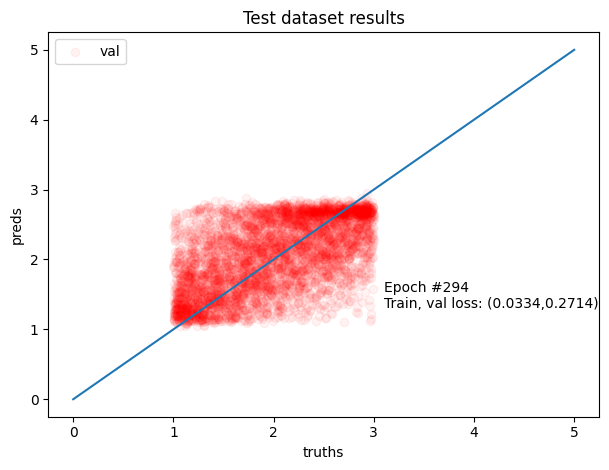

Epoch 295/300 - Train loss:	 0.0352
Epoch 295/300 - Validation MSE:	 0.2723



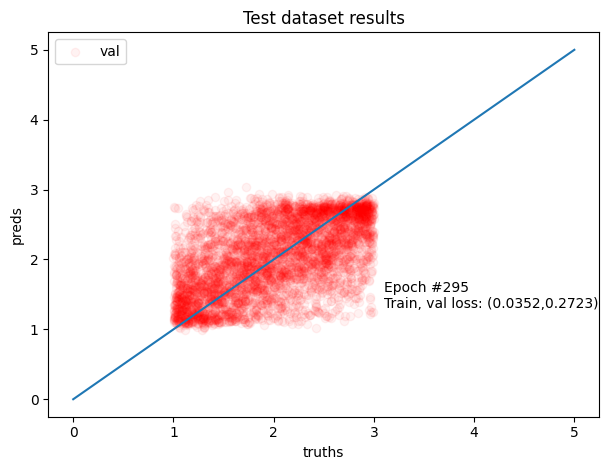

Epoch 296/300 - Train loss:	 0.0320
Epoch 296/300 - Validation MSE:	 0.2740



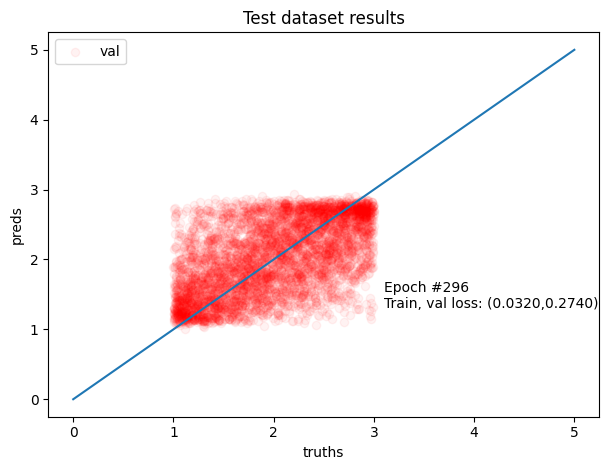

Epoch 297/300 - Train loss:	 0.0302
Epoch 297/300 - Validation MSE:	 0.2708



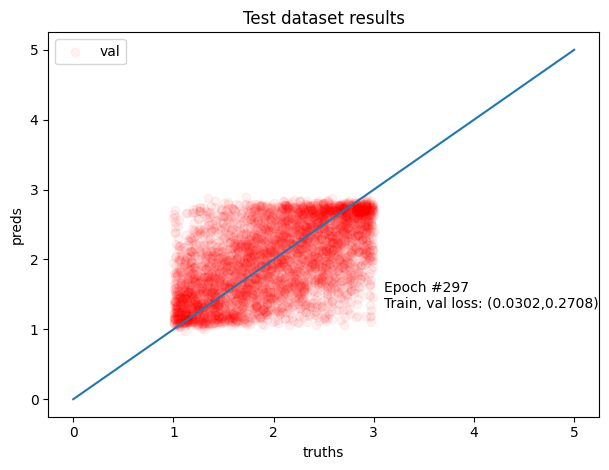

Epoch 298/300 - Train loss:	 0.0326
Epoch 298/300 - Validation MSE:	 0.2660



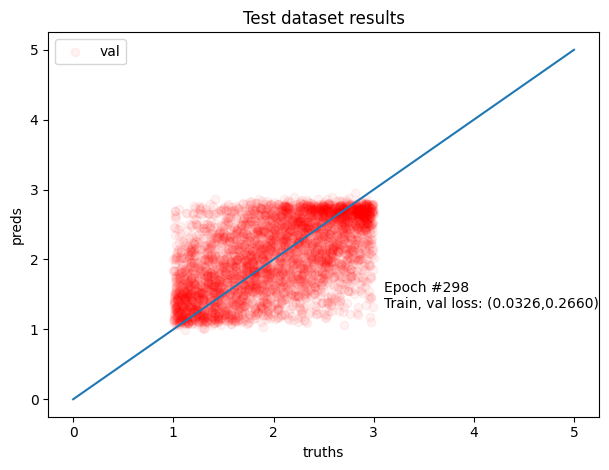

Epoch 299/300 - Train loss:	 0.0339
Epoch 299/300 - Validation MSE:	 0.2725



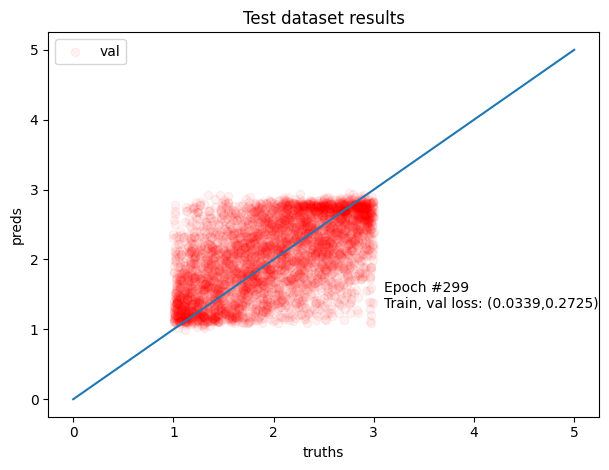

Epoch 300/300 - Train loss:	 0.0332
Epoch 300/300 - Validation MSE:	 0.2651



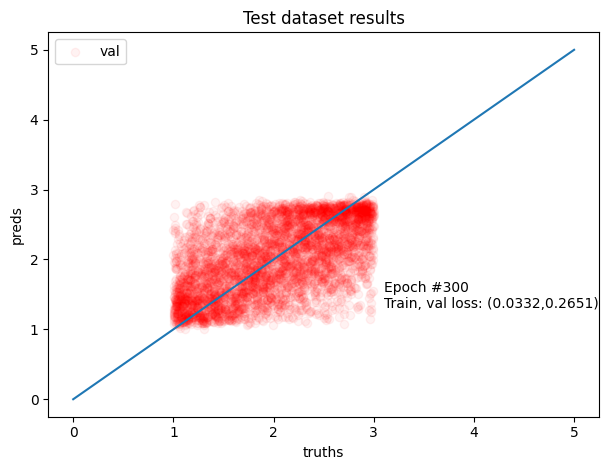

In [30]:
n_epochs = 300
early_stopping_limit = 500
trained_model, train_losses, val_losses, optimizer = train_GNN(model,optimizer,criterion, train_dataloader, val_dataloader, n_epochs, early_stopping_limit)

In [22]:
import imageio
images = []
for file_idx in range(63):
    images.append(imageio.imread(f"plots/training_gif_4/frame{file_idx * 10}.jpeg"))
imageio.mimsave('plots/GNN/training_gif_small_capacity_high_lr.gif', images)

/tmp/ipykernel_1508174/2709621554.py:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(f"plots/training_gif_4/frame{file_idx * 10}.jpeg"))


## **Plot training and val loss on log scale**

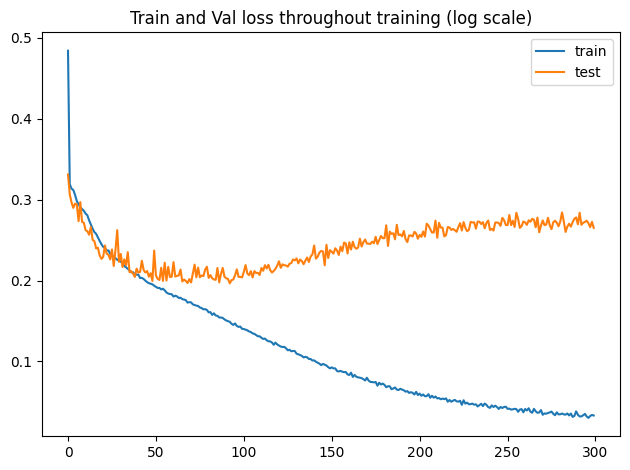

In [31]:
plot.plot(train_losses,label = "train")
plot.title("Train and Val loss throughout training (log scale)")
plot.plot(val_losses, label = "test")
# plot.yscale("log")
plot.legend()
plot.tight_layout()

## **Evaluate model on test dataset**

Now we can check the RMSE and across the whole test dataset and visualize the result

MSE: 0.2753536105155945


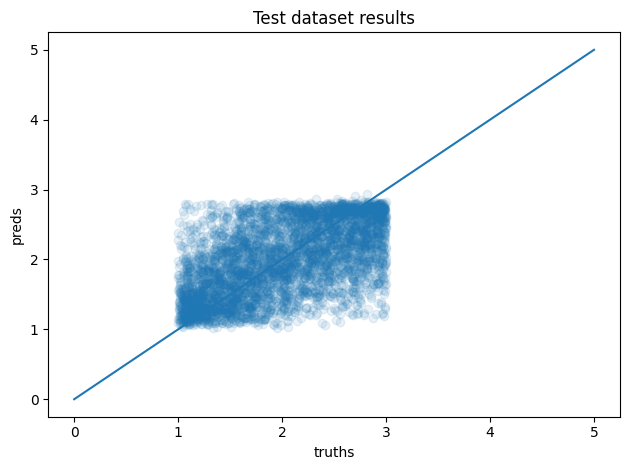

In [33]:
test_truths, test_preds = test_GNN(trained_model, test_dataloader)

plot.plot([0,5],[0,5])
plot.title("Test dataset results")
plot.scatter(test_truths,test_preds,alpha = 0.1)
plot.xlabel("truths")
plot.ylabel("preds")
plot.tight_layout()

# Binned RMSE

In [77]:
rmse_per_bin = calculate_bin_rmse(test_dataloader, model)

In [78]:
bin_centers = np.array(list(rmse_per_bin.keys()))
rmse = np.array(list(rmse_per_bin.values()))
rel_rmse = rmse / bin_centers

In [79]:
def func(x, A):
    return A / np.sqrt(x)
from scipy.optimize import curve_fit

params, cov = curve_fit(func, bin_centers, rel_rmse)
x_fit = np.linspace(1, 3, 100)
y_fit = func(x_fit, params)

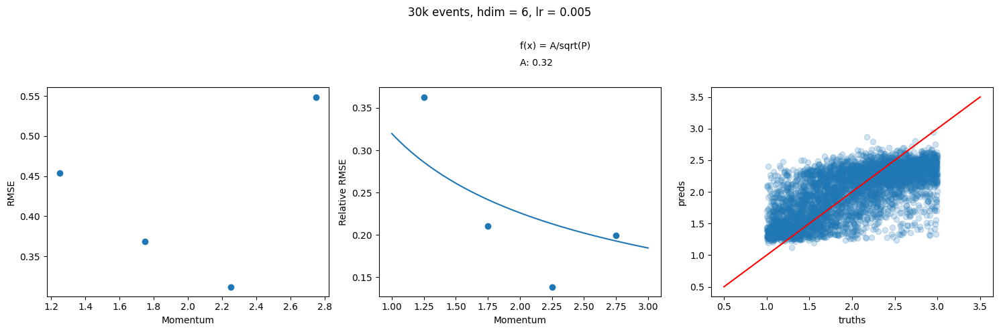

In [80]:
fig,axs = plot.subplots(1,3,figsize = (15,5))
fig.suptitle("30k events, hdim = 6, lr = 0.005")
axs[0].scatter(rmse_per_bin.keys(),rmse_per_bin.values())
axs[0].set(xlabel="Momentum",ylabel = "RMSE")
axs[1].scatter(rmse_per_bin.keys(),np.array(list(rmse_per_bin.values())) / np.array(list(rmse_per_bin.keys())))
axs[1].plot(x_fit,y_fit)
axs[1].set(xlabel="Momentum",ylabel = "Relative RMSE")
axs[1].text(2,0.4,f"A: {params[0]:.2f}")
axs[1].text(2,0.42,f"f(x) = A/sqrt(P)")
axs[2].scatter(test_truths,test_preds,alpha = 0.2)
axs[2].plot([0.5,3.5],[0.5,3.5],color = "red")
axs[2].set(xlabel = "truths",ylabel = "preds")
fig.tight_layout()
# plot.savefig(f"plots/GNN/run_{run_num}_RMSE_30kevents_hdim6_lr0_0005_GIN_geometry_2.pdf")